<a href="https://colab.research.google.com/github/andressriosg/Modeling-of-atmospheric-particle-pollution-in-Bogota/blob/main/Notebooks/predicciones.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#
from __future__ import absolute_import, division, print_function, unicode_literals

import tensorflow as tf

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
#%matplotlib inline
from sklearn.preprocessing import MinMaxScaler

#setting figure size
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 20,10

#importing required libraries
from sklearn.preprocessing import MinMaxScaler

# importa objetos de keras
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Dropout, LSTM
print("Versión de Tensorflow: ", tf.__version__)

# optimizador
from tensorflow.keras.optimizers import Adam

Versión de Tensorflow:  2.5.0


In [ ]:
# Funciones auxiliares
#
def plot_prediction(real, prediccion):
    plt.plot(real,color='red', label='Valor real de la acción')
    plt.plot(prediccion, color='blue', label='Predicción de la acción')
    plt.ylim(1.1 * np.min(prediccion)/2, 1.1 * np.max(prediccion))
    plt.xlabel('Tiempo')
    plt.ylabel('Valor de la acción')
    plt.legend()
    plt.show()

#

In [ ]:
from google.colab import files # Para cargar archivos en google colab 
uploaded = files.upload()

Saving PanelFiltrado.csv to PanelFiltrado (1).csv


In [ ]:
import io
df2 = pd.read_csv(io.BytesIO(uploaded['PanelFiltrado.csv']), delimiter= ",", error_bad_lines=False, header=0, decimal=",")
df2.head()

,Fecha,Fuente,Estación,EstaciónID,Año,Mes,Día,Hora,Unidad,PM10,PM2.5
0,2015-01-01 01:00:00,RMCAB,Bolivia,1,2015,1,1,1,mg/m3,NaN,NaN
1,2015-01-01 02:00:00,RMCAB,Bolivia,1,2015,1,1,2,mg/m3,NaN,NaN
2,2015-01-01 03:00:00,RMCAB,Bolivia,1,2015,1,1,3,mg/m3,NaN,NaN
3,2015-01-01 04:00:00,RMCAB,Bolivia,1,2015,1,1,4,mg/m3,NaN,NaN
4,2015-01-01 05:00:00,RMCAB,Bolivia,1,2015,1,1,5,mg/m3,NaN,NaN


In [ ]:
df2

,Fecha,Fuente,Estación,EstaciónID,Año,Mes,Día,Hora,Unidad,PM10,PM2.5
0,2015-01-01 01:00:00,RMCAB,Bolivia,1,2015,1,1,1,mg/m3,NaN,NaN
1,2015-01-01 02:00:00,RMCAB,Bolivia,1,2015,1,1,2,mg/m3,NaN,NaN
2,2015-01-01 03:00:00,RMCAB,Bolivia,1,2015,1,1,3,mg/m3,NaN,NaN
3,2015-01-01 04:00:00,RMCAB,Bolivia,1,2015,1,1,4,mg/m3,NaN,NaN
4,2015-01-01 05:00:00,RMCAB,Bolivia,1,2015,1,1,5,mg/m3,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
989131,2021-04-08 12:00:00,RMCAB,Usme,18,2021,4,8,12,mg/m3,NaN,3.4
989132,2021-04-08 13:00:00,RMCAB,Usme,18,2021,4,8,13,mg/m3,NaN,7.6
989133,2021-04-08 14:00:00,RMCAB,Usme,18,2021,4,8,14,mg/m3,NaN,6.5
989134,2021-04-08 15:00:00,RMCAB,Usme,18,2021,4,8,15,mg/m3,NaN,5.4


In [ ]:
df2.index=pd.to_datetime(df2["Fecha"])

In [ ]:
df2["Estación"].value_counts() # Número de datos incluidos NaN por cada estación 

Fontibón                      54952
San Cristóbal                 54952
Usaquén                       54952
Bolivia                       54952
Carvajal-Sevillana            54952
Bosa                          54952
Colina                        54952
Ciudad Bolívar                54952
Suba                          54952
Usme                          54952
Kennedy                       54952
Puente Aranda                 54952
Guaymaral                     54952
Centro de Alto Rendimiento    54952
Móvil Fontibón                54952
Tunal                         54952
Ministerio de Ambiente        54952
Las Ferias                    54952
Name: Estación, dtype: int64

In [ ]:
df2["Estación"].isna()

Fecha
2015-01-01 01:00:00    False
2015-01-01 02:00:00    False
2015-01-01 03:00:00    False
2015-01-01 04:00:00    False
2015-01-01 05:00:00    False
                       ...  
2021-04-08 12:00:00    False
2021-04-08 13:00:00    False
2021-04-08 14:00:00    False
2021-04-08 15:00:00    False
2021-04-08 16:00:00    False
Name: Estación, Length: 989136, dtype: bool

In [ ]:
def Estacion(s,a,b):
    ESTACION=df2[df2["Estación"]==s]
    ESTACION=ESTACION[["PM10","PM2.5","Fecha"]]
    ESTACION[["PM10","PM2.5"]]=ESTACION[["PM10","PM2.5"]].astype("float")
    ESTACION=ESTACION.loc[a:b]
    print(len(ESTACION))
    #TUNALAÑO2019MARZOSEMANA1=Tunal.loc['2019-03-04 00:00:00':'2019-03-10 23:00:00']
    #TUNALAÑO2019MARZOSEMANA1.plot(title="Concentración de PM10 y P.25 en Tunal- Mes Marzo de 2019",figsize=(15,4))
    ESTACION.plot(title="Concentración de PM10 y P.25 en {}- entre {} y {}".format(s,a,b),figsize=(20,4))
    return ESTACION
 

2


,PM10,PM2.5,Fecha
Fecha,,,
2021-04-08 12:00:00,NaN,3.4,2021-04-08 12:00:00
2021-04-08 13:00:00,NaN,7.6,2021-04-08 13:00:00


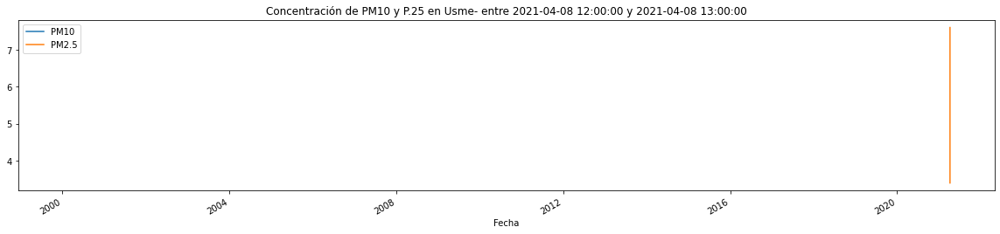

In [ ]:
Estacion(s= "Usme", a= "2021-04-08 12:00:00", b = "2021-04-08 13:00:00") # Con esta función escogemos la estación en un determinado tiempo 

In [ ]:
def SelectPM(s,a,b,PM):
    SelectEstacion=Estacion(s,a,b)
    SelectEstacionPM= pd.DataFrame(SelectEstacion[[PM]])
    SelectEstacionPM=SelectEstacionPM.interpolate(method ='linear', limit_direction ='forward')
    print(len(SelectEstacionPM))
    # plot
    plt.figure(figsize=(16,8))
    plt.plot(SelectEstacionPM[:int(len(SelectEstacionPM)*80/100)], label="Conjunto de entrenamiento (Training set): {} puntos (80%)".format(int(len(SelectEstacionPM)*80/100)))
    plt.plot(SelectEstacionPM[int(len(SelectEstacionPM)*80/100):], label='Conjunto de Validación (Validation set): {} puntos (20%)'.format(int(len(SelectEstacionPM)-len(SelectEstacionPM)*80/100)))#248 data
    plt.title("Concentración de {} en {} entre {} y {}".format(PM,s,a,b), size=(20))
    plt.legend()
    plt.show()
    return SelectEstacionPM

2
2


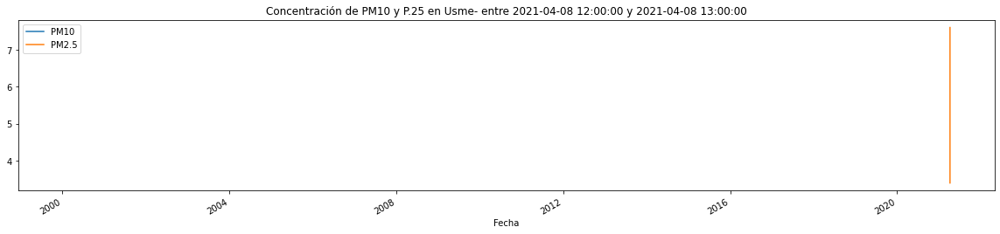

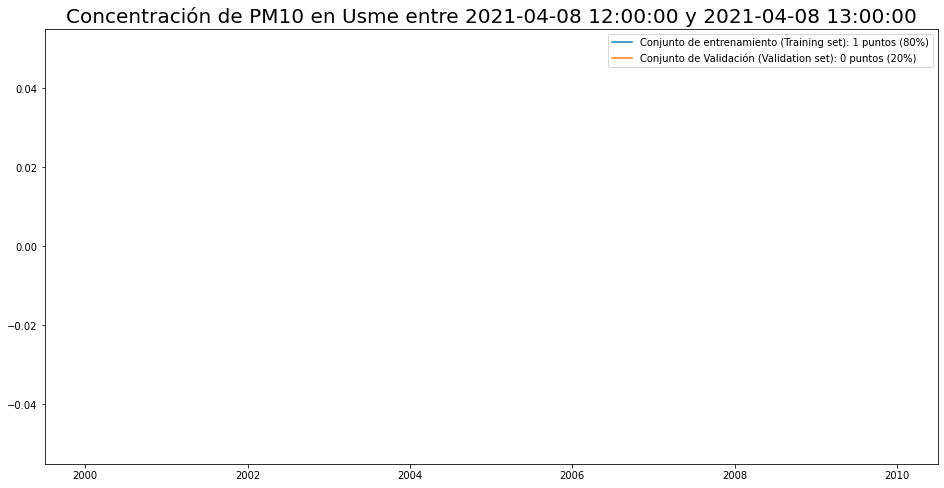

,PM10
Fecha,
2021-04-08 12:00:00,NaN
2021-04-08 13:00:00,NaN


In [ ]:
SelectPM(s= "Usme", a= "2021-04-08 12:00:00", b = "2021-04-08 13:00:00", PM="PM10") # Seleccionamos el tipo de PM a analizar 

In [ ]:
def univariate_data(dataset, start_index, end_index, history_size, target_size):
    ''' dataset: conjunto de datos
        start_index: índice inicial de donde empezar a tomar los datos
        end_index: índice final para tomar los datos. None para tomarlos todos
        history_size: tamaño de la venytana para crear las secuencias
        target_size: dentro de cuántas observaciones futuras desea pronosticar
    '''  
    data = [] #obejtos de tamaño 24
    labels = [] #objetos de tamaño 1

    start_index = start_index + history_size
    if end_index is None:
        end_index = len(dataset) - target_size

    for i in range(start_index, end_index):
        indices = range(i-history_size, i)
        # Reshape data from (history_size,) to (history_size, 1)
        data.append(np.reshape(dataset[indices], (history_size, 1)))
        labels.append(dataset[i+target_size])

    return np.array(data), np.array(labels)

In [ ]:
univariate_data(df2, start_index =  1, end_index = 24, history_size= 24, target_size= 24)

(array([], dtype=float64), array([], dtype=float64))

In [ ]:
def ModelLSTM(datos):
  model_01 = tf.keras.models.Sequential([
        tf.keras.layers.LSTM(units=units, return_sequences=True, input_shape=(datos,1)),
        tf.keras.layers.LSTM(units=units),
        tf.keras.layers.Dropout(0.2, name= 'Dropout_01'),
        tf.keras.layers.Dense(1)])
  return model_01

In [ ]:
def RedNeuronal(s,a,b,PM):
    SUPERDATA=SelectPM(s,a,b,PM)
    # plot #partir los datos entre validacion y entrenamiento
    len_data = len(SUPERDATA)
    len_train = int(len_data*0.8) # 80%  = 2415
    len_test = len_data- len_train # 20% = 604
    print (len_data, '=', len_train, '+',len_test)
    
    """
    plt.figure(figsize=(16,8))
    plt.plot(SUPERDATA[:len_train], label='Conjunto de entrenamiento (Training set): {} puntos (80%)'.format(len_train))
    plt.plot(SUPERDATA[PM][len_train:], label='Conjunto de validación (Validation set): {} puntos (20%)'.format(len_test)) #248 data
    plt.title("Concentración de {} en {} entre {} y {}".format(PM,s,a,b), size=(20))
    plt.legend()
    plt.show()
    """
    
    
    tf.random.set_seed(100)
    #creating train and test sets
    dataset = SUPERDATA.values #volver un numpy porque scaler solo acepta obejtos pandas


    # create the scaler object and scale the data
    scaler = MinMaxScaler(feature_range=(0, 1)) #pasa a los datos a escala 0, 1
    #scaled_data = np.array(scaler.fit_transform(dataset))
    dataset = np.squeeze(np.array(scaler.fit_transform(dataset)),axis=1) #agregar un eje al final
    # dataset = pd.DataFrame(scaled_data,index=data.index, columns=['serie'])

    #
    # hiperparámetros para crear las secuencias
    past_history = 24 # tamaño secuencias de entrada #se cogen los primeros 24 datos y se predice el siguiente y asi
    future_target = 1 # días adelante #el vector de dimension uno donde se predice
    TRAIN_SPLIT = int(len_data*0.8) #2415: nuḿer0 de datos entreno

    # secuencias de entrenamiento
    X_train, y_train = univariate_data(dataset, 0, TRAIN_SPLIT, past_history, future_target)
    #
    #secuencias de validación
    # No se usará ningún dato que el modelo haya visto
    X_test, y_test = univariate_data(dataset, TRAIN_SPLIT, None, past_history, future_target)
    print("len y_test",len(y_test))

    
    ############################################################
    ###################Crea el modelo LSTM######################
    ############################################################
    
    # unidades de salida de las capas LSTM
    #
    units = 200
    #
    model_01 = tf.keras.models.Sequential([
        tf.keras.layers.LSTM(units=units, return_sequences=True, input_shape=(X_train.shape[1],1)),
        tf.keras.layers.LSTM(units=units),
        tf.keras.layers.Dropout(0.2, name= 'Dropout_01'),
        tf.keras.layers.Dense(1)])

    # model_01=ModelLSTM(X_train.shape[1],units)
    
    model_01.summary()

    model_02 = tf.keras.models.Sequential([
        tf.keras.layers.GRU(units=60, return_sequences=True, input_shape=(X_train.shape[1],1),name='GRU_layer'),
        tf.keras.layers.GRU(units=units),
        tf.keras.layers.Dense(1)])
    
    #COMPILA
    #Se usará el optimizador Adam y la función de pérdida MSE
    model_01.compile(loss='mean_squared_error', optimizer="adam")
    
    ################################################
    ###############ENTRENAR EL MODELO###############
    ################################################
    
    #history = model_01.fit(X_train,y_train,epochs=20,batch_size=32)
    history = model_01.fit(X_train, y_train,epochs=30,batch_size=32,validation_split=0.1,verbose=1,shuffle=False)
    
    """
    plt.plot(history.history['loss'], label='train')
    plt.plot(history.history['val_loss'], label='test')
    plt.legend()
    plt.show();
    """
    
    ###############################################
    ####################PREDICCIONES###############
    ###############################################
    # predictions
    prediction = model_01.predict(X_test)
    #prediction = scaler.inverse_transform(prediction)
    
    #Elimina dimensiones sobrantes para graficos
    y_train_p = y_train #np.squeeze(y_train, axis=-1)
    y_test_p = y_test#np.squeeze(y_test, axis=-1)
    y_pred_p = np.squeeze(prediction, axis=-1)
    
    print("len y_test_p",len(y_test_p))
    print("len y_pred_p",len(y_pred_p))
    

    k=0
    for i,j in zip(y_test_p, y_pred_p):
        #print (i,j, i-j)
        k+=1
        if k==10:
            break
    
    """
    plt.plot(np.arange(0, len(y_train_p)), y_train_p, 'g', label="historia")
    plt.plot(np.arange(len(y_train_p), len(y_train_p) + len(y_test_p)), y_test_p, marker='.', label="verdadero")
    plt.plot(np.arange(len(y_train_p), len(y_train_p) + len(y_test_p)), y_pred_p, 'r', label="predicción")
    #plt.ylabel('Valor')
    plt.xlabel('Time Step')
    plt.title("Concentración de {} en {} entre {} y {}. Escala (0,1)".format(PM,s,a,b), size=(20))
    plt.legend()
    plt.show();
    """
    
    #Regreso a la escala original
    y_pred_or = scaler.inverse_transform(y_pred_p.reshape(-1,1))
    y_test_or = scaler.inverse_transform(y_test_p.reshape(-1,1))
    
    k=0
    for i,j in zip(y_test_or, y_pred_or):
        #print (i,j, i-j)
        k+=1
        if k==10:
            break
    
    rmsLSTM = np.sqrt(np.mean(np.power(y_pred_or-y_test_or,2)))
    print(rmsLSTM )
    

    plt.plot(np.arange(0, len(y_test_or)), y_test_or, marker='.', label="verdadero")
    plt.plot(np.arange(0, len(y_test_or)), y_pred_or, marker='+', label="predicho")
    plt.xlabel('Time Step')
    plt.annotate("rms = "+str(round(rmsLSTM,2)) , xy=(100, 140), size = 15)
    plt.annotate("modelo = LSTM(50), timestep=60" , xy=(100, 146), size = 15)
    plt.annotate("epochs=40" , xy=(100, 143), size = 15)
    plt.title("Concentración de {} en {} entre {} y {}. Escala original".format(PM,s,a,b), size=(20))
    plt.legend()
    plt.show();




    DatosDeVuelta0=SUPERDATA[PM].tail(len(y_test_or))
    DatosDeVuelta=DatosDeVuelta0.to_frame()
    y_pred_or2=y_pred_or.flatten()
    DatosDeVuelta["prediccion"]=y_pred_or2
    return DatosDeVuelta, rmsLSTM

1393
1393


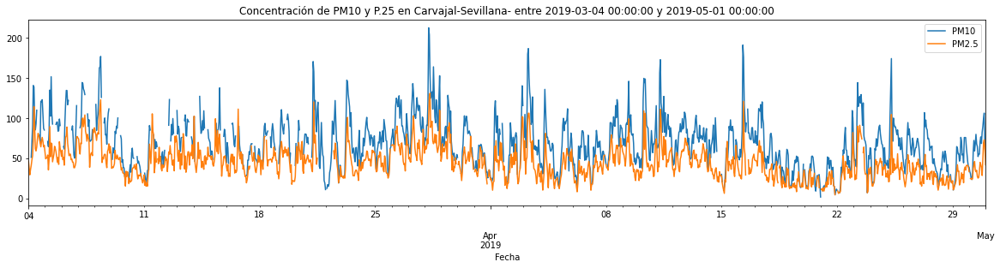

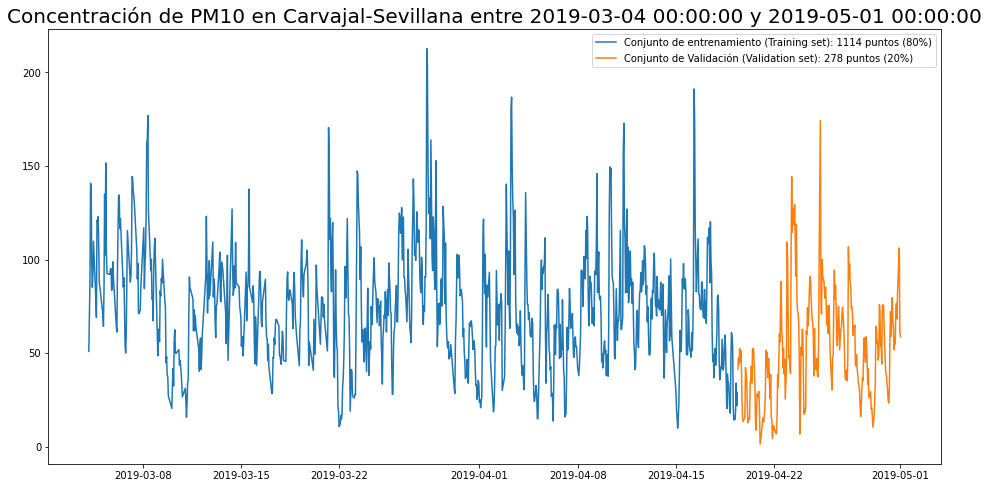

1393 = 1114 + 279
len y_test 254
Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_10 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_11 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_7 (Dense)              (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
31/31 [==============================] - 3s 27ms/step - loss: nan - val_loss: nan
Epoch 2/30
31/31 [==============================] - 0s 8ms/step - loss: nan - val_loss: nan
Epoch 3/30
31/31 [==========

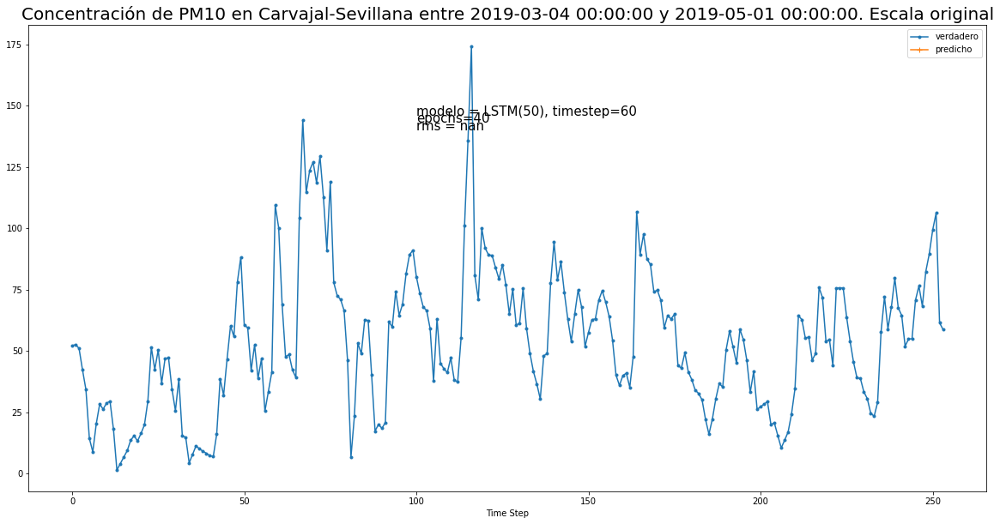

In [ ]:
CARVAJAL = RedNeuronal("Carvajal-Sevillana",'2019-03-04 00:00:00','2019-05-01 00:00:00',"PM10")

In [ ]:
def plotfinal(Data,a,b,PM,s,PMv):
    DataF=Data[0].loc[a:b]
    fig, ax = plt.subplots()
    ax.plot(DataF['prediccion'], marker='X', markersize=9,linestyle='None', label="prediccion",c='#ff7f0e')
    ax.plot(DataF[PMv], color='0.2', linewidth=3,label=PMv)
    # Set x-ticks to yearly interval and add legend and labels
    #ax.xaxis.set_major_locator(mdates.YearLocator())
    ax.legend()
    ax.set_xlabel('Dias')
    ax.set_ylabel('Concentracion de {}'.format(PMv))
    ax.set_title("Concentración de {} en {} entre {} y {}".format(PMv,s,a,b));
    fig.savefig("Concentración de {} en {} entre {} y {}.jpg".format(PM,s,a,b))
    print("Error cuadratico medio:",Data[1])
    return ("Error cuadratico medio:",Data[1])

In [ ]:
def Graficas_estaciones(Estacion0,PM0,numeroPM):
    CARVAJAL_01_PM25=RedNeuronal(Estacion0,'2018-12-01 00:00:00','2019-02-01 00:00:00',PM0)
    plotfinal(CARVAJAL_01_PM25,"2019-01-21 0:00:00","2019-01-28 00:00:00",numeroPM,Estacion0,PM0)
    CARVAJAL_02_PM25=RedNeuronal(Estacion0,'2019-02-01 00:00:00','2019-04-01 00:00:00',PM0)
    plotfinal(CARVAJAL_02_PM25,"2019-03-25 0:00:00","2019-04-01 00:00:00",numeroPM,Estacion0,PM0)
    CARVAJAL_03_PM25=RedNeuronal(Estacion0,'2019-04-01 00:00:00','2019-06-01 00:00:00',PM0)
    plotfinal(CARVAJAL_03_PM25,"2019-05-25 0:00:00","2019-06-01 00:00:00",numeroPM,Estacion0,PM0)
    CARVAJAL_04_PM25=RedNeuronal(Estacion0,'2019-06-01 00:00:00','2019-08-01 00:00:00',PM0)
    plotfinal(CARVAJAL_04_PM25,"2019-07-25 0:00:00","2019-08-01 00:00:00",numeroPM,Estacion0,PM0)
    CARVAJAL_05_PM25=RedNeuronal(Estacion0,'2019-08-01 00:00:00','2019-10-01 00:00:00',PM0)
    plotfinal(CARVAJAL_05_PM25,"2019-09-24 0:00:00","2019-10-01 00:00:00",numeroPM,Estacion0,PM0)
    CARVAJAL_06_PM25=RedNeuronal(Estacion0,'2019-10-01 00:00:00','2019-12-01 00:00:00',PM0)
    plotfinal(CARVAJAL_06_PM25,"2019-11-24 0:00:00","2019-12-01 00:00:00",numeroPM,Estacion0,PM0)

1489
1489


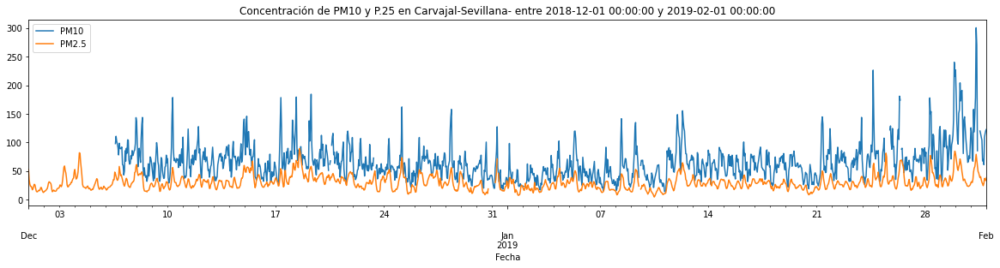

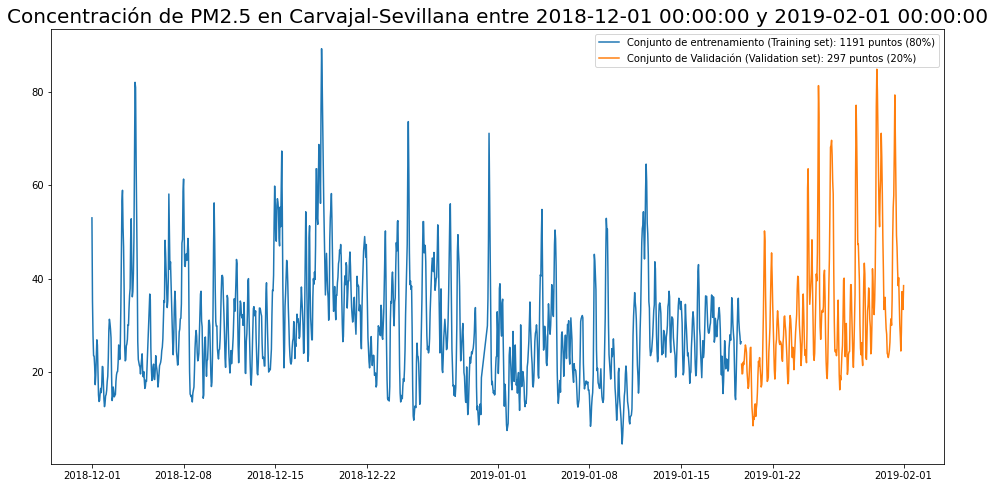

1489 = 1191 + 298
len y_test 273
Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_14 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_15 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_11 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 3s 26ms/step - loss: 0.0228 - val_loss: 0.0055
Epoch 2/30
33/33 [==============================] - 0s 7ms/step - loss: 0.0173 - val_loss: 0.0057
Epoch 3/30
33/3

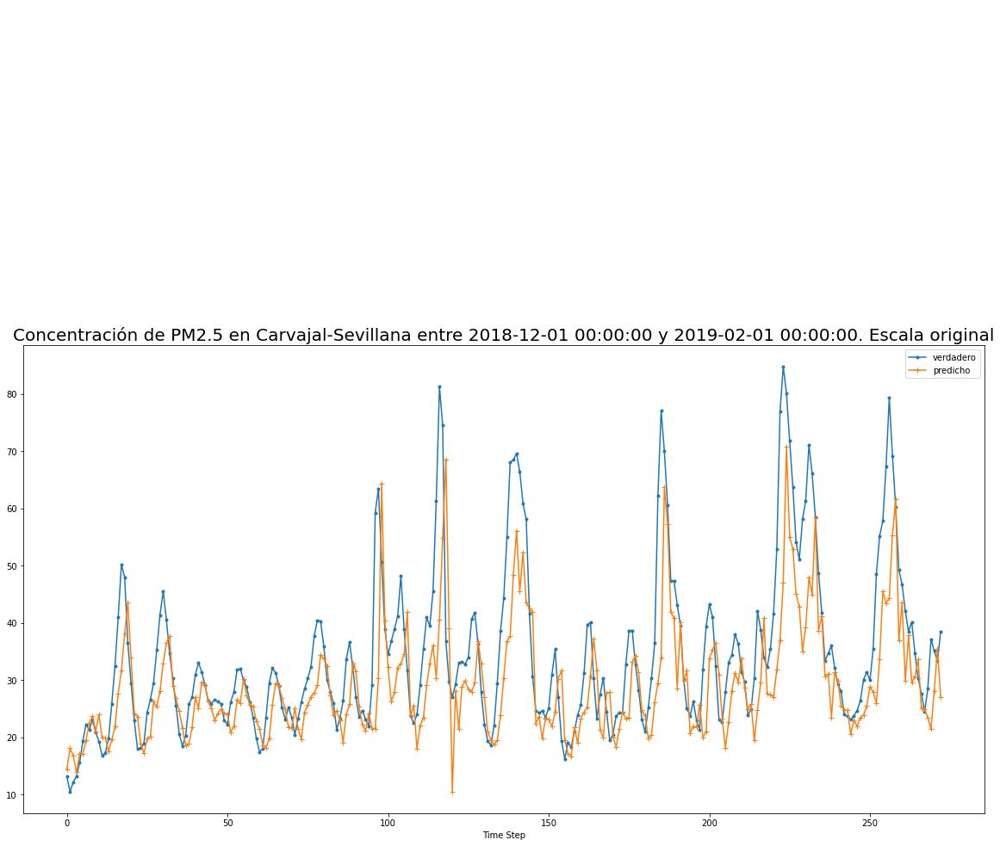

Error cuadratico medio: 10.912455774050143
1417
1417


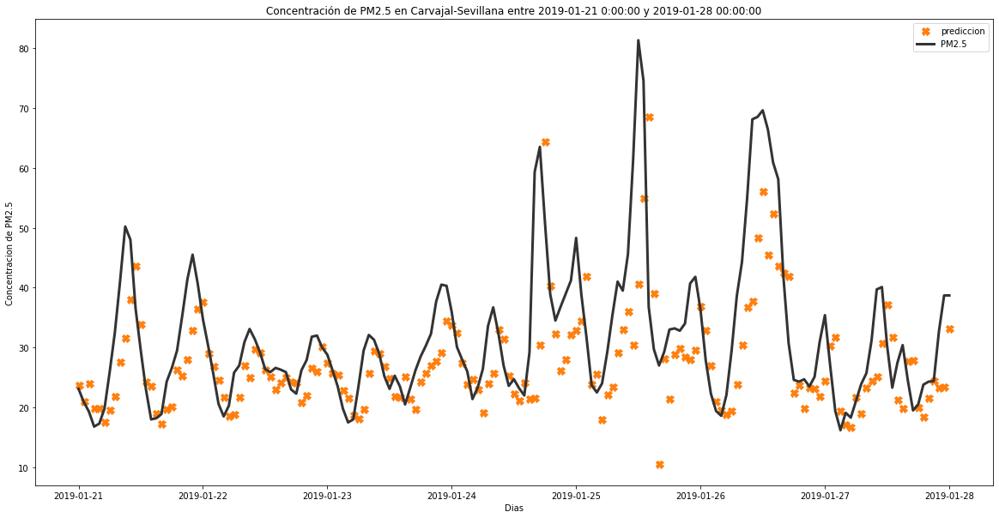

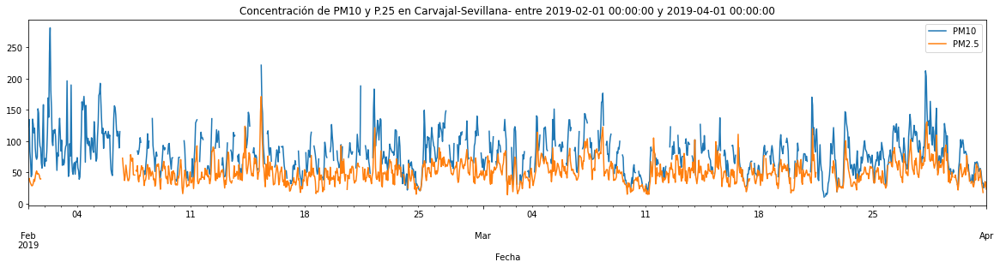

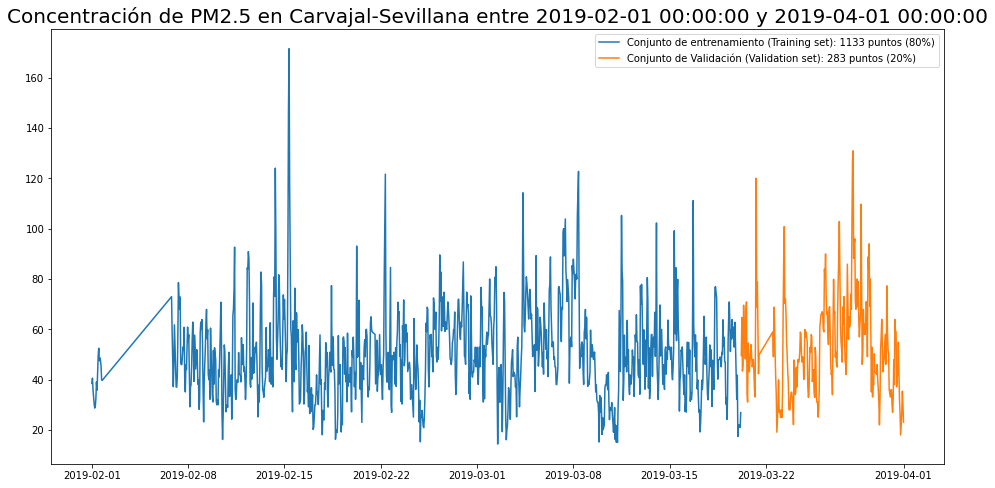

1417 = 1133 + 284
len y_test 259
Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_16 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_17 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_13 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
32/32 [==============================] - 3s 27ms/step - loss: 0.0173 - val_loss: 0.0096
Epoch 2/30
32/32 [==============================] - 0s 9ms/step - loss: 0.0113 - val_loss: 0.0100
Epoch 3/30
32/3

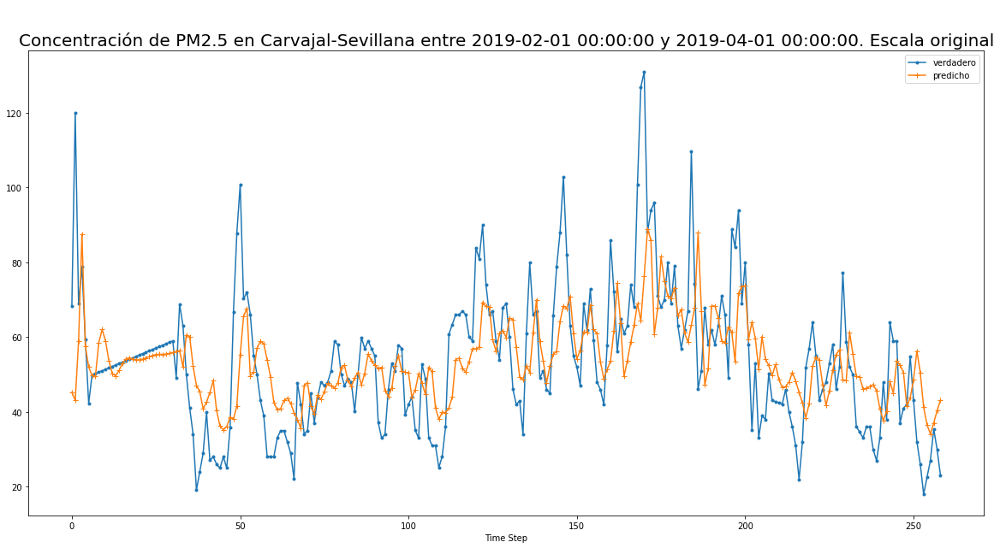

Error cuadratico medio: 15.349317624576733
1465
1465


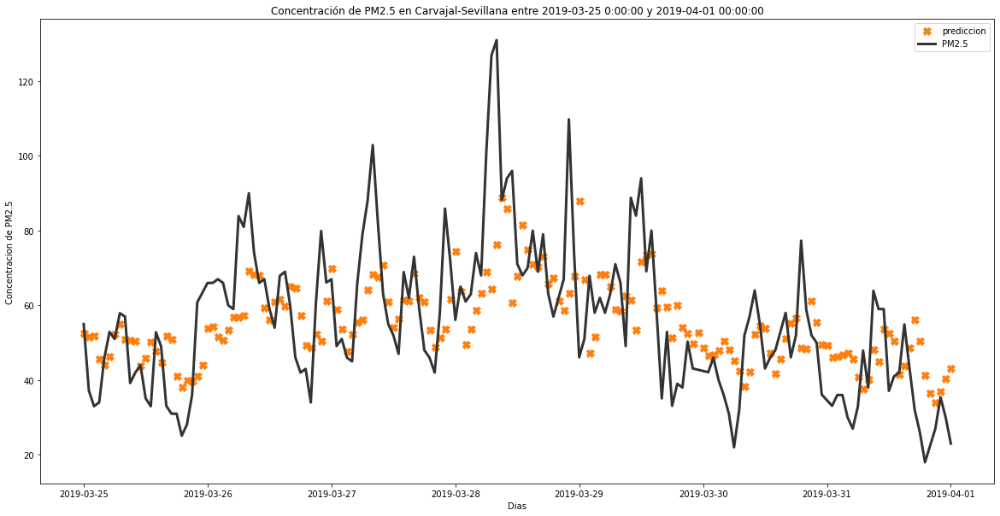

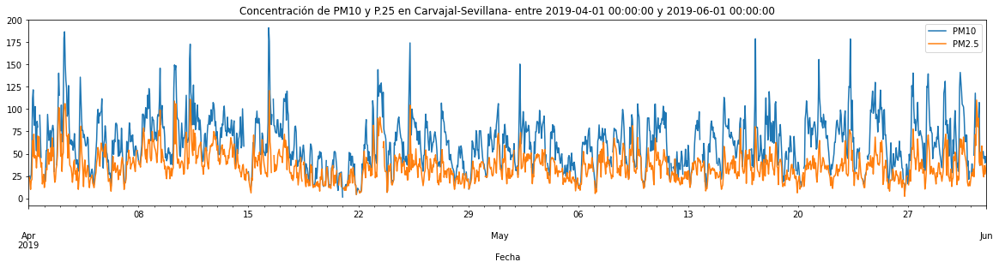

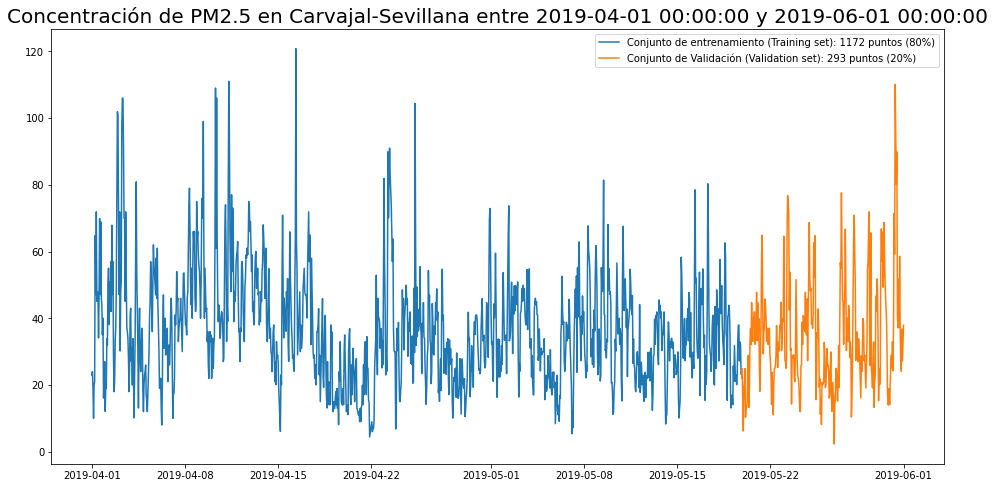

1465 = 1172 + 293
len y_test 268
Model: "sequential_15"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_18 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_19 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_15 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 3s 26ms/step - loss: 0.0259 - val_loss: 0.0131
Epoch 2/30
33/33 [==============================] - 0s 9ms/step - loss: 0.0171 - val_loss: 0.0131
Epoch 3/30
33/3

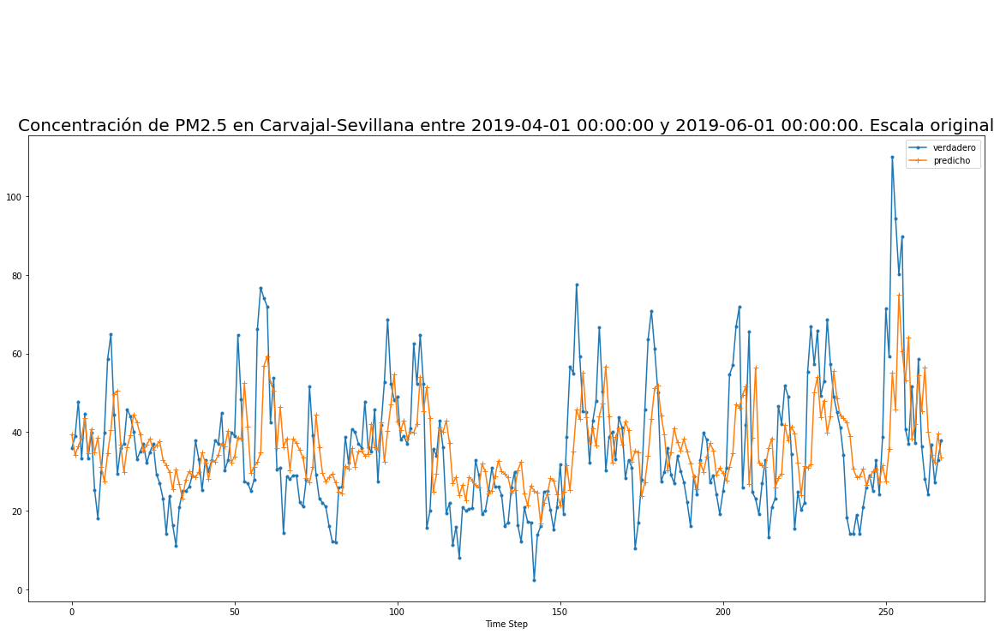

Error cuadratico medio: 14.363218925815342
1465
1465


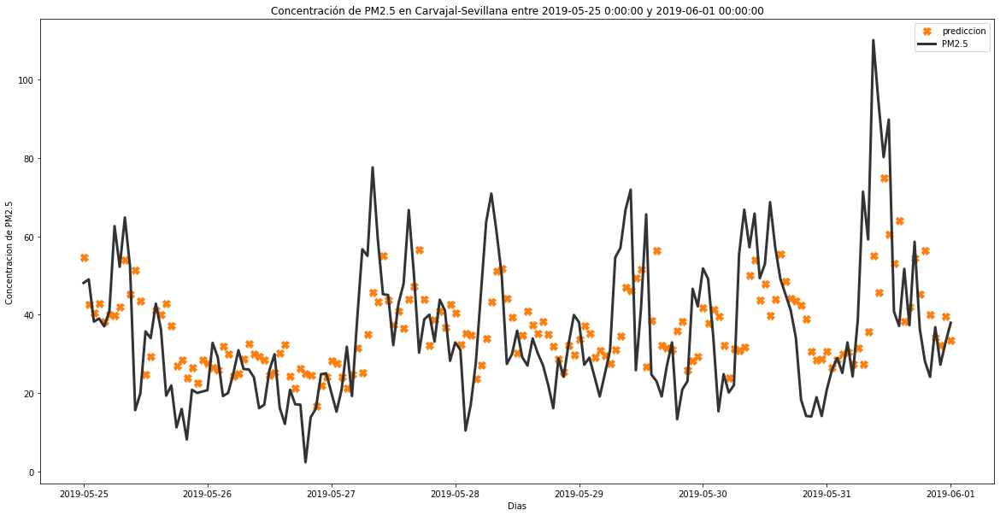

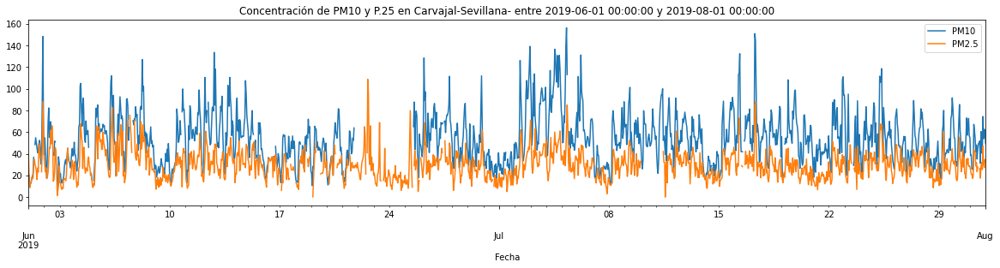

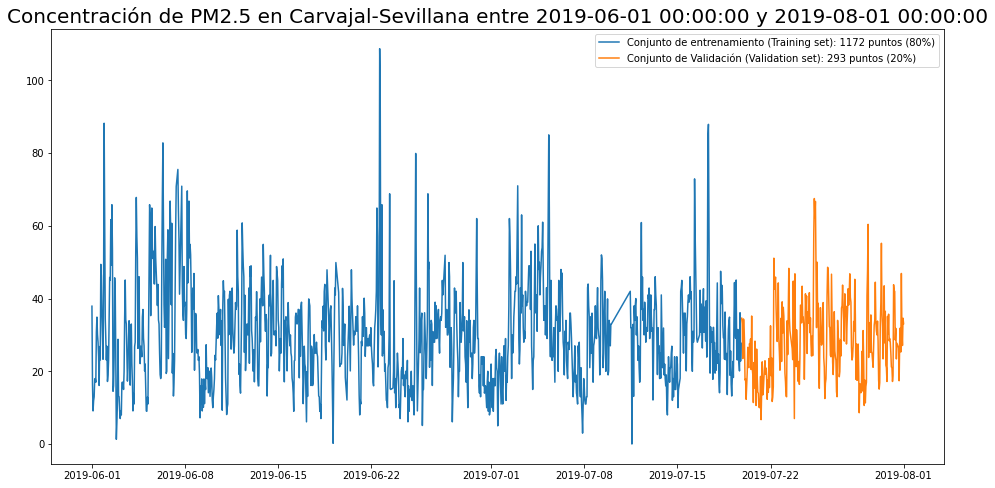

1465 = 1172 + 293
len y_test 268
Model: "sequential_17"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_20 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_21 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_17 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 3s 28ms/step - loss: 0.0237 - val_loss: 0.0135
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0149 - val_loss: 0.0133
Epoch 3/30
33/

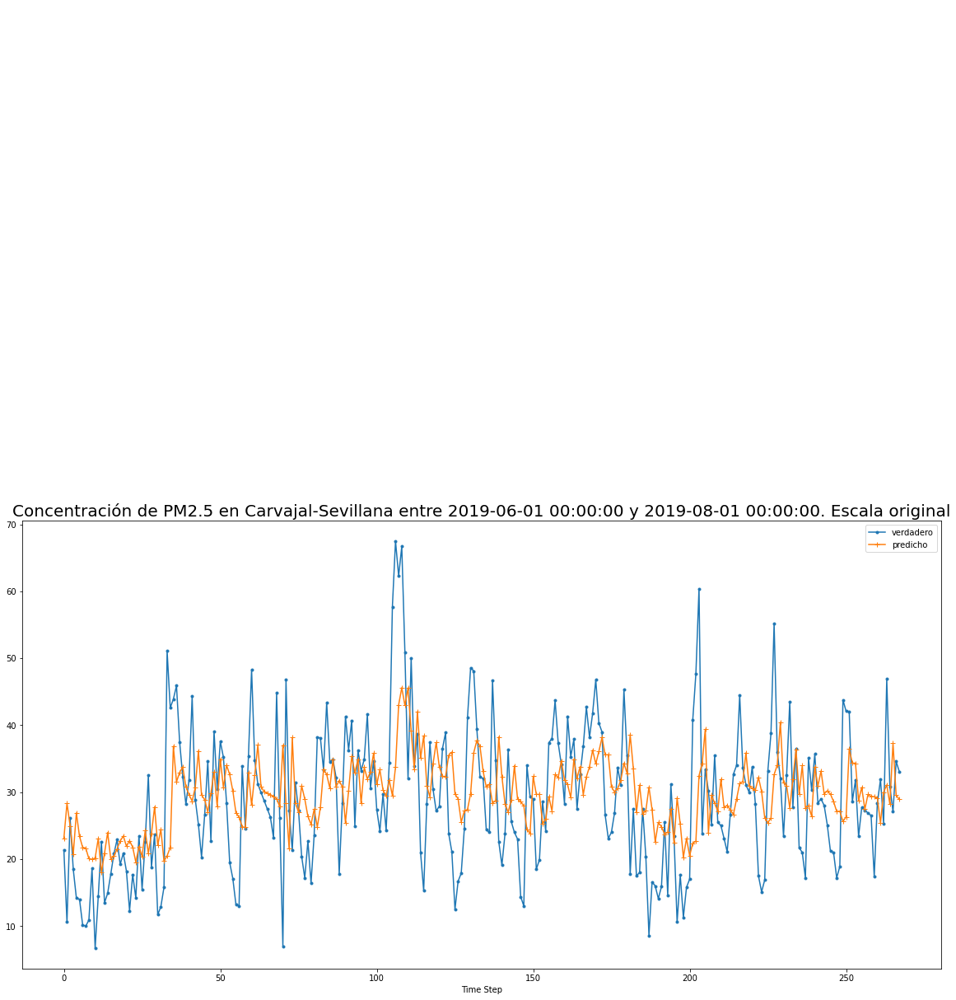

Error cuadratico medio: 9.944252684904656
1465
1465


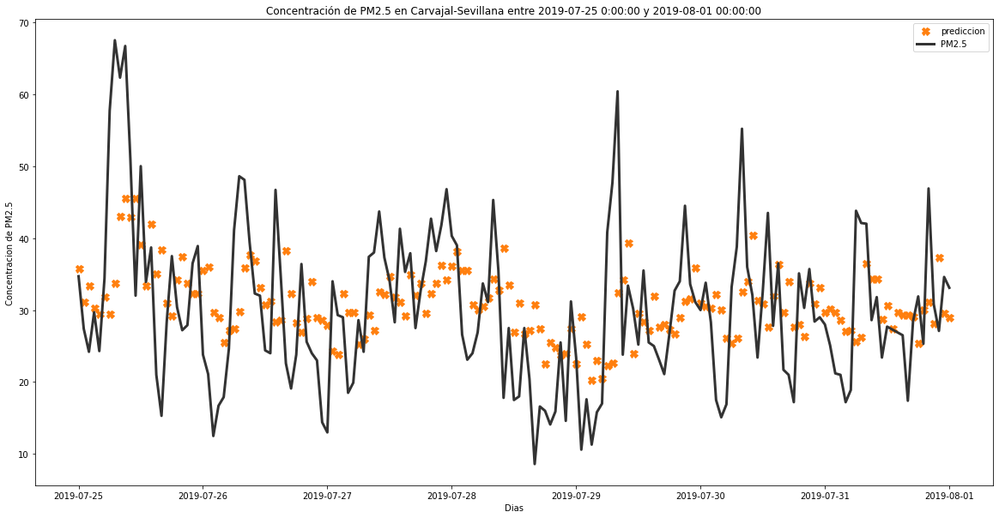

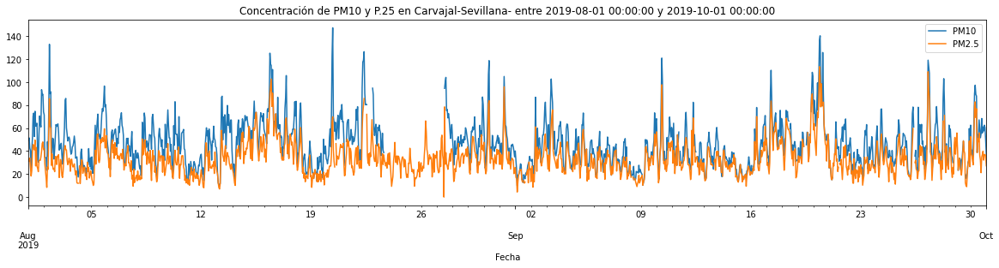

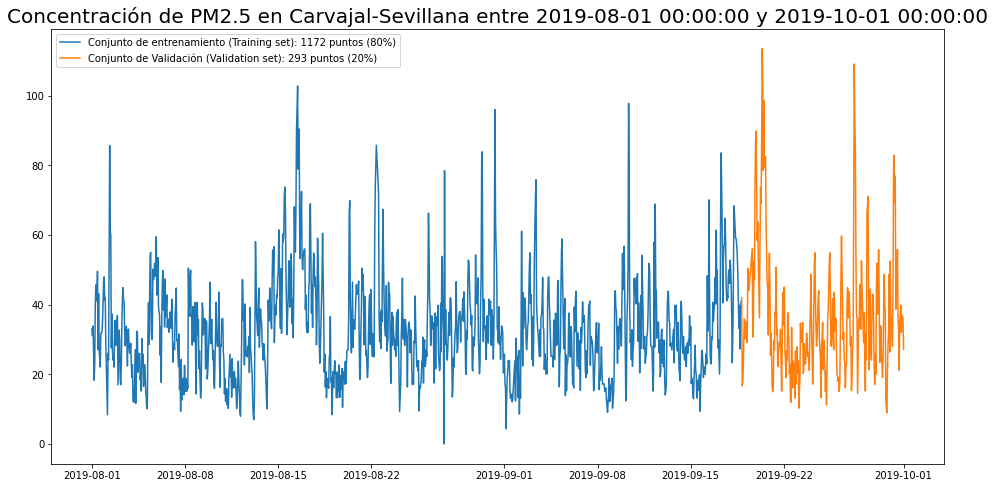

1465 = 1172 + 293
len y_test 268
Model: "sequential_19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_22 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_23 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_19 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 3s 28ms/step - loss: 0.0244 - val_loss: 0.0134
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0132 - val_loss: 0.0129
Epoch 3/30
33/

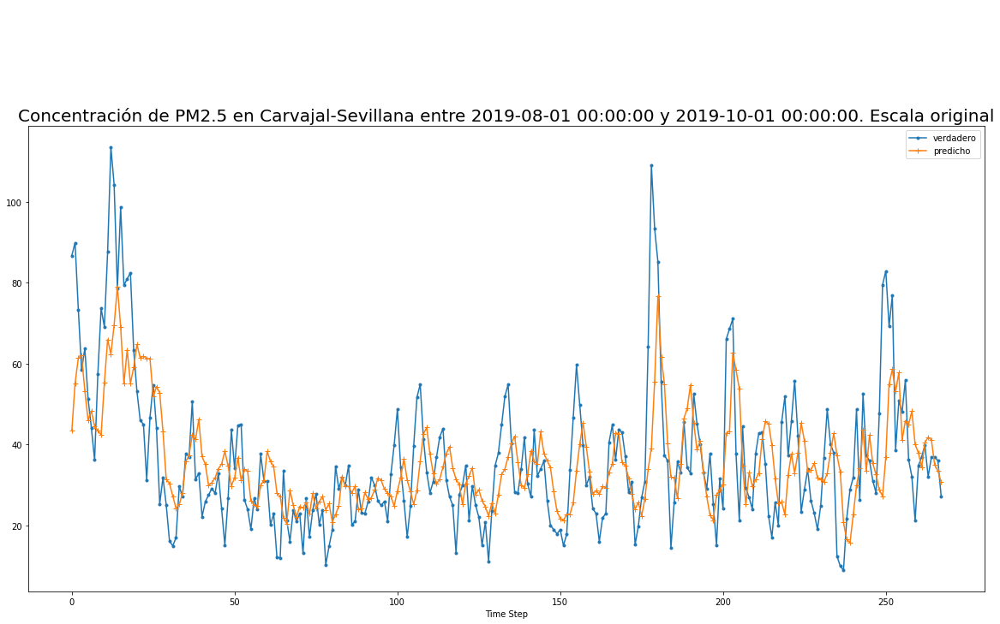

Error cuadratico medio: 14.105882709934988
1465
1465


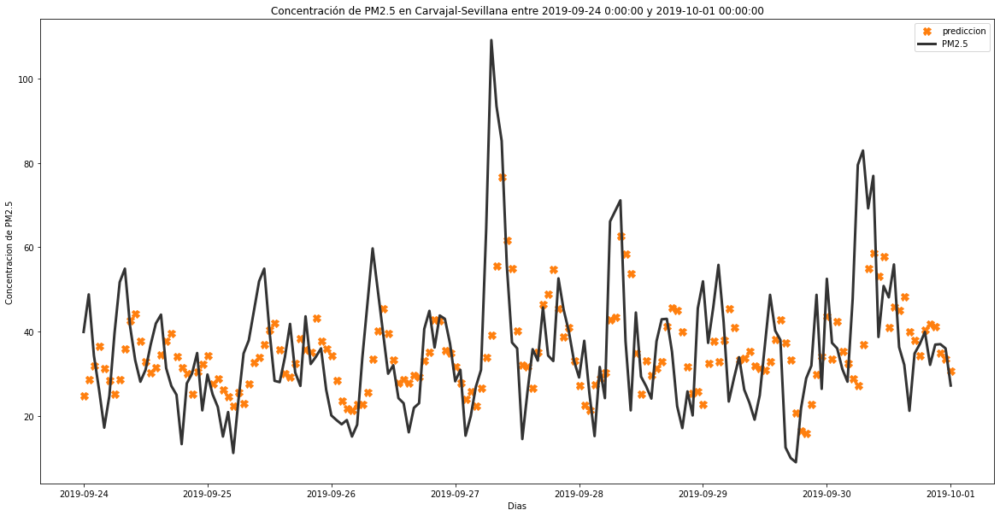

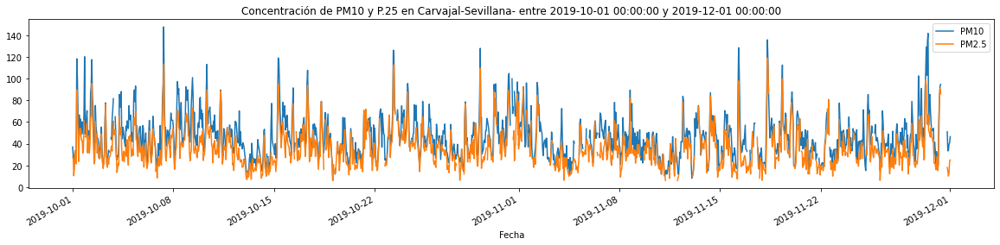

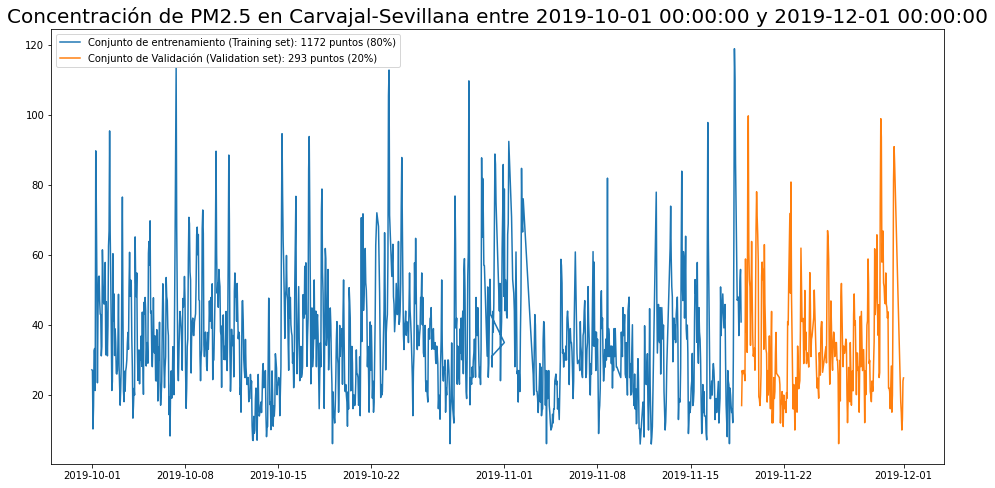

1465 = 1172 + 293
len y_test 268
Model: "sequential_21"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_24 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_25 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_21 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 3s 28ms/step - loss: 0.0262 - val_loss: 0.0380
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0209 - val_loss: 0.0384
Epoch 3/30
33/

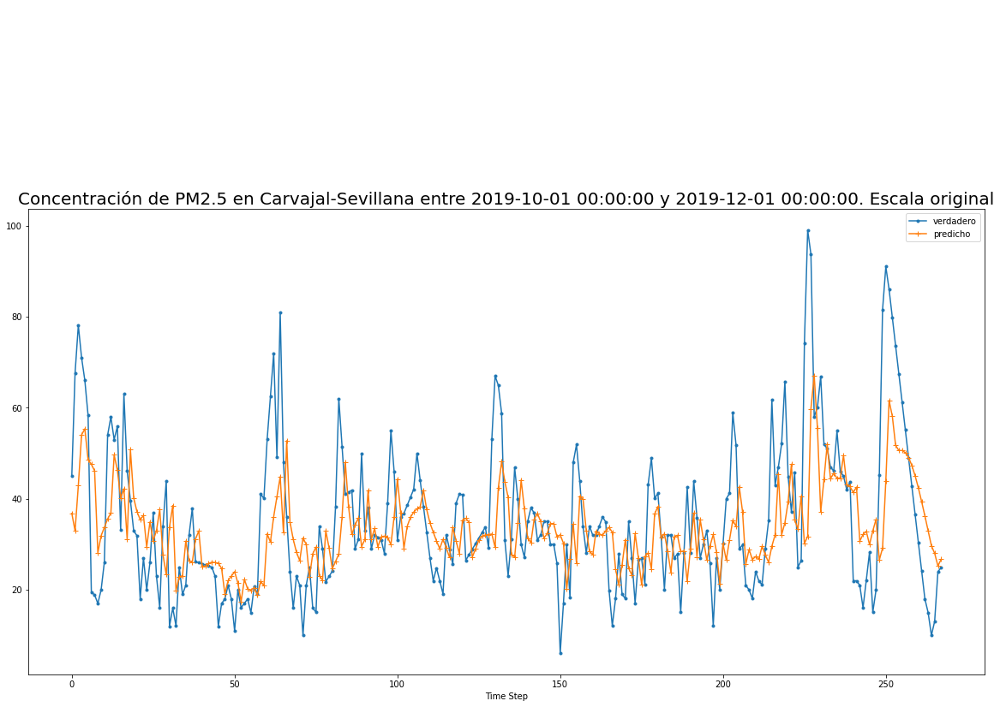

Error cuadratico medio: 14.41179037412262
1489
1489


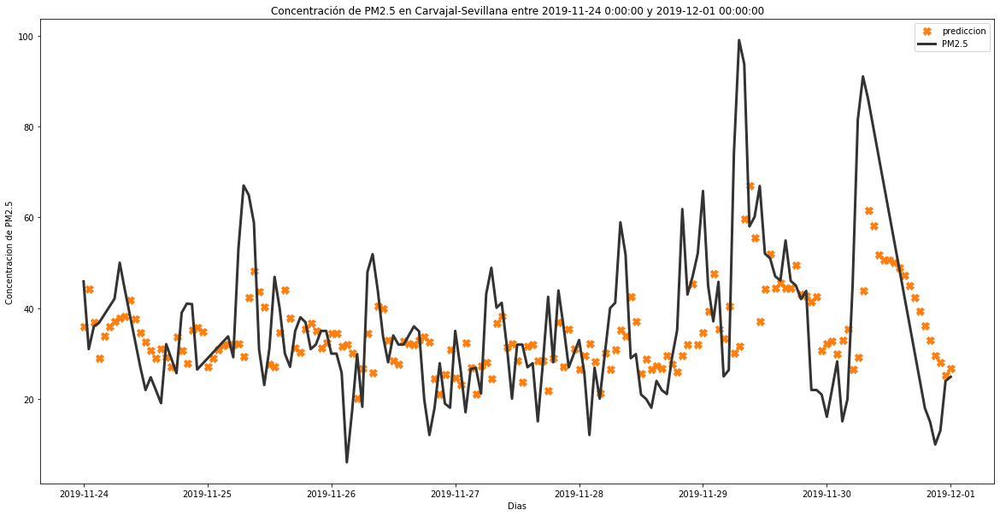

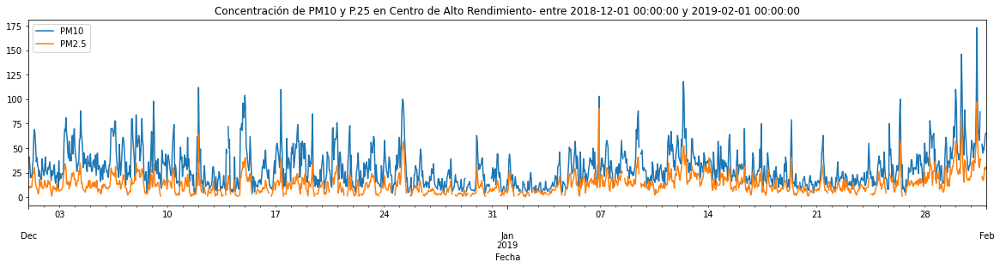

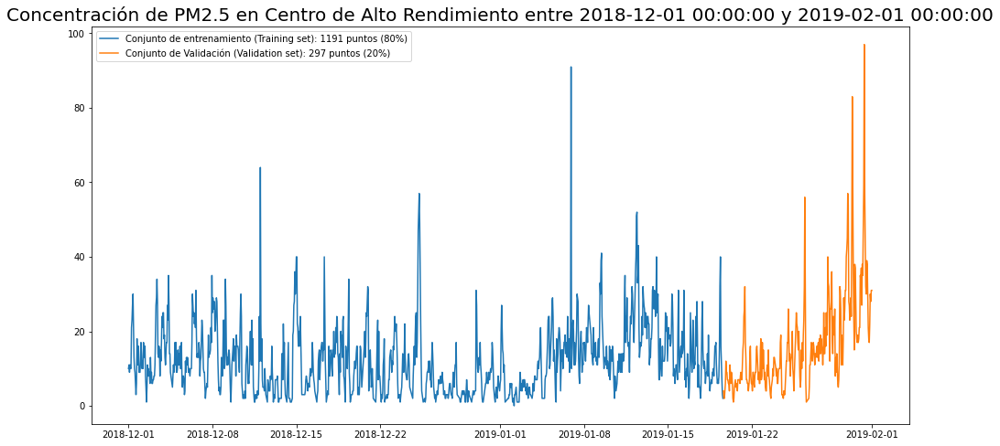

1489 = 1191 + 298
len y_test 273
Model: "sequential_23"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_26 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_27 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_23 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 3s 27ms/step - loss: 0.0091 - val_loss: 0.0121
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0086 - val_loss: 0.0069
Epoch 3/30
33/

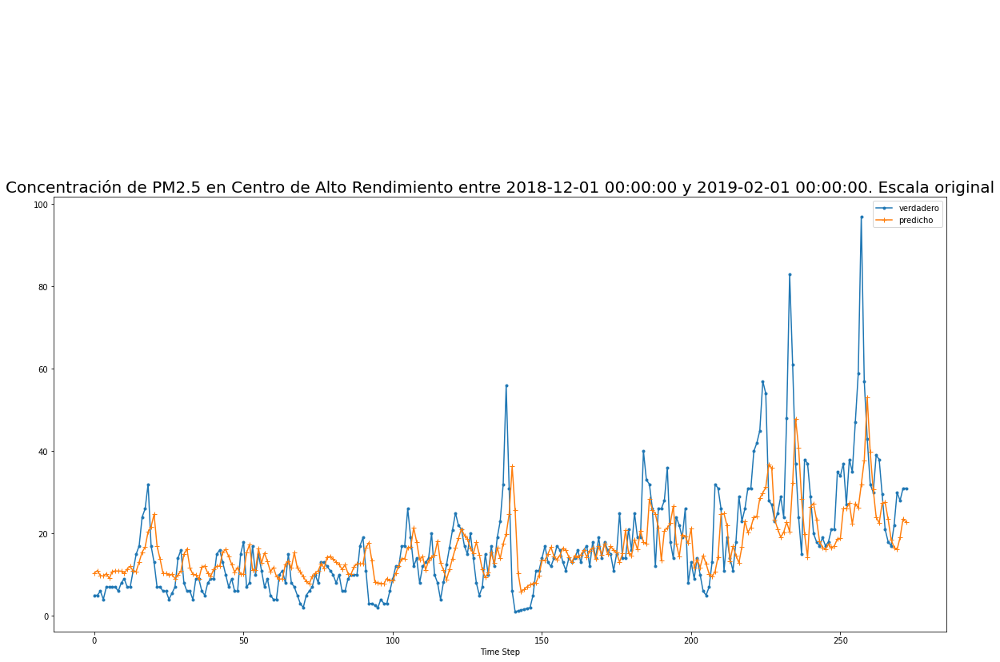

Error cuadratico medio: 10.253501310735937
1417
1417


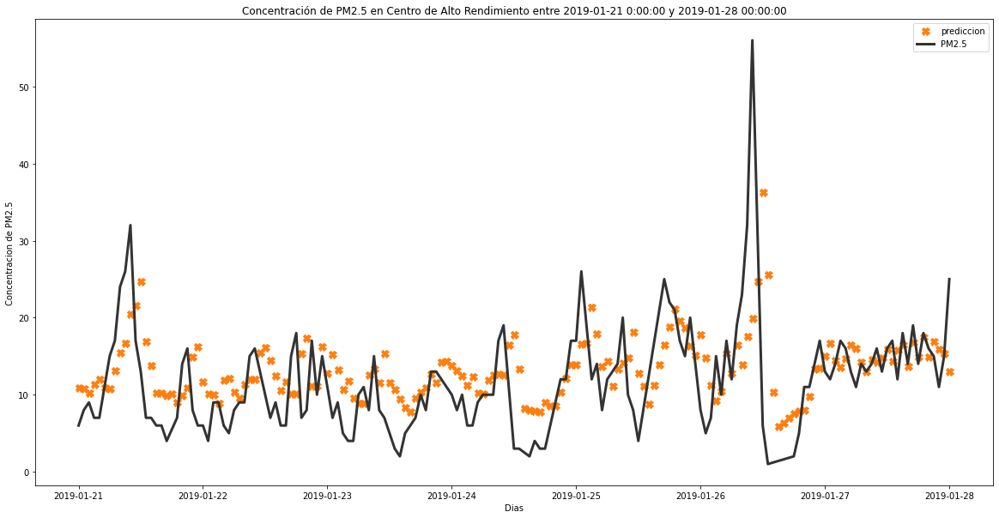

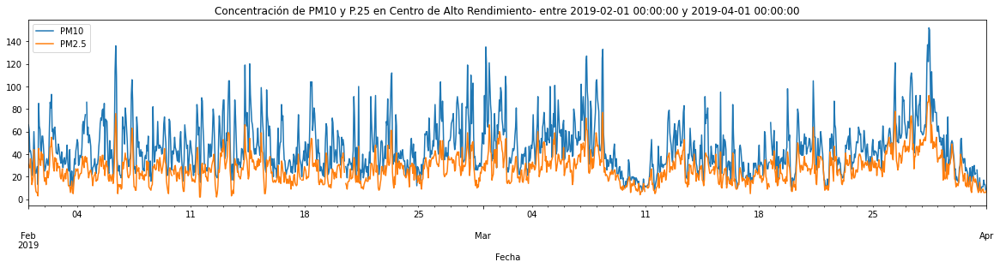

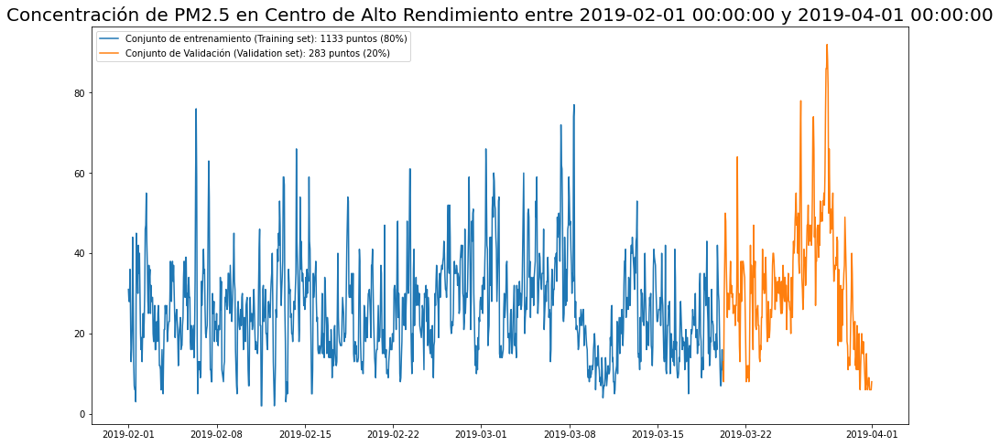

1417 = 1133 + 284
len y_test 259
Model: "sequential_25"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_28 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_29 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_25 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
32/32 [==============================] - 3s 30ms/step - loss: 0.0210 - val_loss: 0.0085
Epoch 2/30
32/32 [==============================] - 0s 9ms/step - loss: 0.0166 - val_loss: 0.0086
Epoch 3/30
32/3

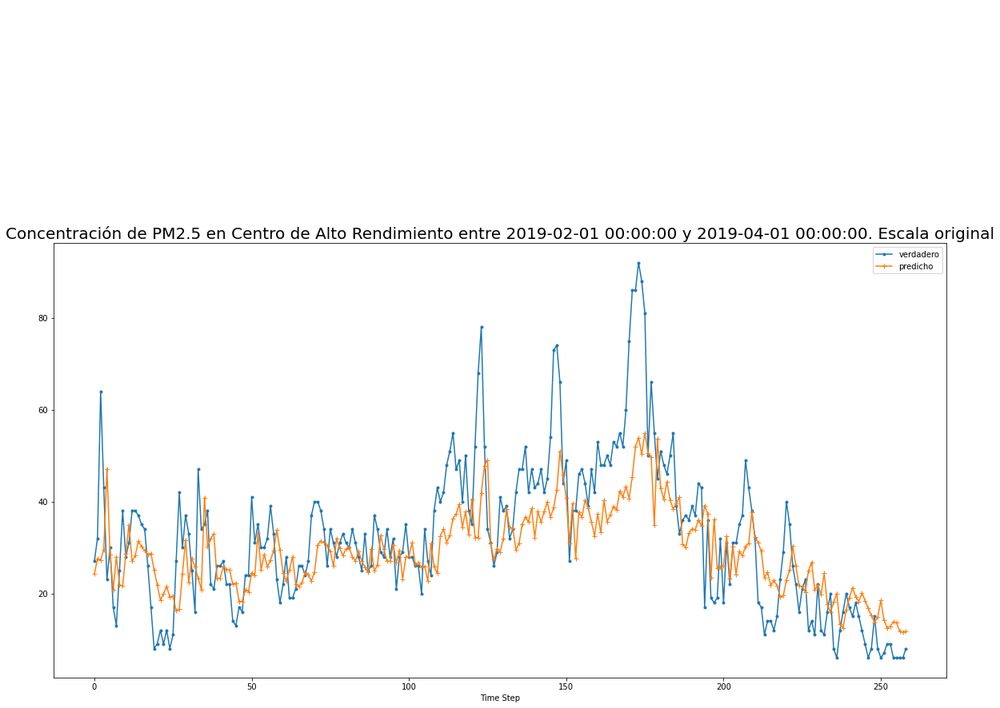

Error cuadratico medio: 11.534454444063694
1465
1465


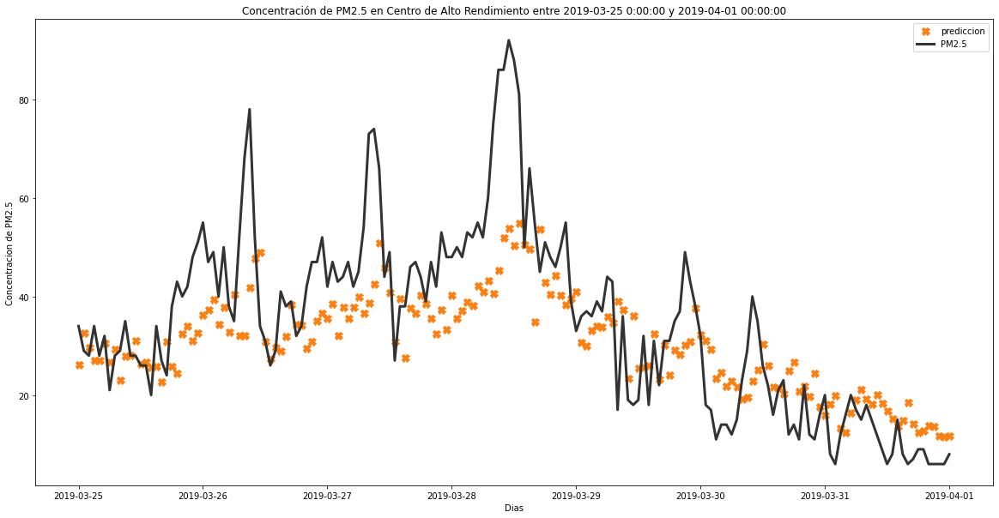

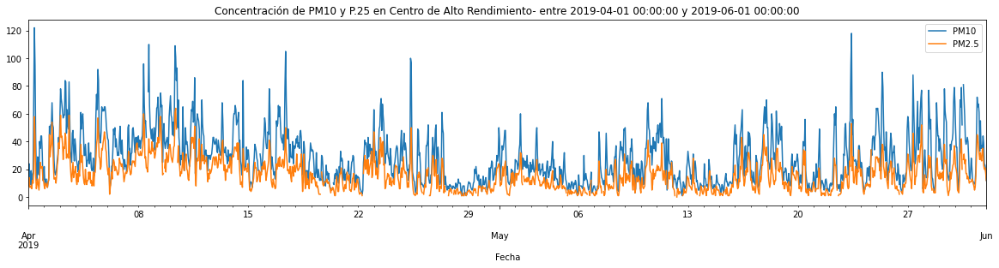

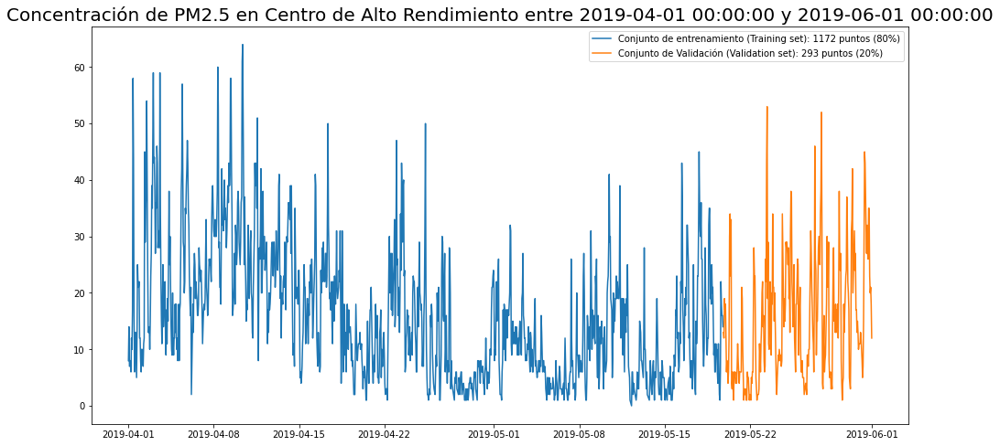

1465 = 1172 + 293
len y_test 268
Model: "sequential_27"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_30 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_31 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_27 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 3s 28ms/step - loss: 0.0319 - val_loss: 0.0254
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0216 - val_loss: 0.0243
Epoch 3/30
33/

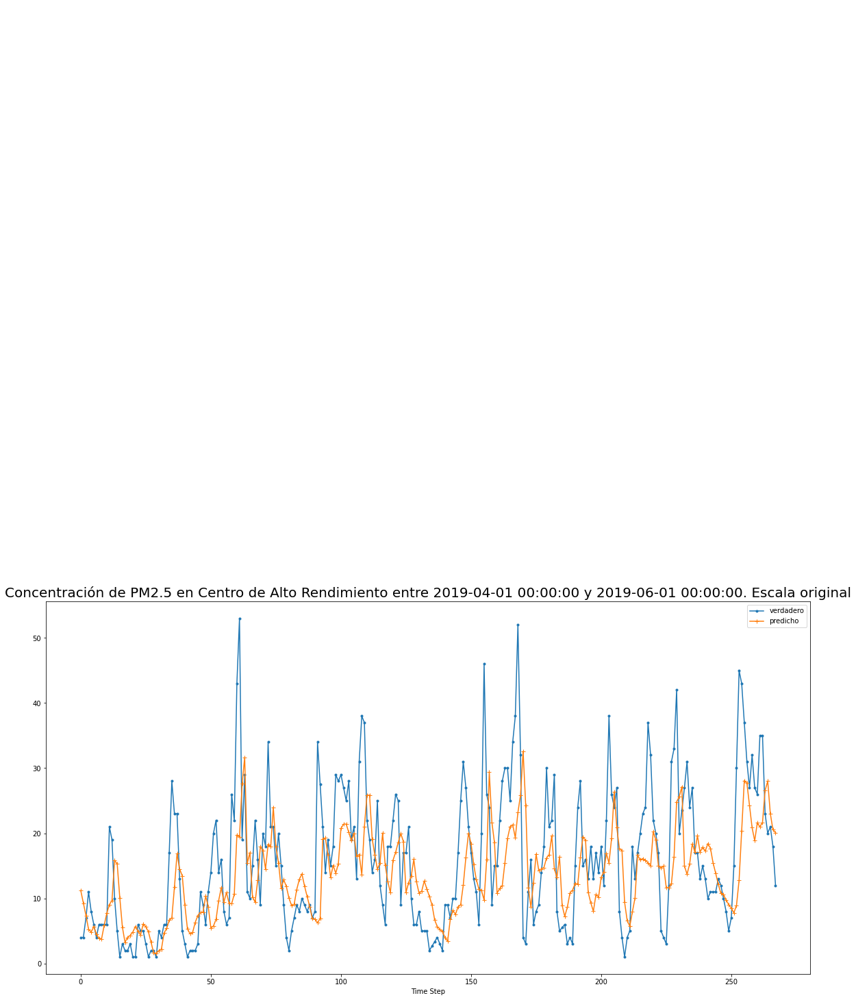

Error cuadratico medio: 9.419956909846107
1465
1465


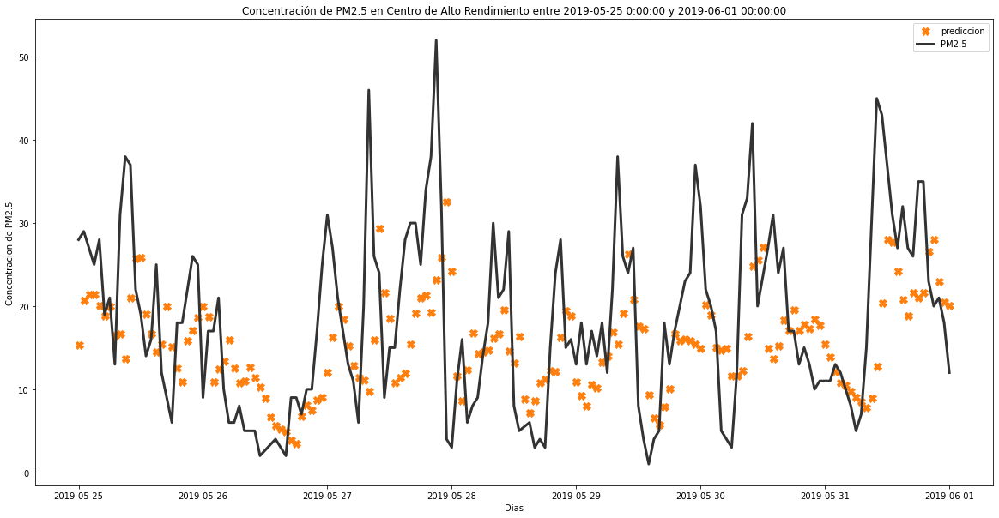

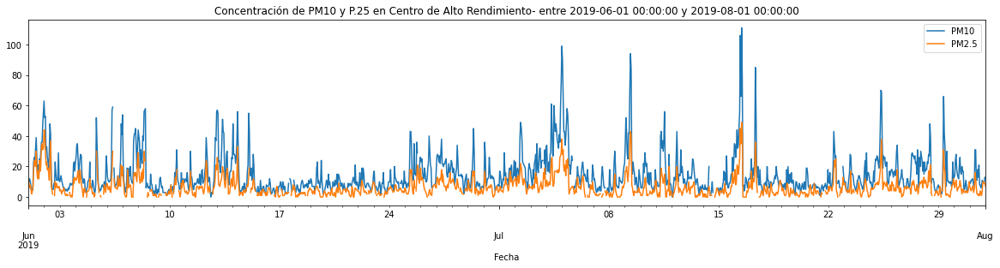

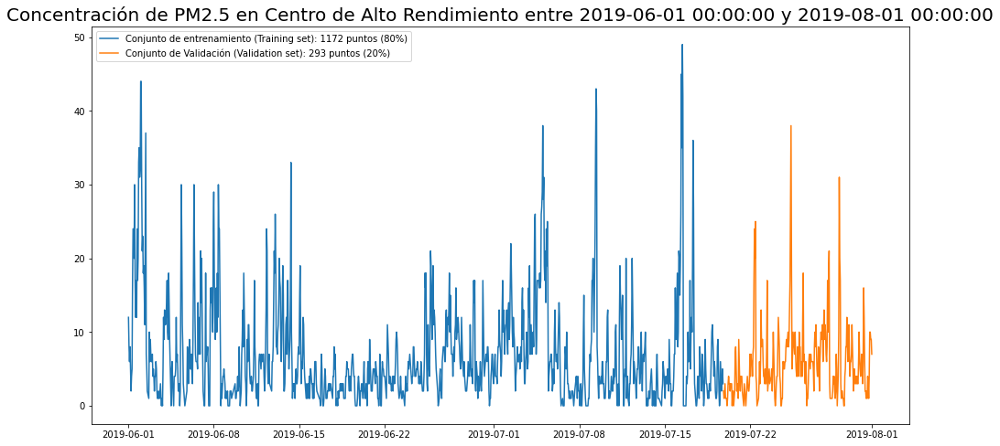

1465 = 1172 + 293
len y_test 268
Model: "sequential_29"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_32 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_33 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_29 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 3s 29ms/step - loss: 0.0162 - val_loss: 0.0336
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0138 - val_loss: 0.0328
Epoch 3/30
33/

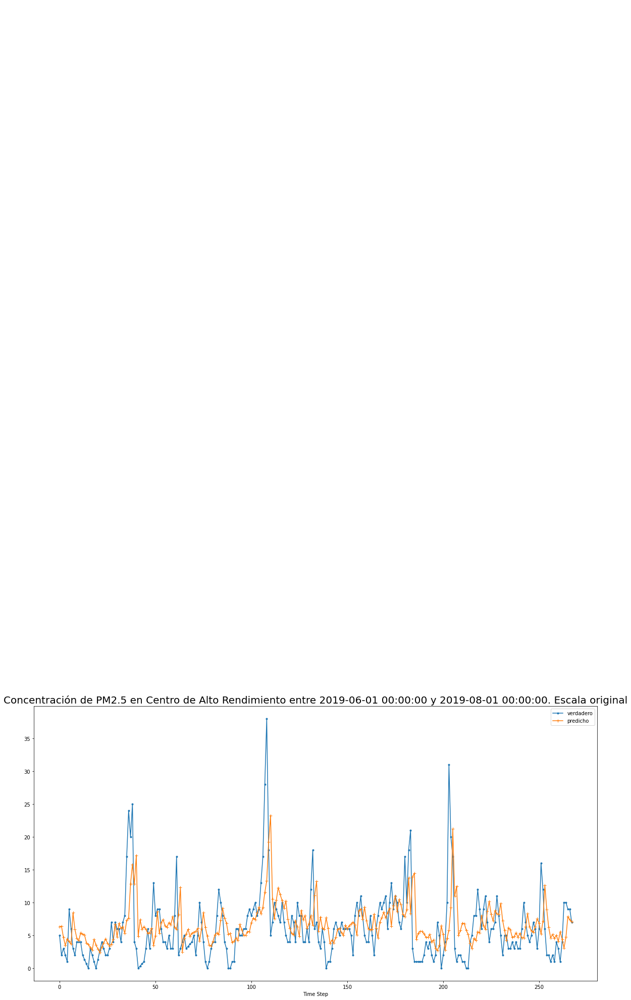

Error cuadratico medio: 4.97221699771159
1465
1465


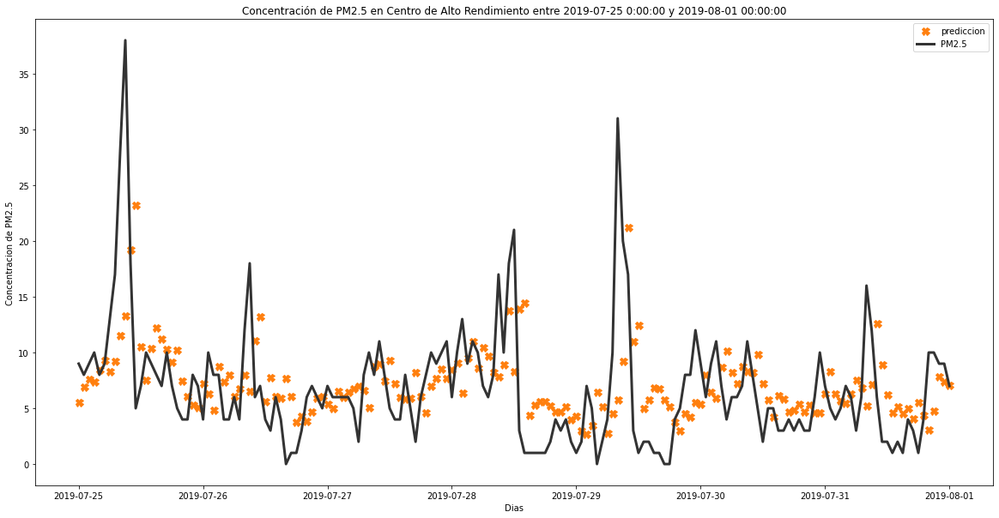

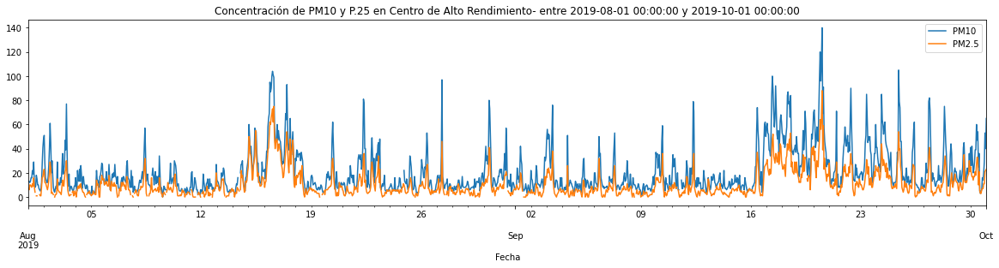

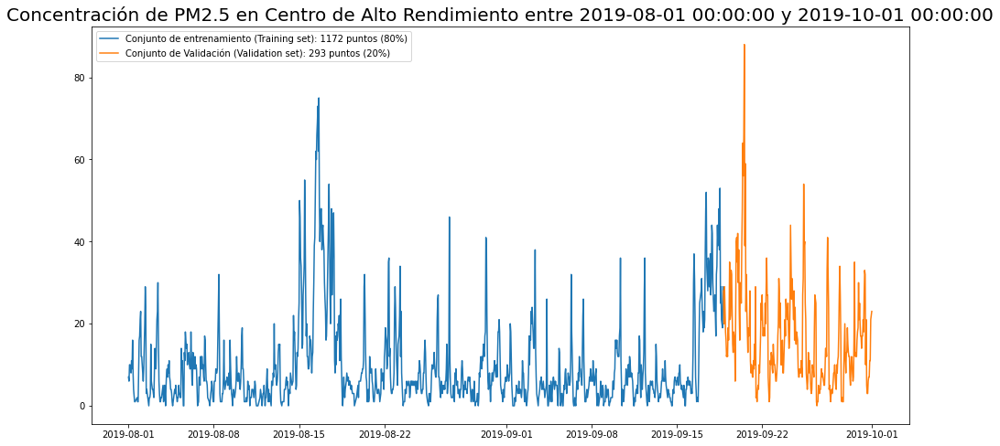

1465 = 1172 + 293
len y_test 268
Model: "sequential_31"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_34 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_35 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_31 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 30ms/step - loss: 0.0128 - val_loss: 0.0178
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0107 - val_loss: 0.0151
Epoch 3/30
33/

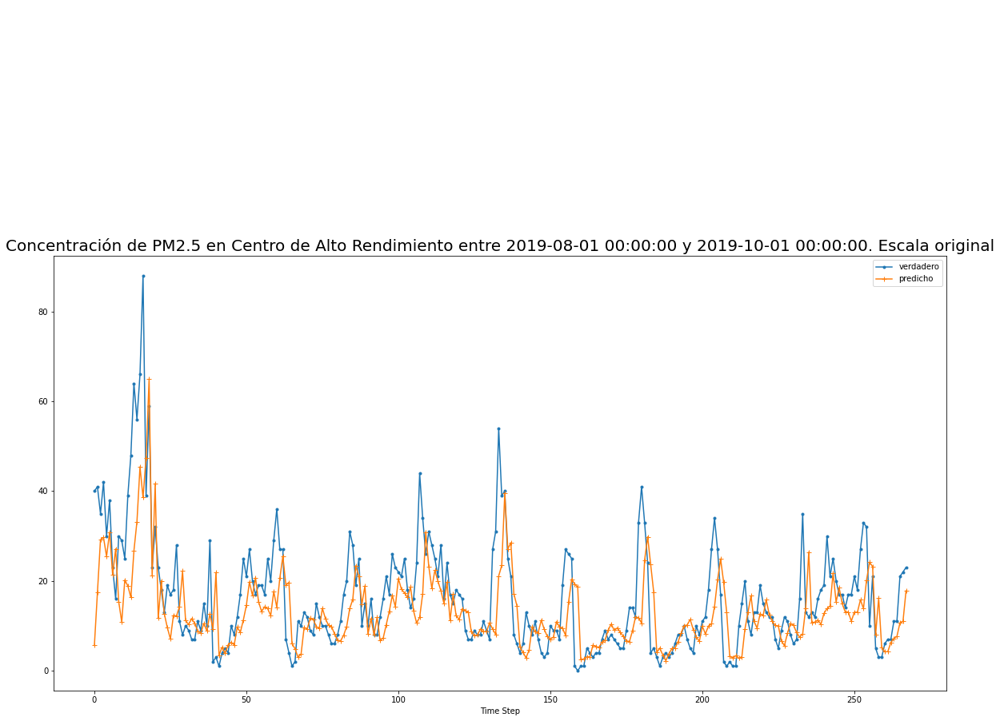

Error cuadratico medio: 10.009089686563154
1465
1465


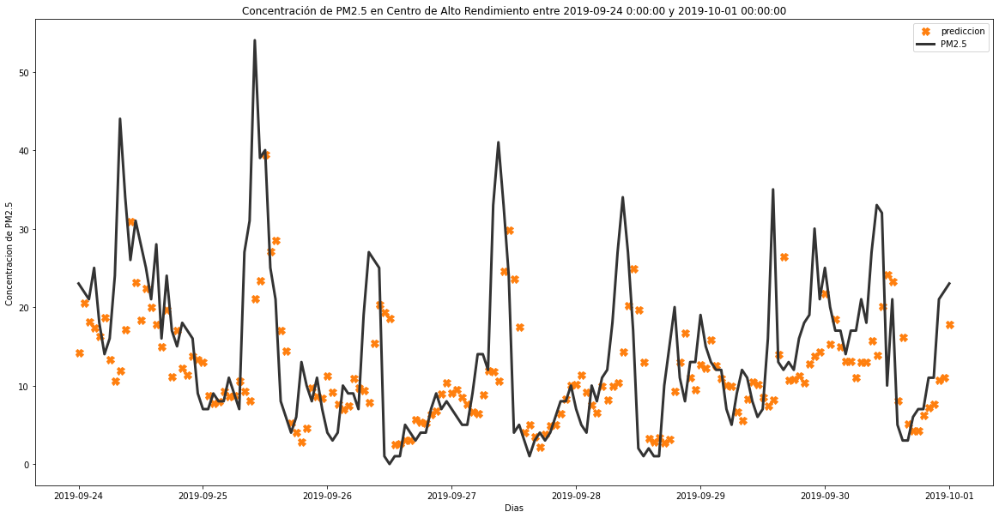

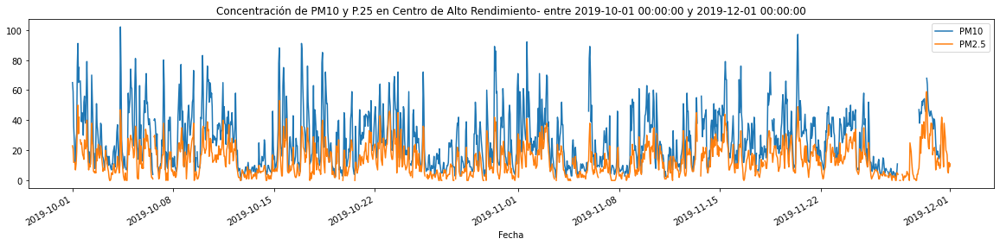

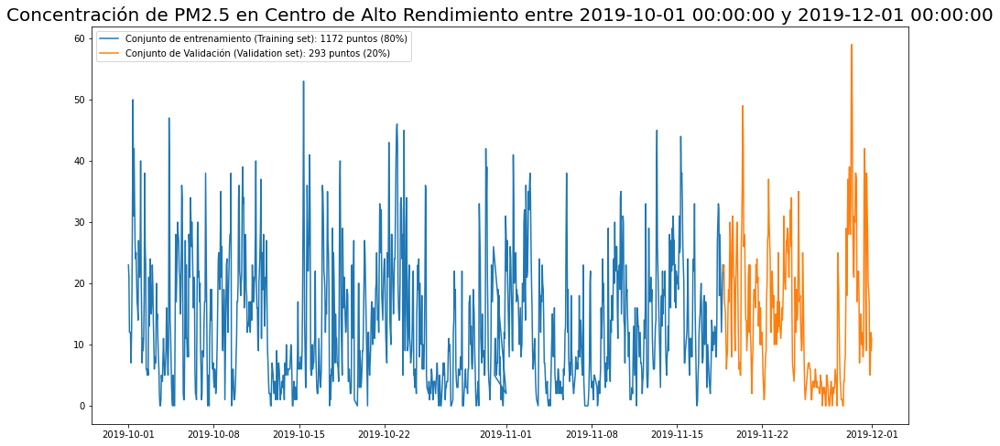

1465 = 1172 + 293
len y_test 268
Model: "sequential_33"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_36 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_37 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_33 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 3s 30ms/step - loss: 0.0296 - val_loss: 0.0230
Epoch 2/30
33/33 [==============================] - 0s 9ms/step - loss: 0.0258 - val_loss: 0.0230
Epoch 3/30
33/3

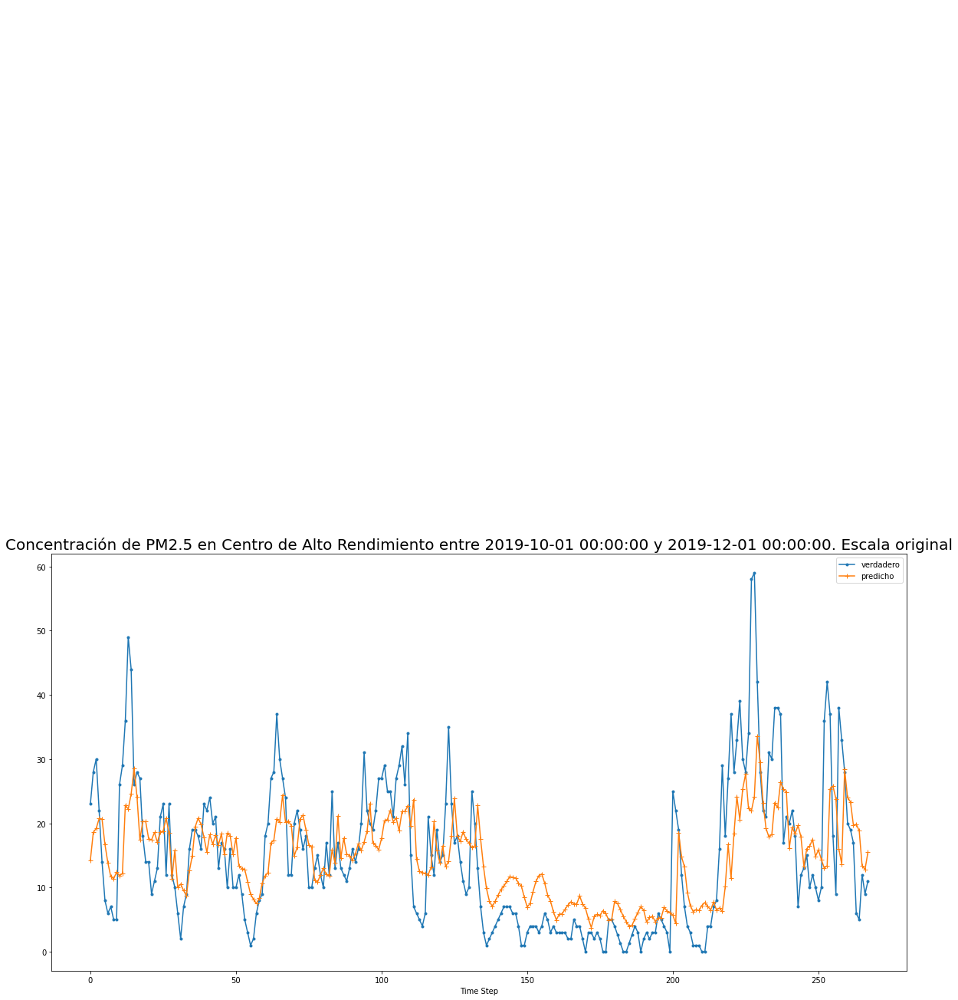

Error cuadratico medio: 8.438750895236538
1489
1489


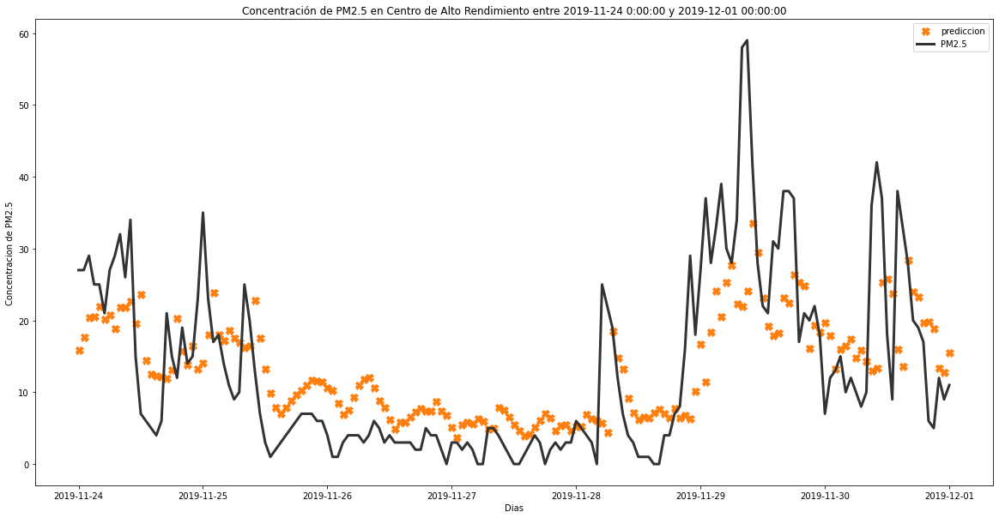

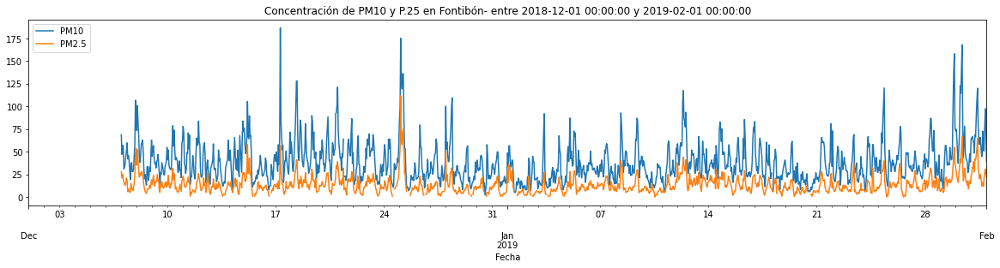

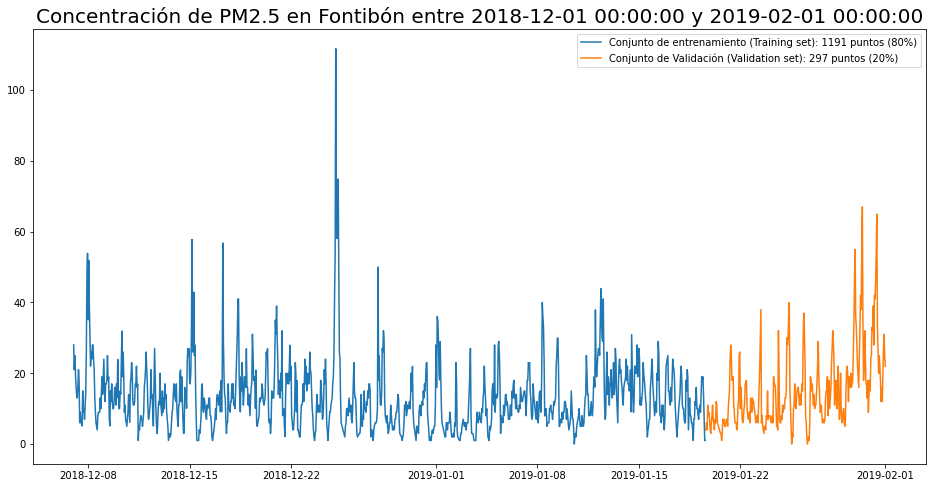

1489 = 1191 + 298
len y_test 273
Model: "sequential_35"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_38 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_39 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_35 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 36ms/step - loss: nan - val_loss: nan
Epoch 2/30
33/33 [==============================] - 0s 11ms/step - loss: nan - val_loss: nan
Epoch 3/30
33/33 [========

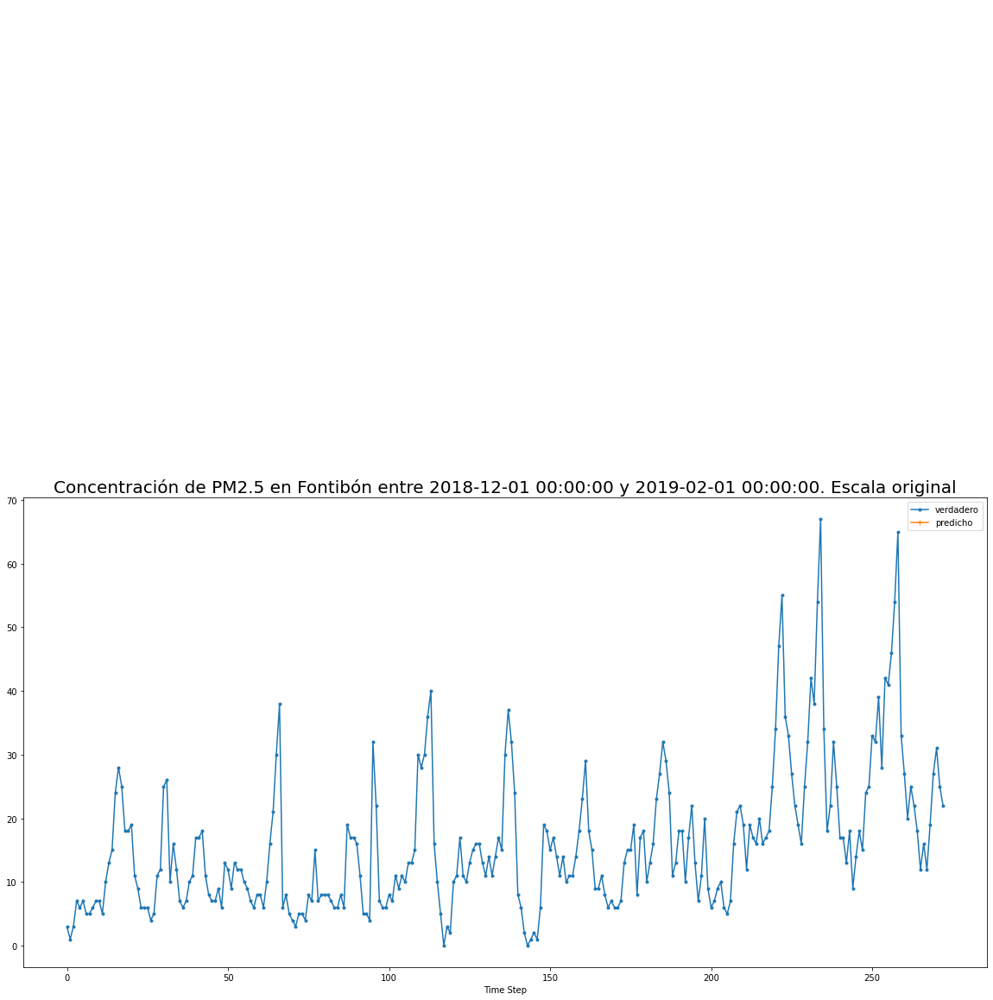

Error cuadratico medio: nan
1417
1417


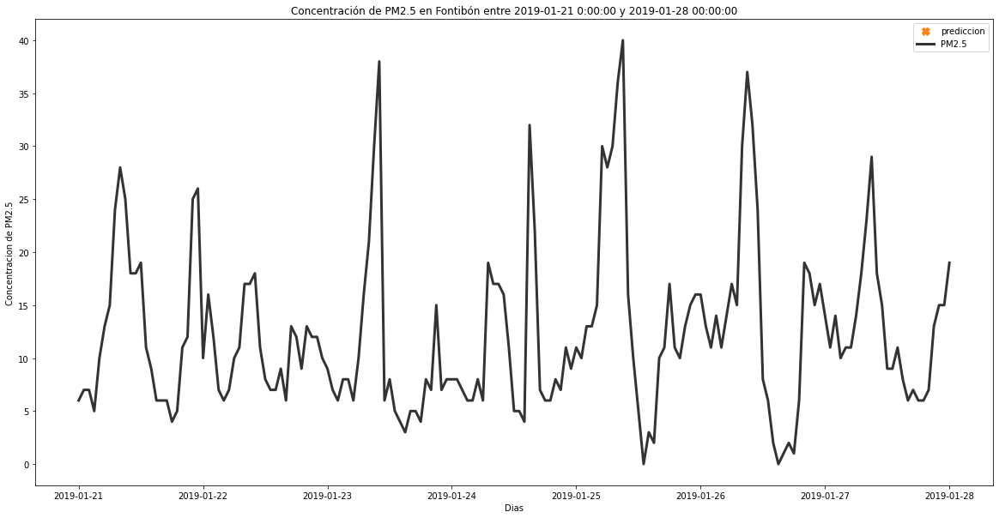

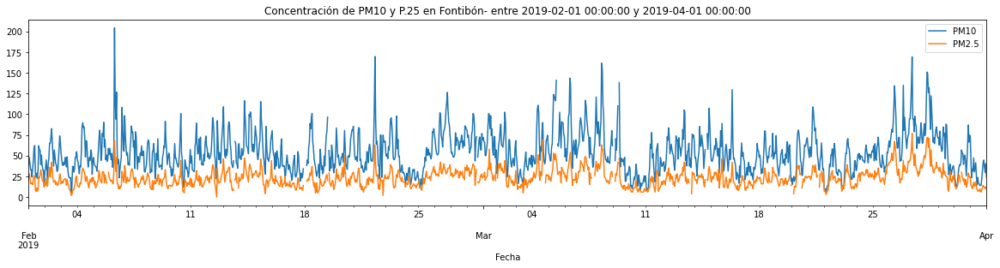

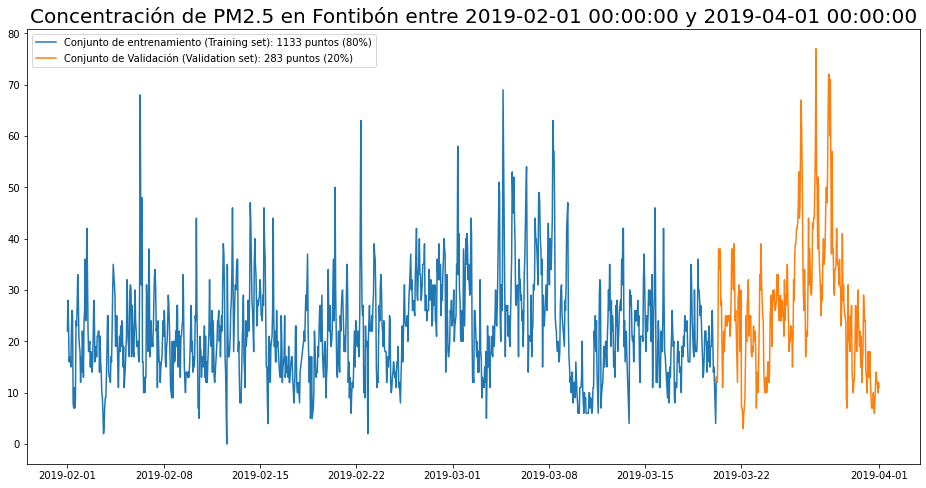

1417 = 1133 + 284
len y_test 259
Model: "sequential_37"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_40 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_41 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_37 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
32/32 [==============================] - 4s 35ms/step - loss: 0.0197 - val_loss: 0.0082
Epoch 2/30
32/32 [==============================] - 0s 10ms/step - loss: 0.0140 - val_loss: 0.0091
Epoch 3/30
32/

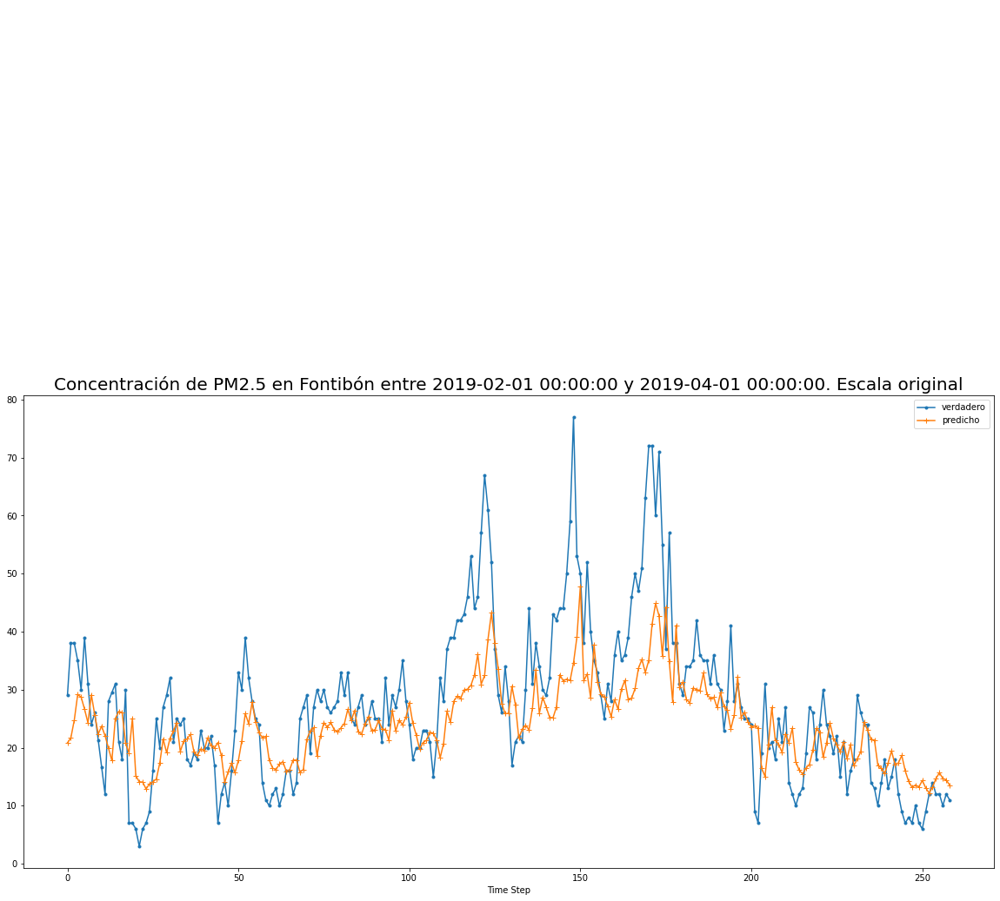

Error cuadratico medio: 9.832509735060933
1465
1465


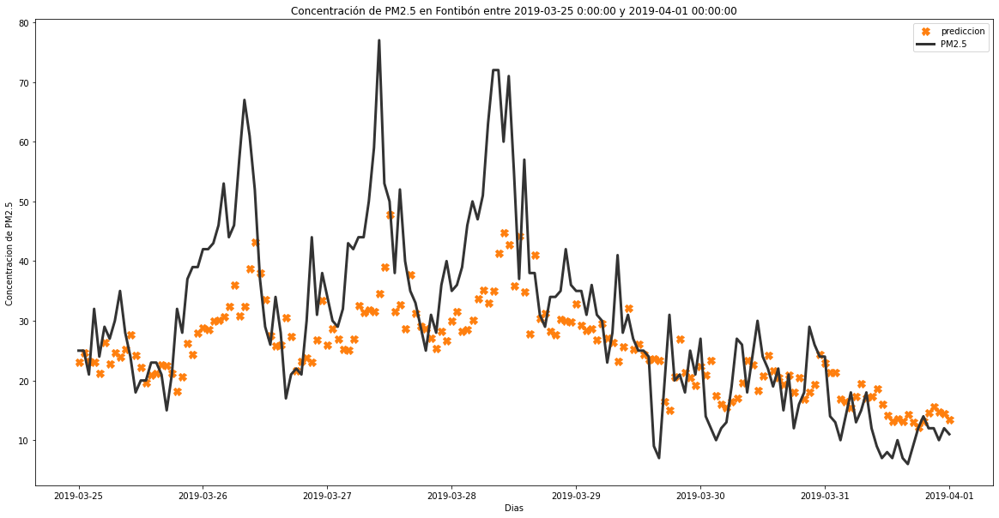

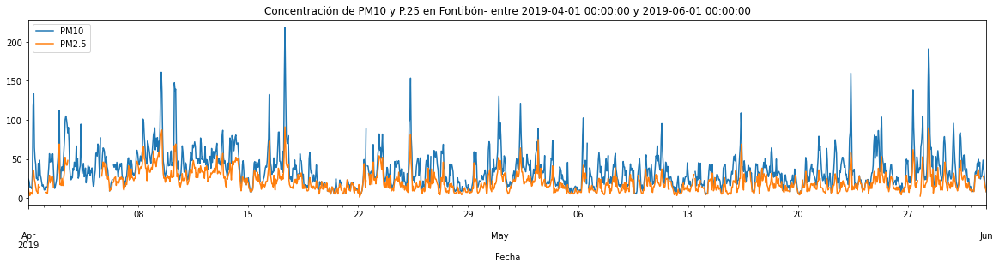

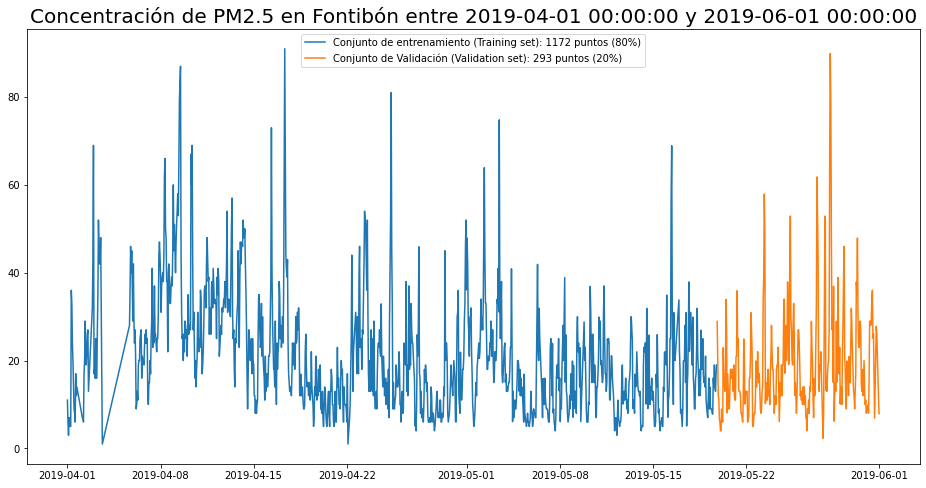

1465 = 1172 + 293
len y_test 268
Model: "sequential_39"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_42 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_43 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_39 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 3s 32ms/step - loss: 0.0189 - val_loss: 0.0121
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0164 - val_loss: 0.0120
Epoch 3/30
33/

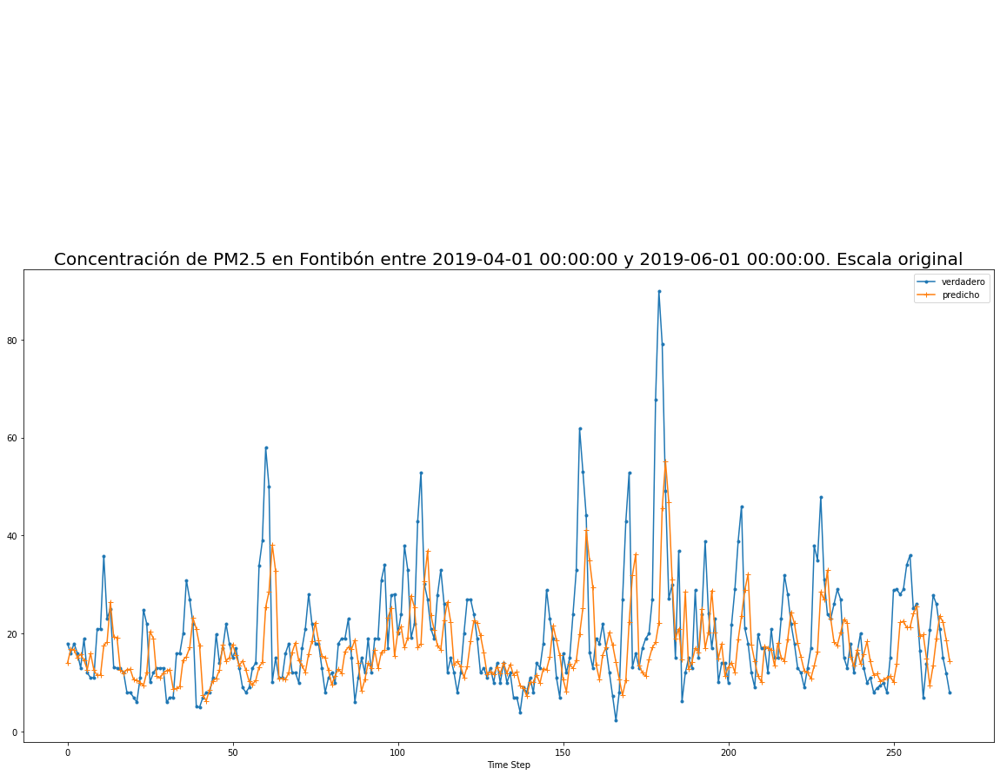

Error cuadratico medio: 11.544046432872298
1465
1465


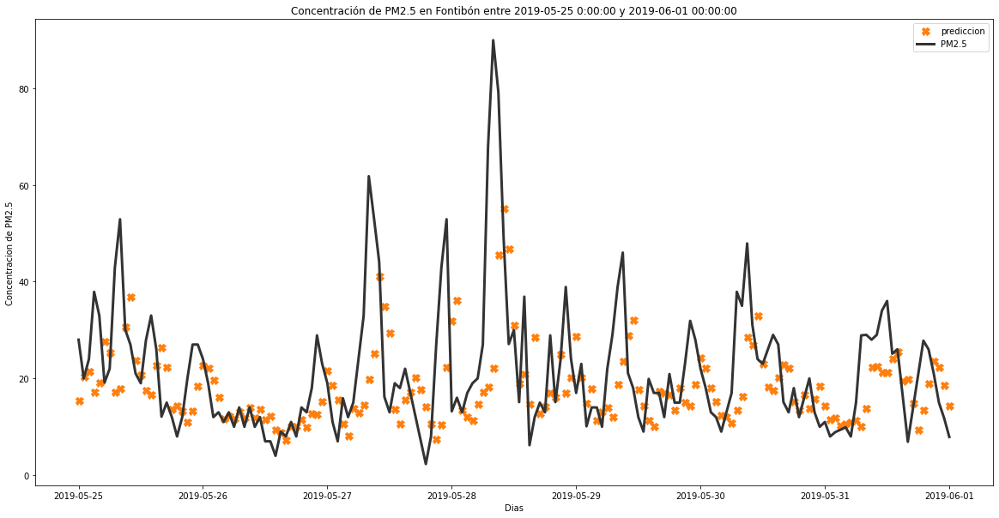

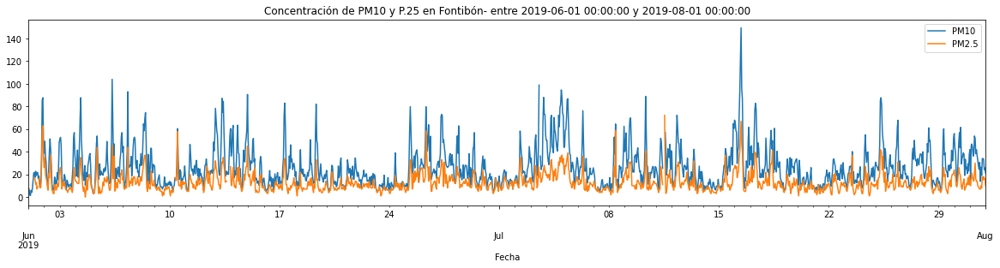

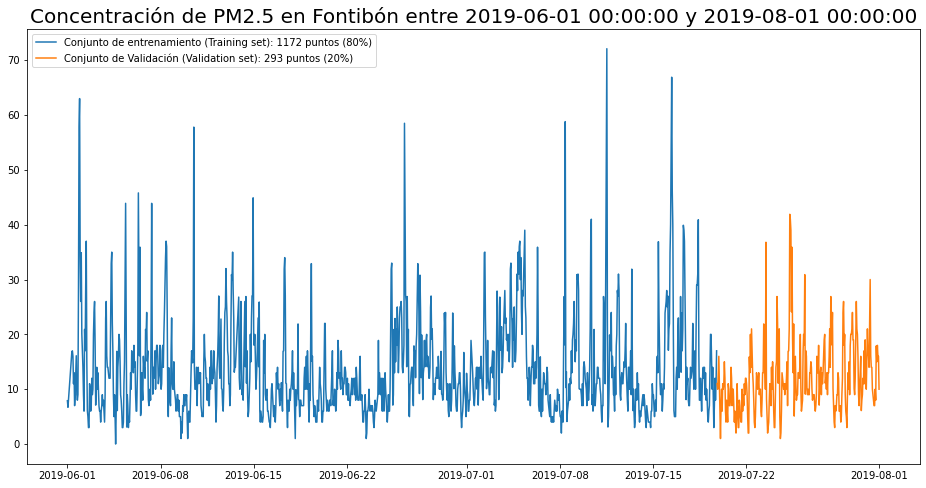

1465 = 1172 + 293
len y_test 268
Model: "sequential_41"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_44 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_45 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_41 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 35ms/step - loss: 0.0147 - val_loss: 0.0253
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0130 - val_loss: 0.0244
Epoch 3/30
33/

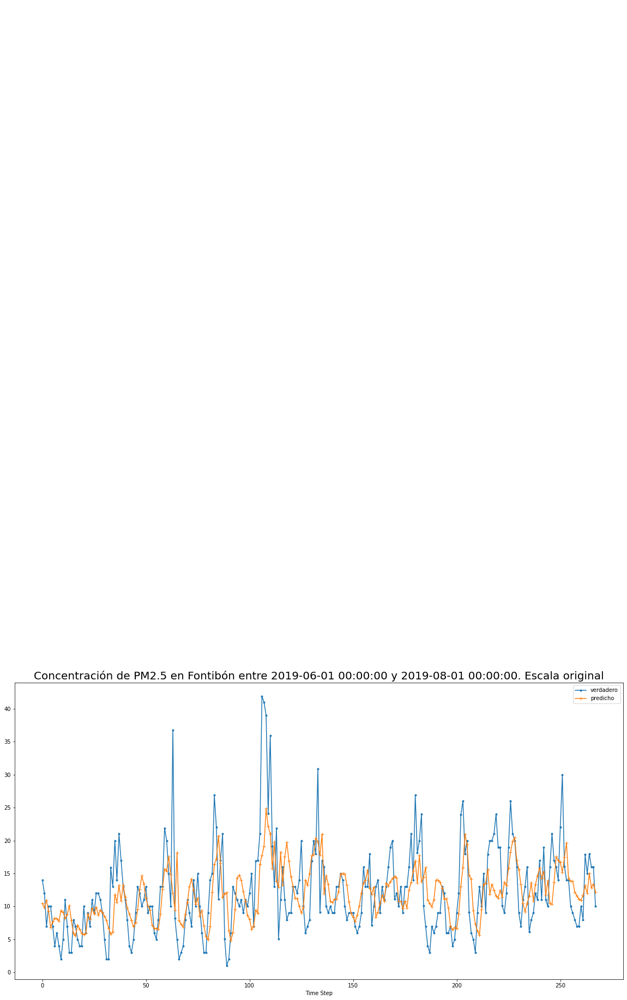

Error cuadratico medio: 5.5532663752739495
1465
1465


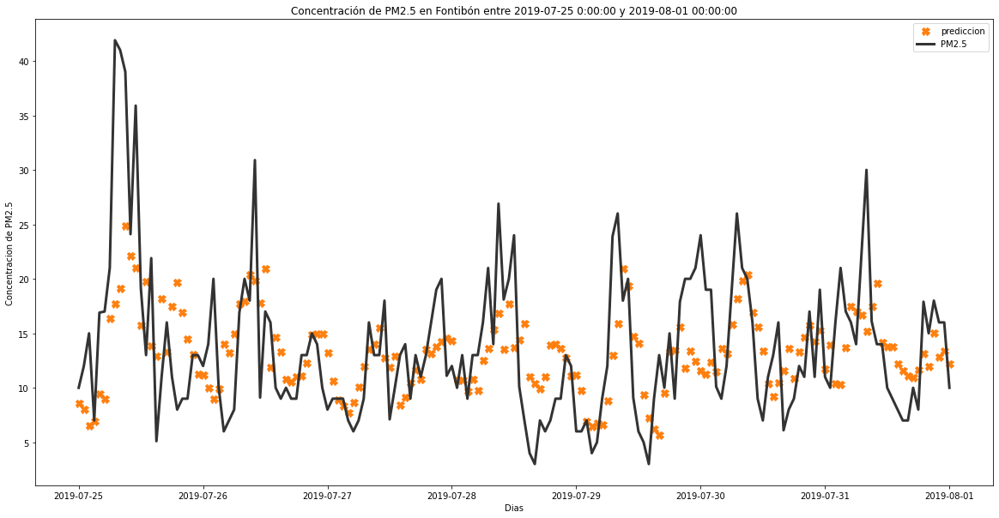

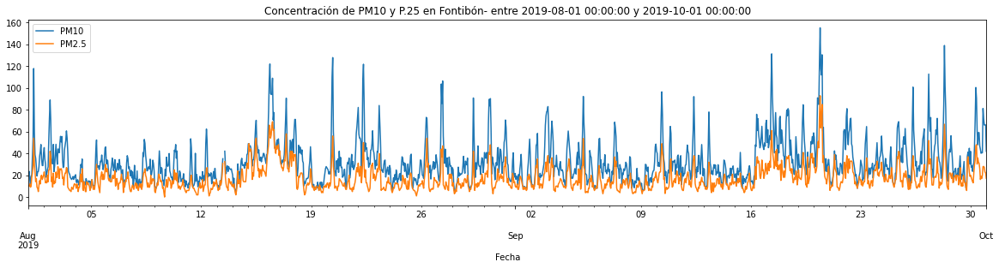

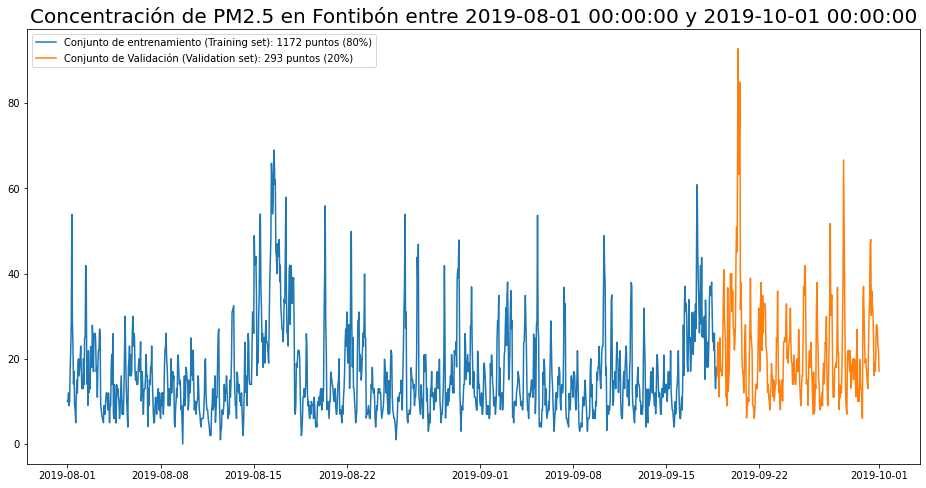

1465 = 1172 + 293
len y_test 268
Model: "sequential_43"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_46 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_47 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_43 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 37ms/step - loss: 0.0158 - val_loss: 0.0094
Epoch 2/30
33/33 [==============================] - 0s 11ms/step - loss: 0.0108 - val_loss: 0.0102
Epoch 3/30
33/

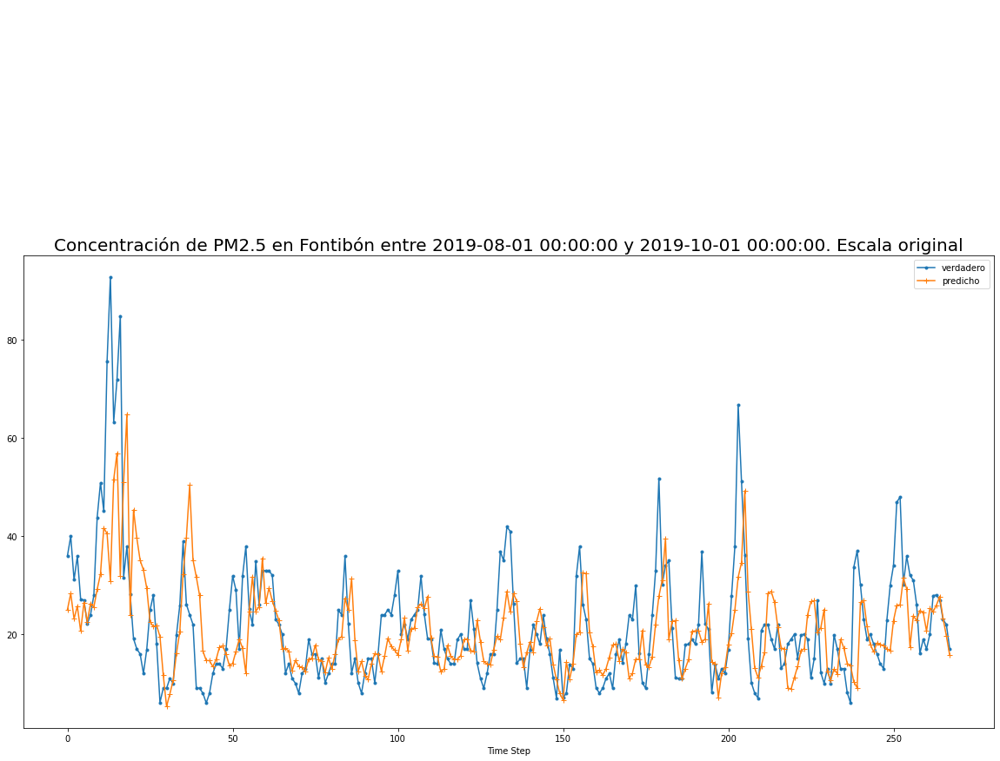

Error cuadratico medio: 10.646599564436384
1465
1465


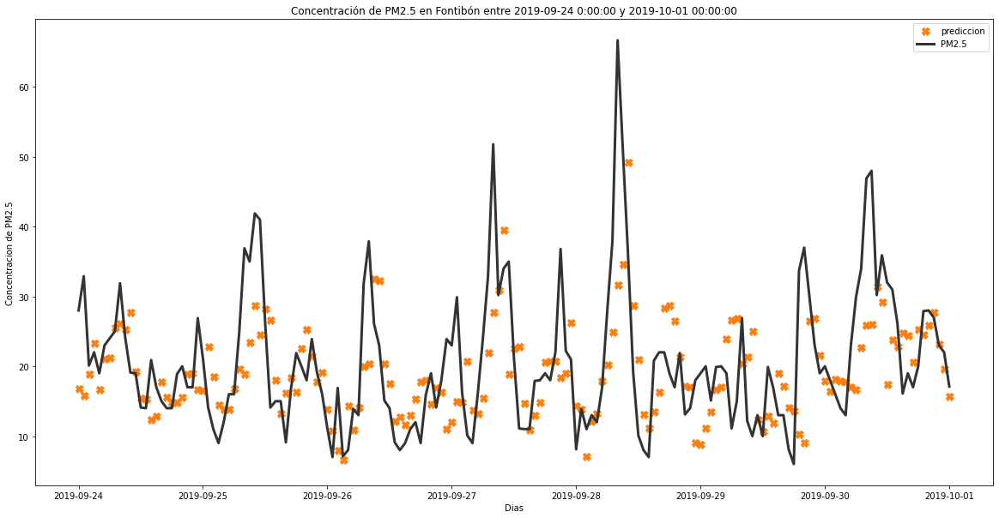

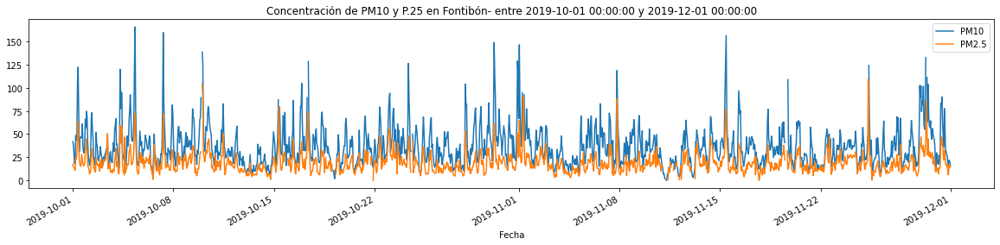

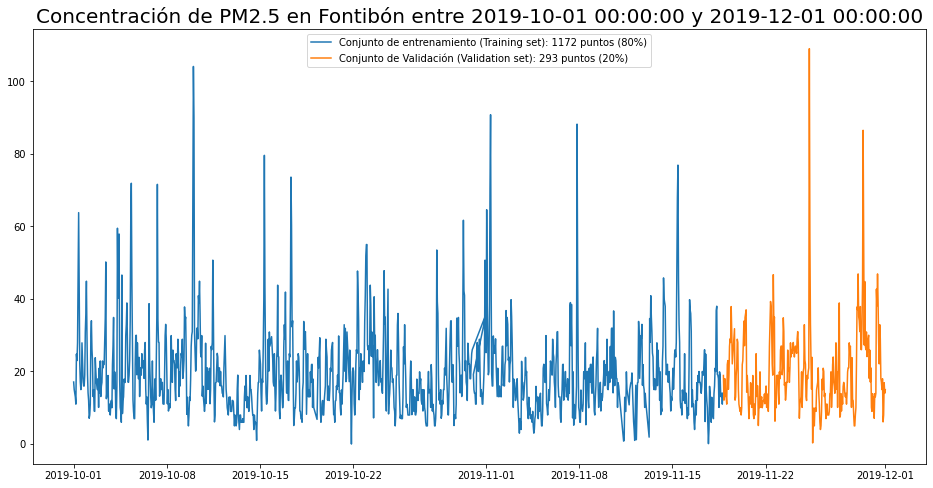

1465 = 1172 + 293
len y_test 268
Model: "sequential_45"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_48 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_49 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_45 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 35ms/step - loss: 0.0130 - val_loss: 0.0126
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0113 - val_loss: 0.0130
Epoch 3/30
33/

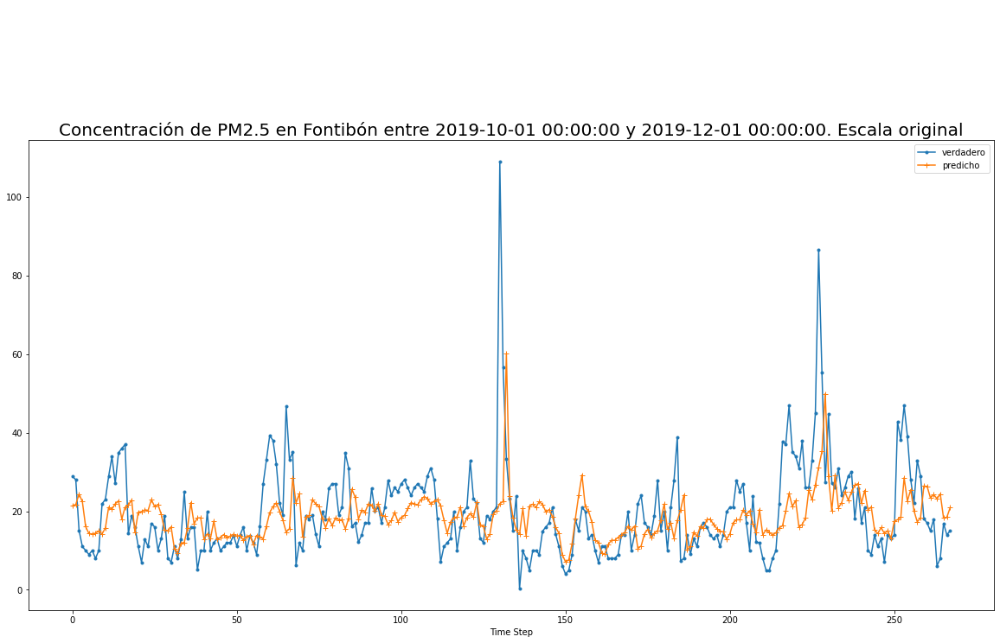

Error cuadratico medio: 11.078462554613214
1489
1489


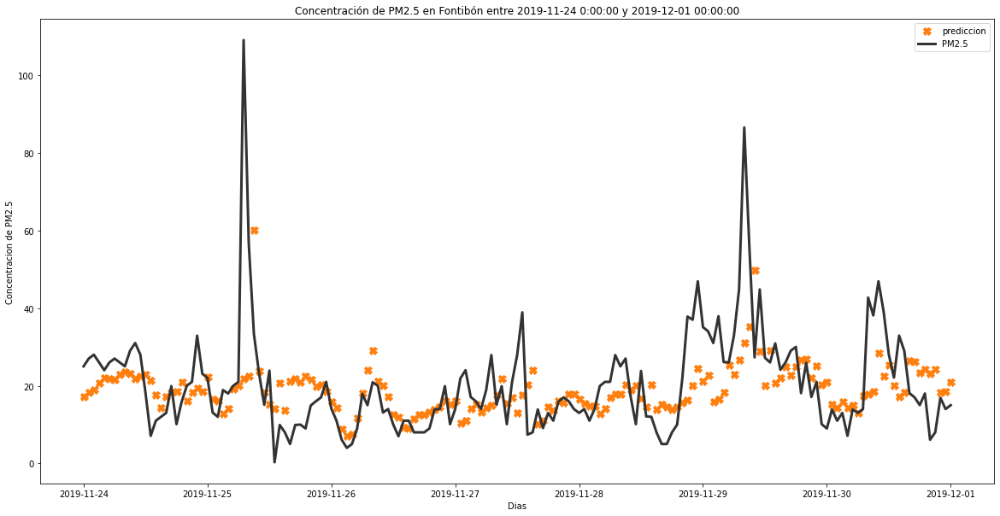

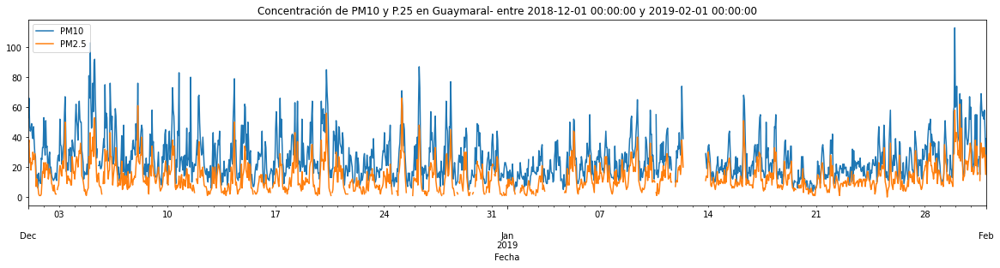

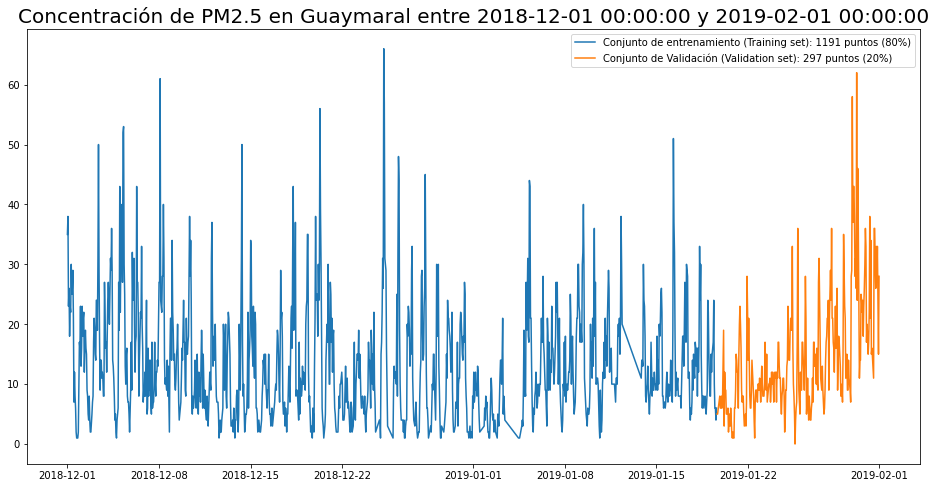

1489 = 1191 + 298
len y_test 273
Model: "sequential_47"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_50 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_51 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_47 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 35ms/step - loss: 0.0231 - val_loss: 0.0142
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0174 - val_loss: 0.0131
Epoch 3/30
33/

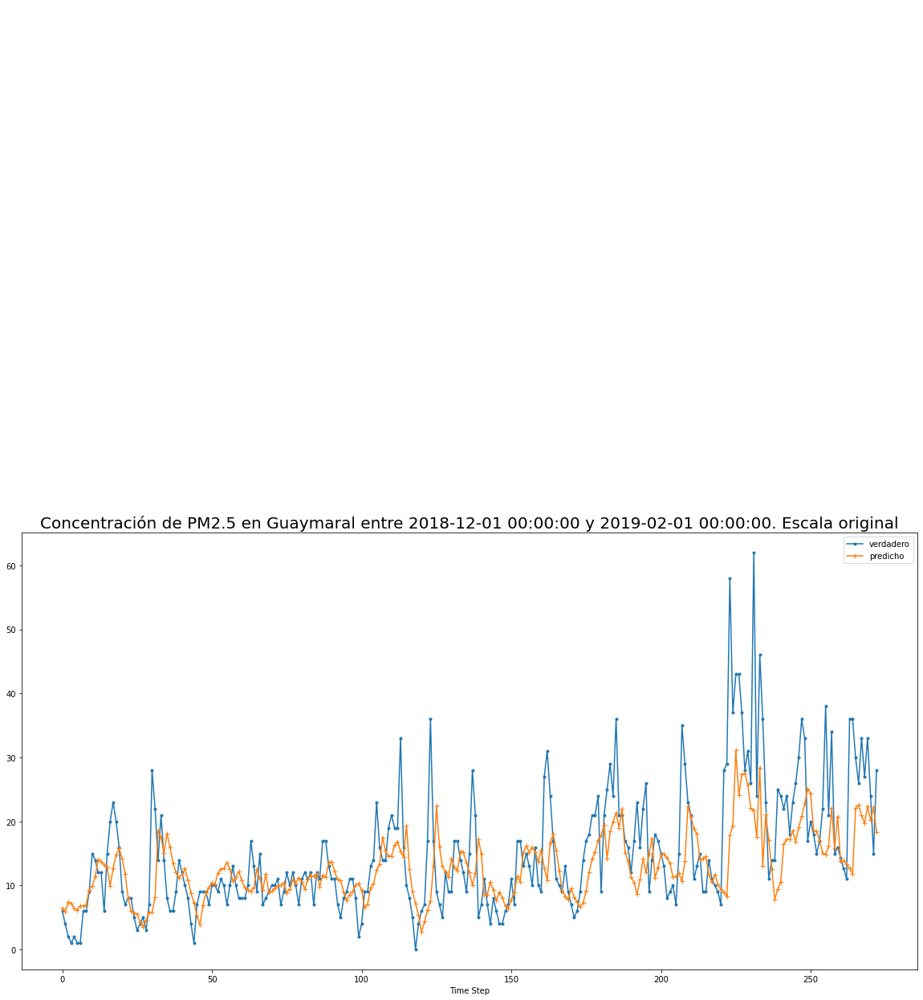

Error cuadratico medio: 8.136005342254375
1417
1417


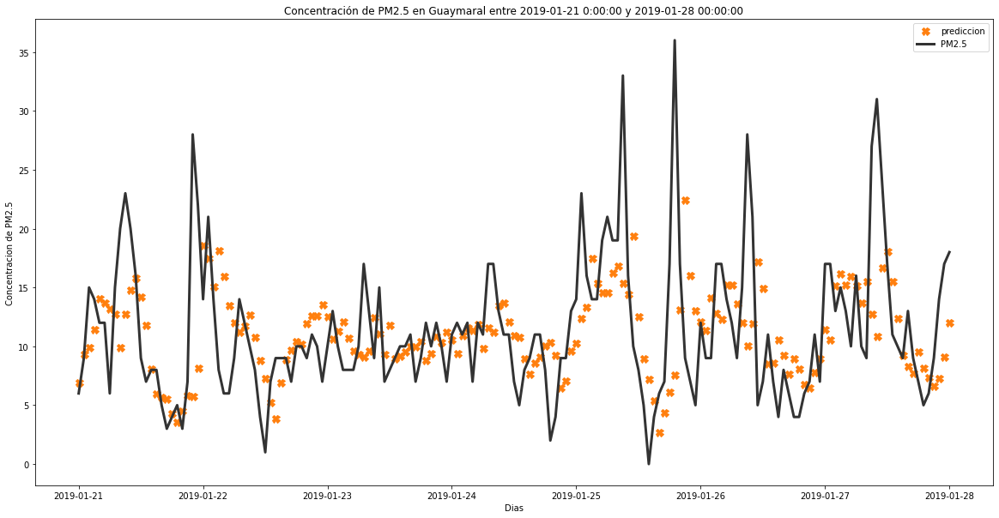

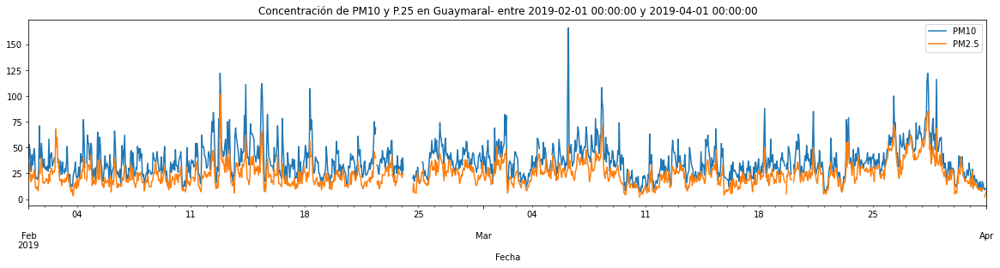

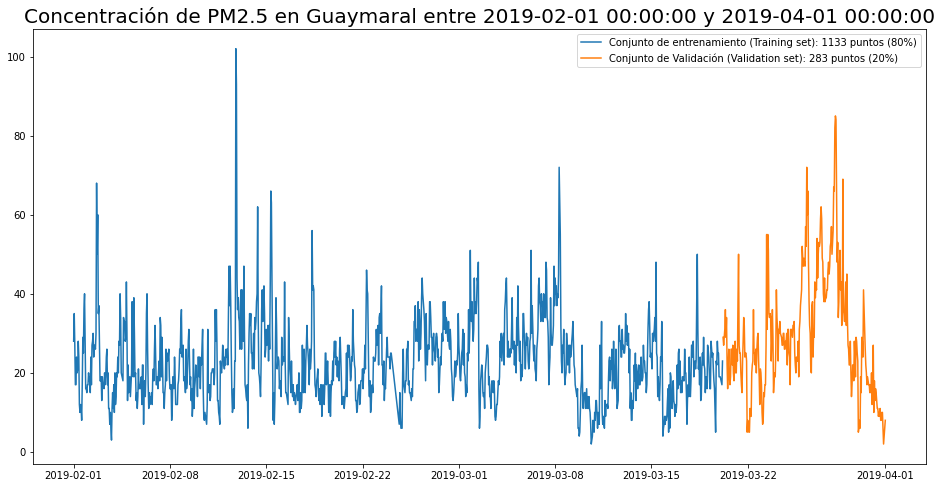

1417 = 1133 + 284
len y_test 259
Model: "sequential_49"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_52 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_53 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_49 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
32/32 [==============================] - 4s 36ms/step - loss: 0.0129 - val_loss: 0.0049
Epoch 2/30
32/32 [==============================] - 0s 10ms/step - loss: 0.0102 - val_loss: 0.0048
Epoch 3/30
32/

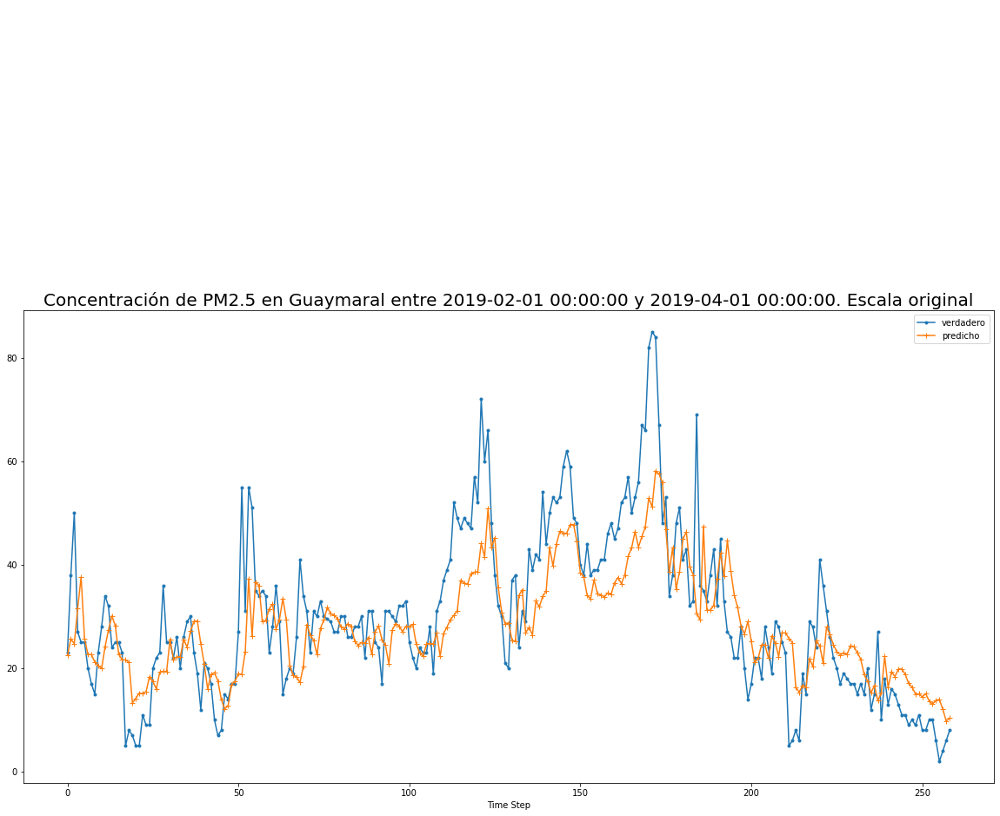

Error cuadratico medio: 9.97379568485281
1465
1465


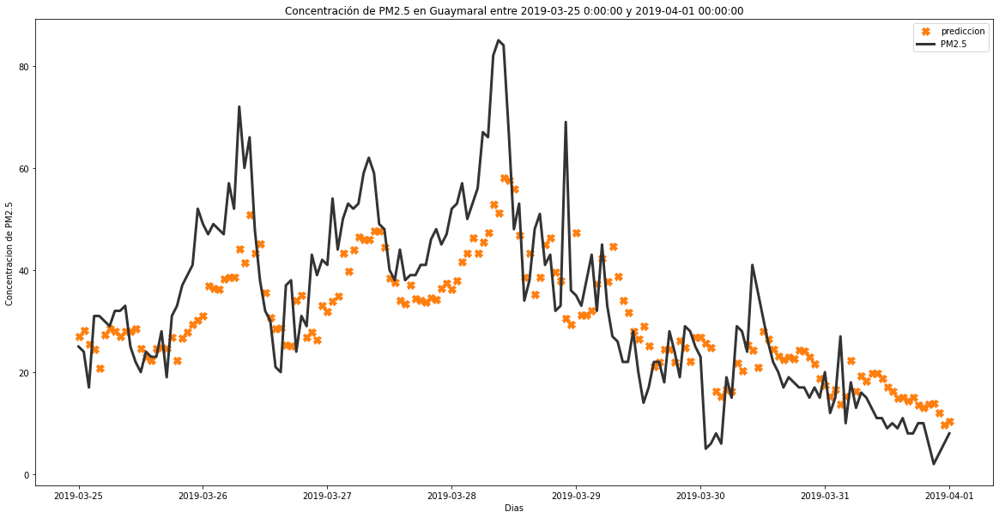

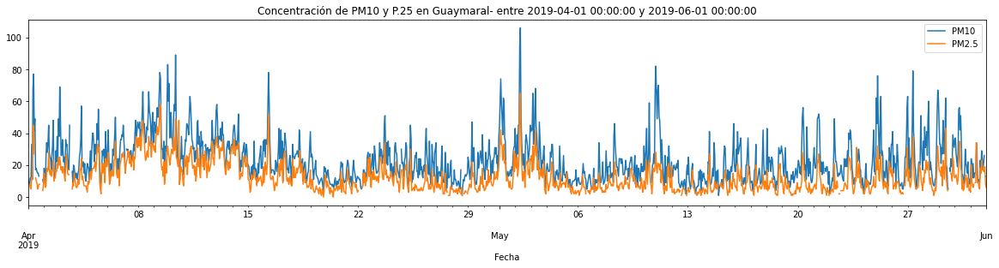

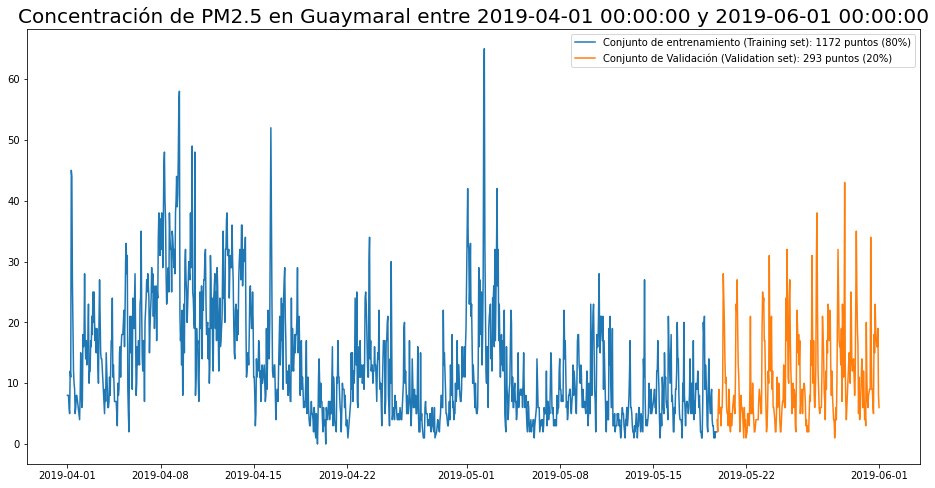

1465 = 1172 + 293
len y_test 268
Model: "sequential_51"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_54 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_55 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_51 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 34ms/step - loss: 0.0170 - val_loss: 0.0065
Epoch 2/30
33/33 [==============================] - 0s 9ms/step - loss: 0.0137 - val_loss: 0.0067
Epoch 3/30
33/3

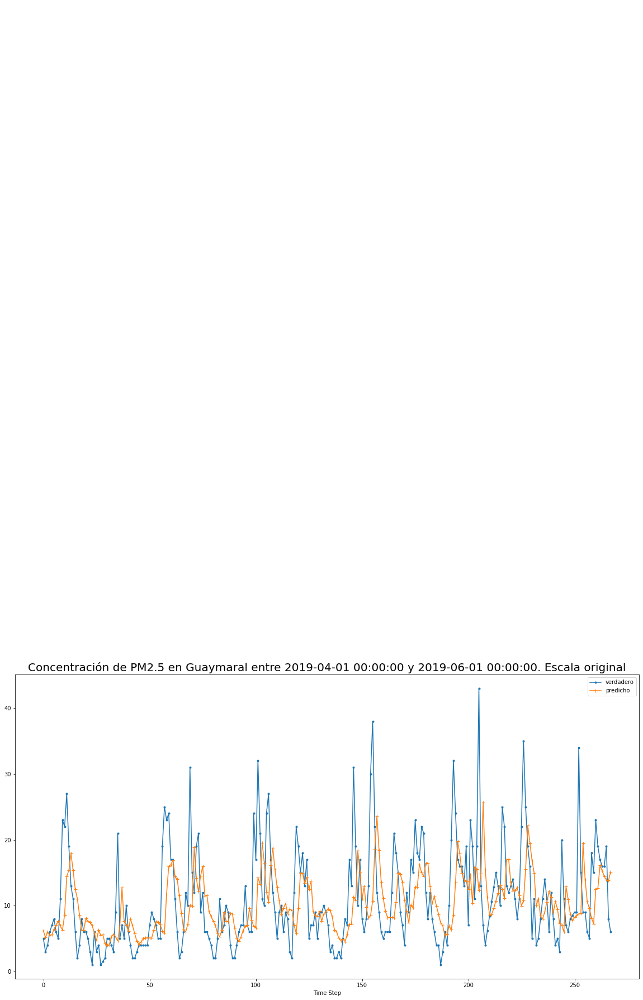

Error cuadratico medio: 7.36701476492093
1465
1465


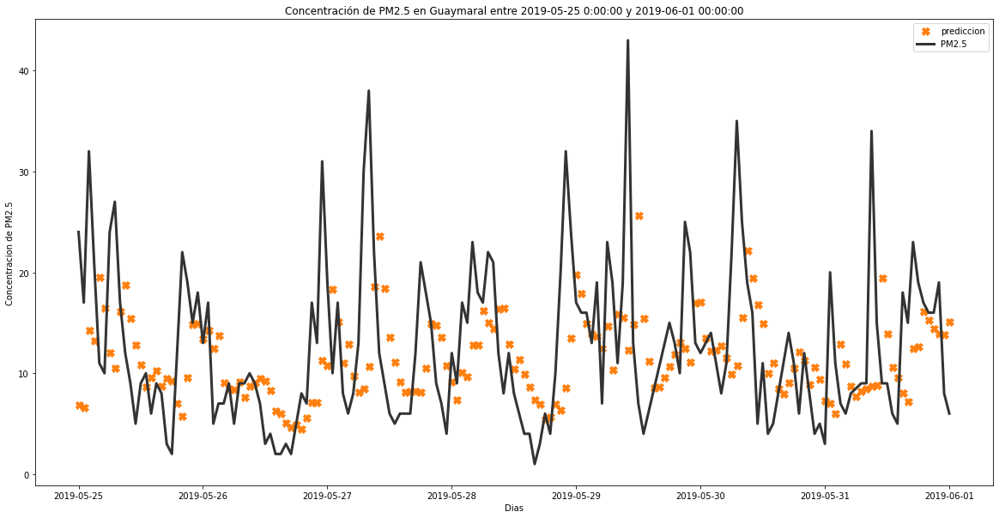

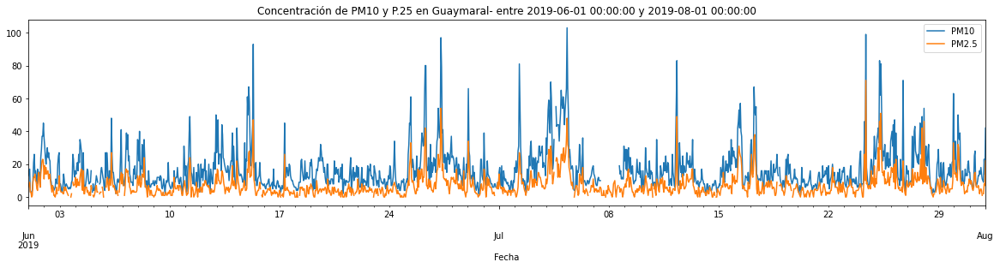

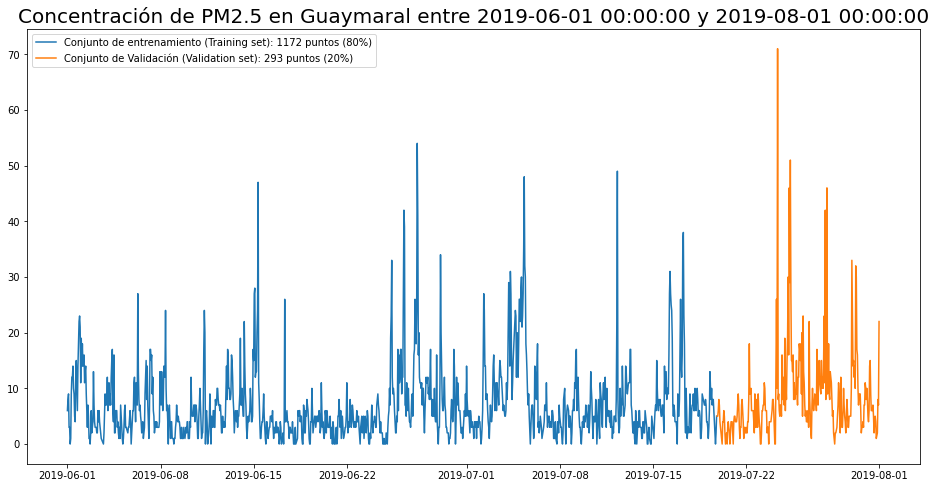

1465 = 1172 + 293
len y_test 268
Model: "sequential_53"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_56 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_57 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_53 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 35ms/step - loss: 0.0079 - val_loss: 0.0103
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0071 - val_loss: 0.0093
Epoch 3/30
33/

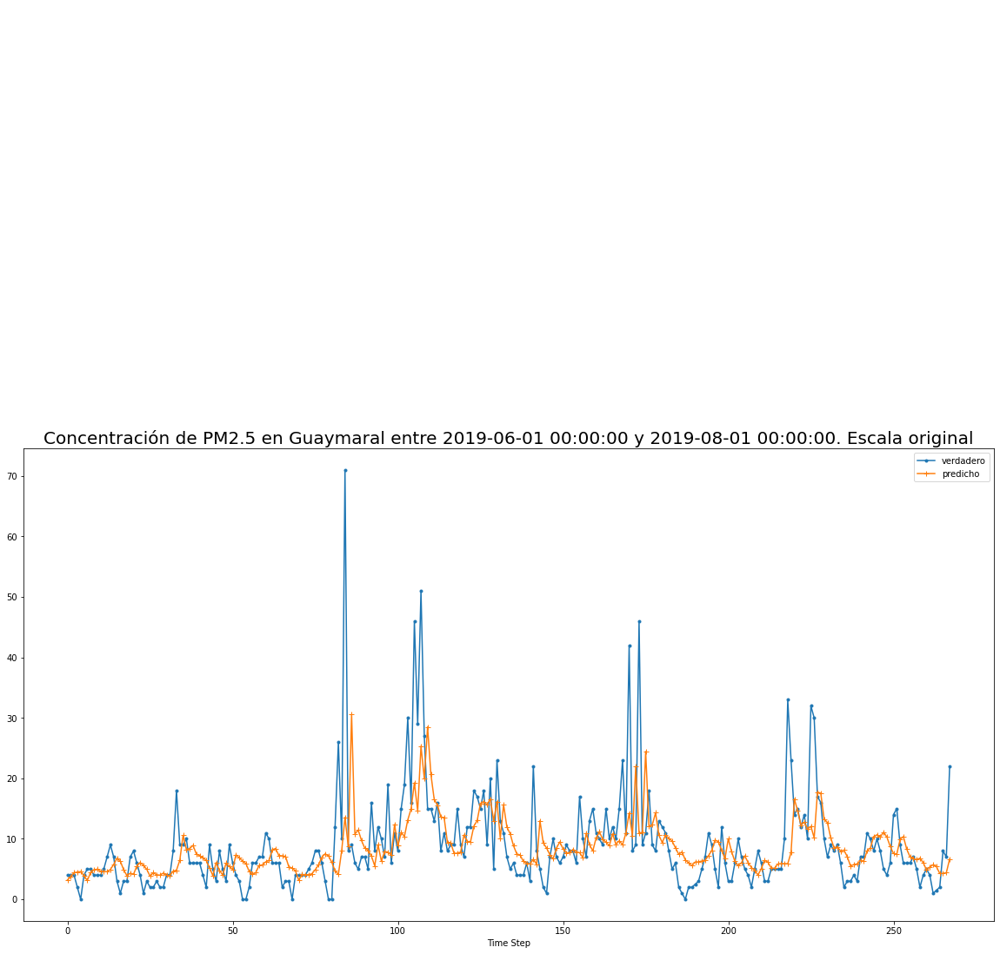

Error cuadratico medio: 7.347724847763967
1465
1465


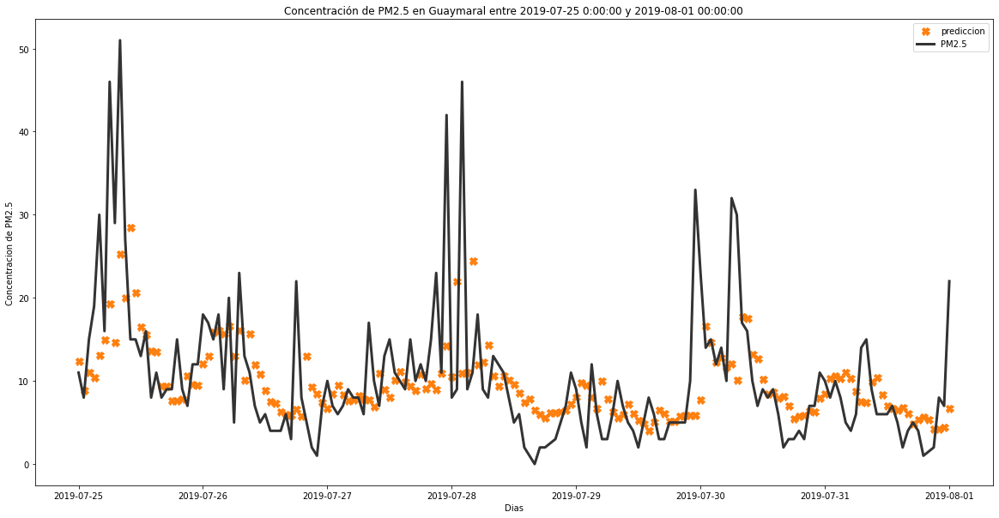

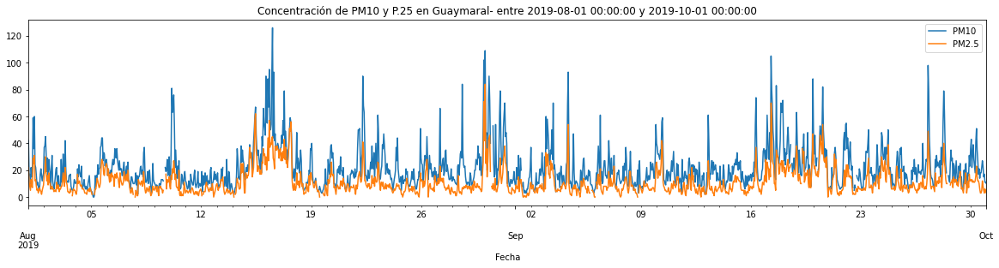

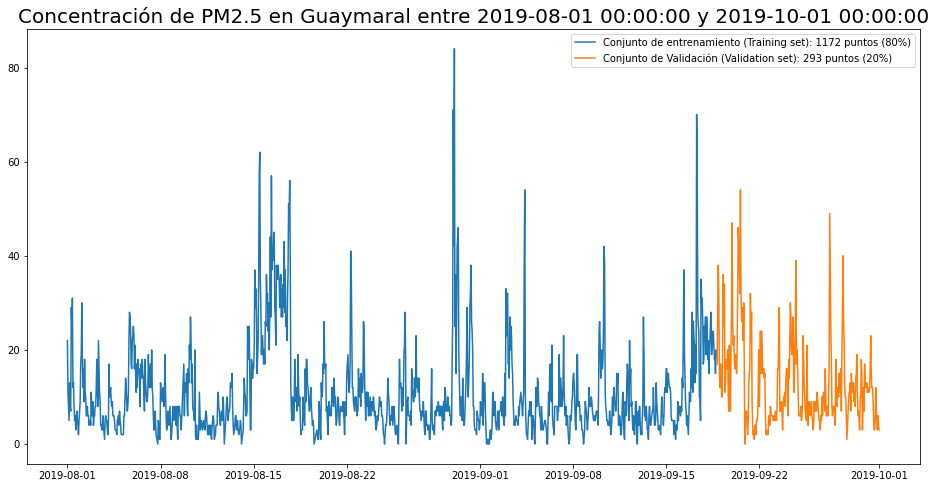

1465 = 1172 + 293
len y_test 268
Model: "sequential_55"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_58 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_59 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_55 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 36ms/step - loss: 0.0142 - val_loss: 0.0148
Epoch 2/30
33/33 [==============================] - 0s 11ms/step - loss: 0.0100 - val_loss: 0.0137
Epoch 3/30
33/

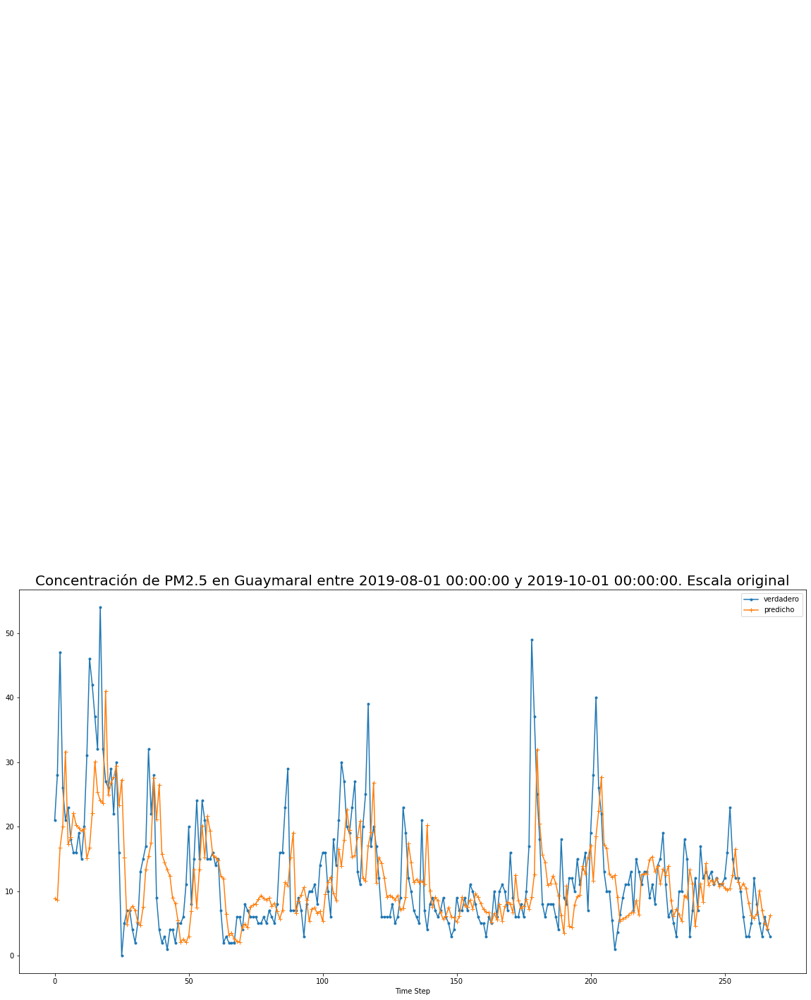

Error cuadratico medio: 8.092660253812202
1465
1465


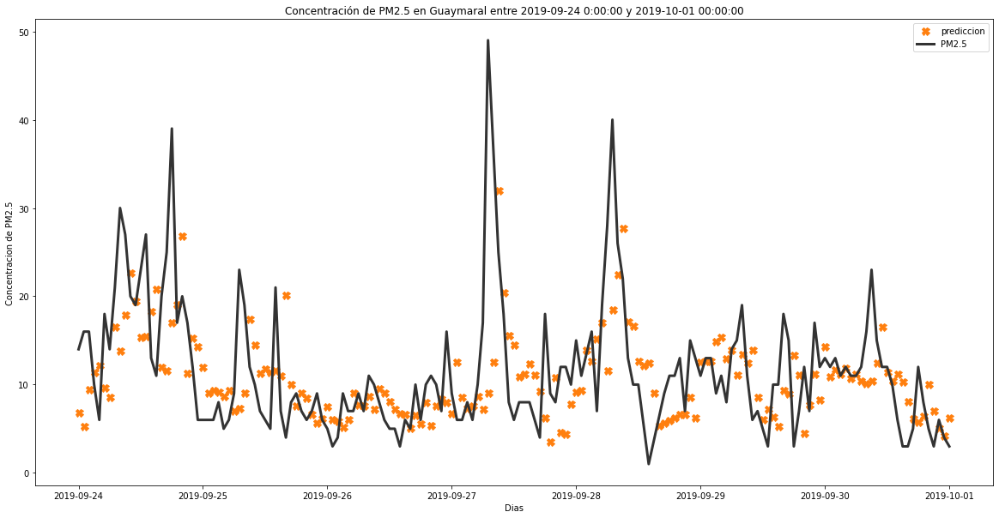

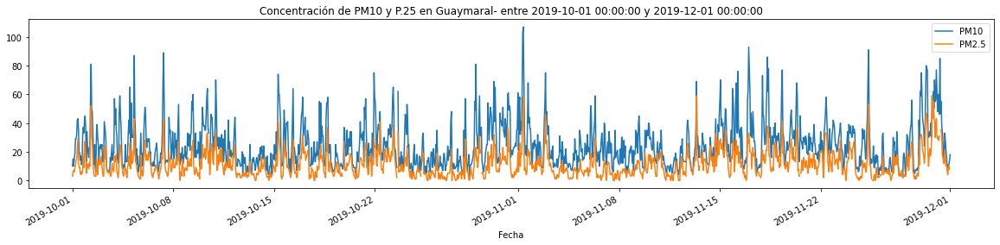

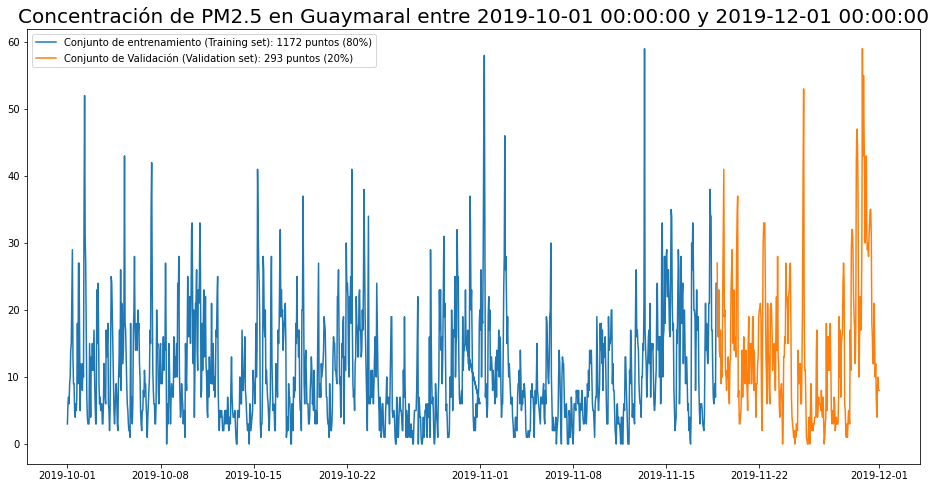

1465 = 1172 + 293
len y_test 268
Model: "sequential_57"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_60 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_61 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_57 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 36ms/step - loss: 0.0203 - val_loss: 0.0290
Epoch 2/30
33/33 [==============================] - 0s 11ms/step - loss: 0.0175 - val_loss: 0.0316
Epoch 3/30
33/

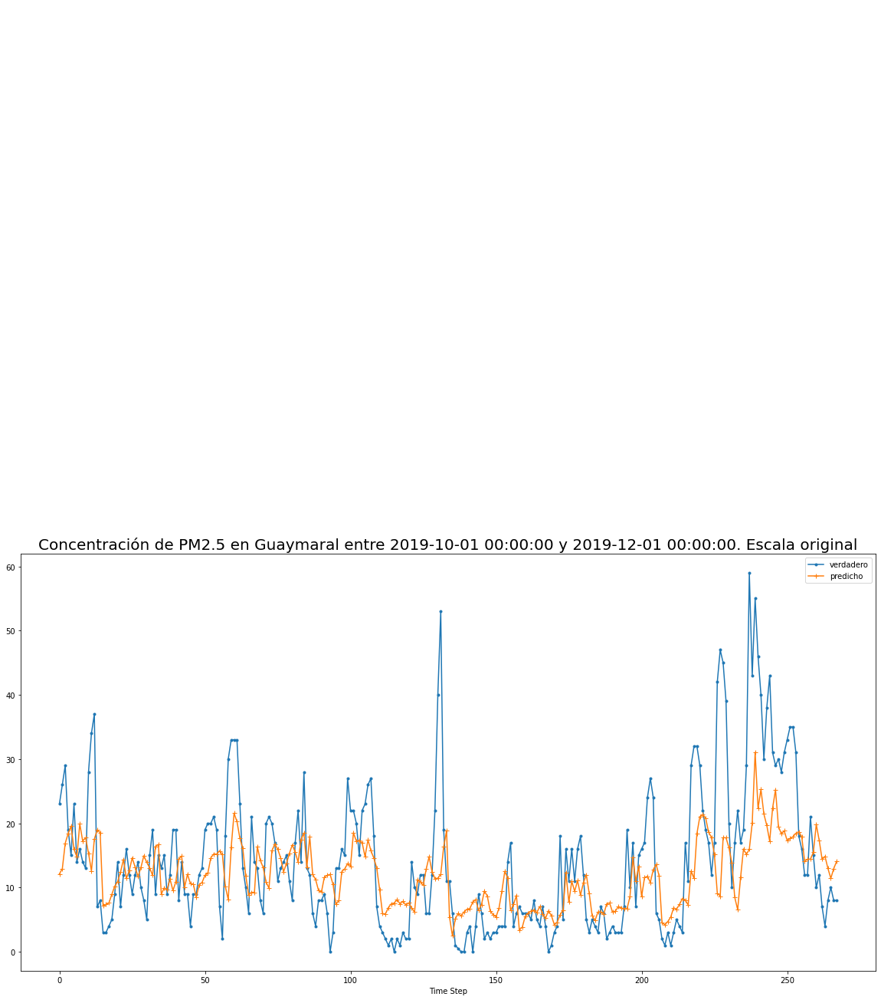

Error cuadratico medio: 9.366242737693273
1489
1489


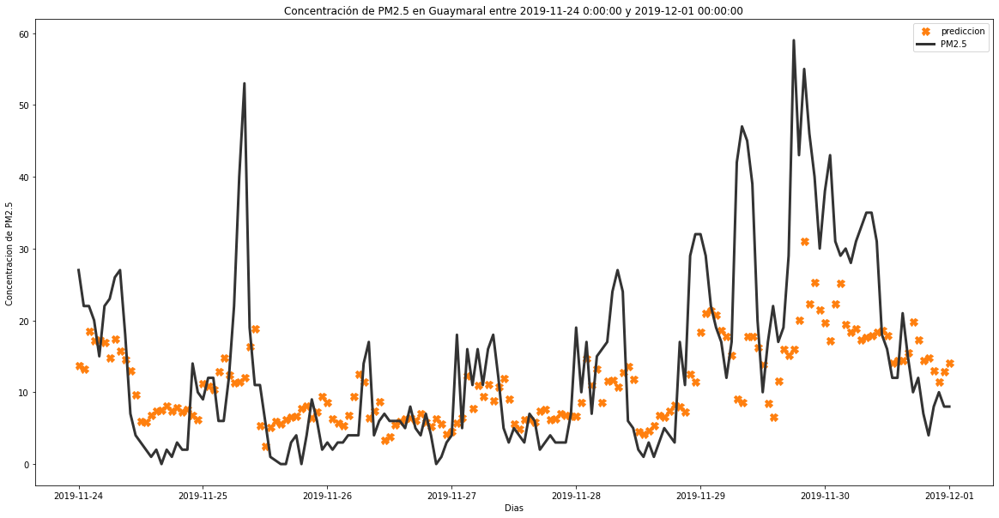

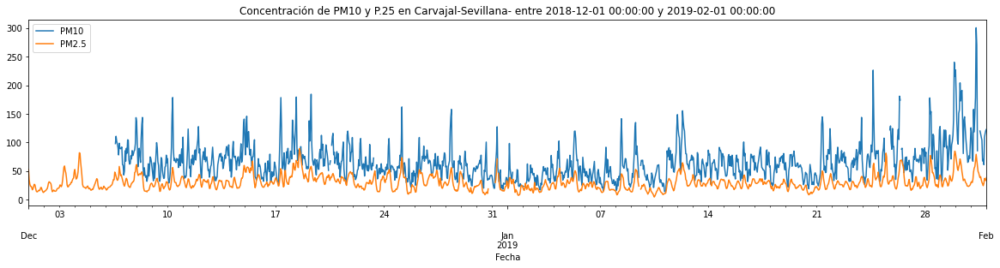

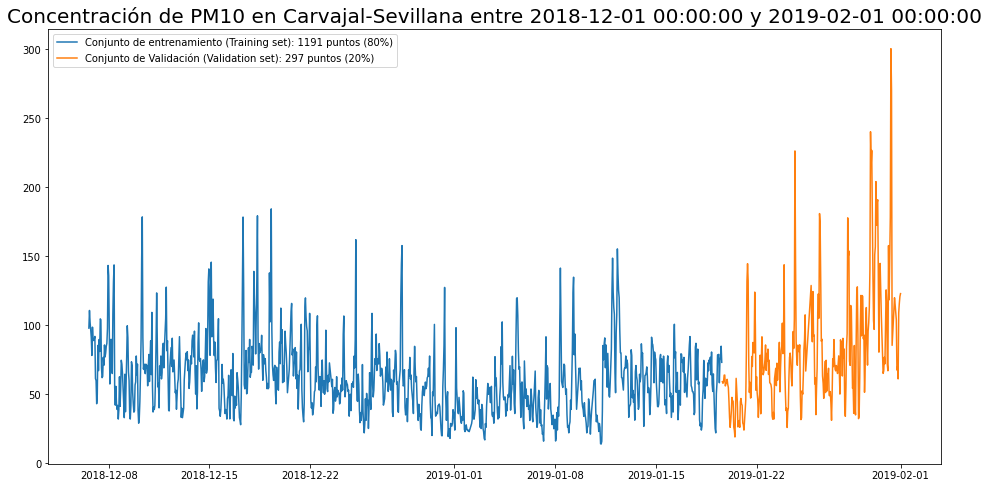

1489 = 1191 + 298
len y_test 273
Model: "sequential_59"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_62 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_63 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_59 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 35ms/step - loss: nan - val_loss: nan
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: nan - val_loss: nan
Epoch 3/30
33/33 [========

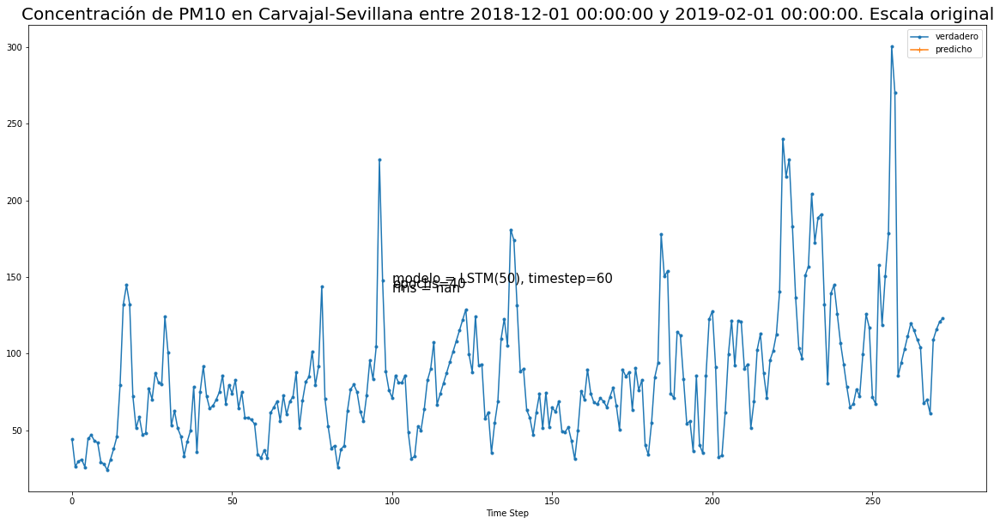

Error cuadratico medio: nan
1417
1417


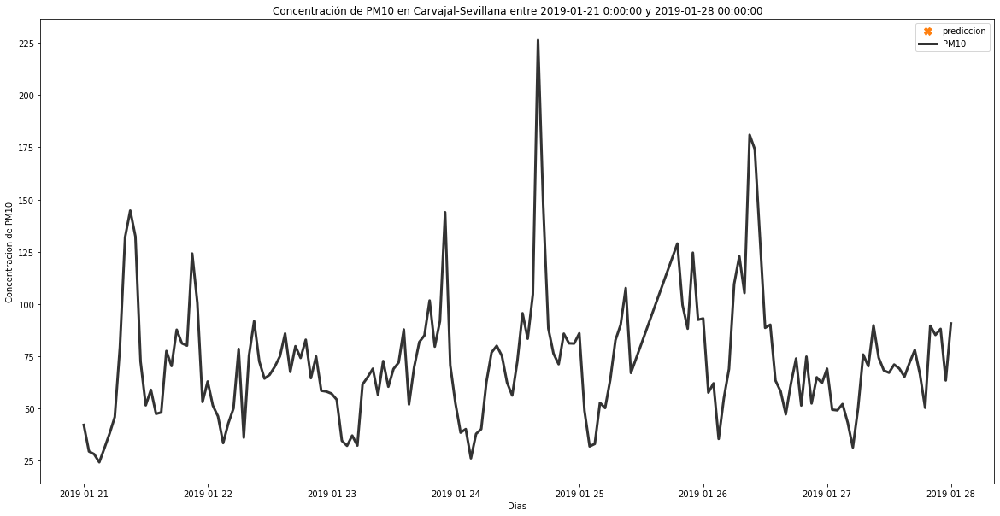

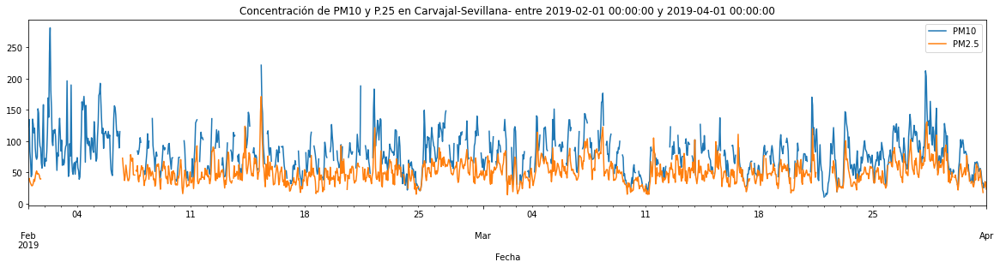

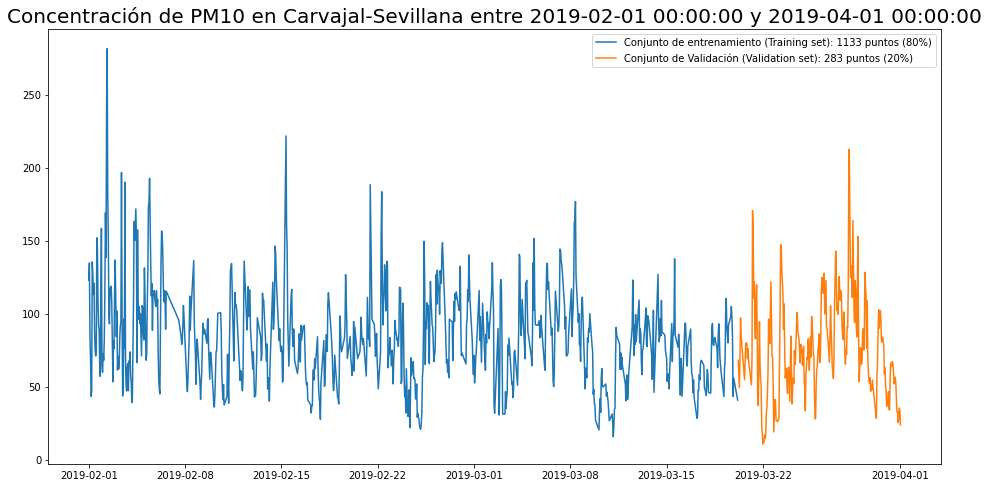

1417 = 1133 + 284
len y_test 259
Model: "sequential_61"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_64 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_65 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_61 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
32/32 [==============================] - 4s 35ms/step - loss: 0.0215 - val_loss: 0.0046
Epoch 2/30
32/32 [==============================] - 0s 10ms/step - loss: 0.0124 - val_loss: 0.0059
Epoch 3/30
32/

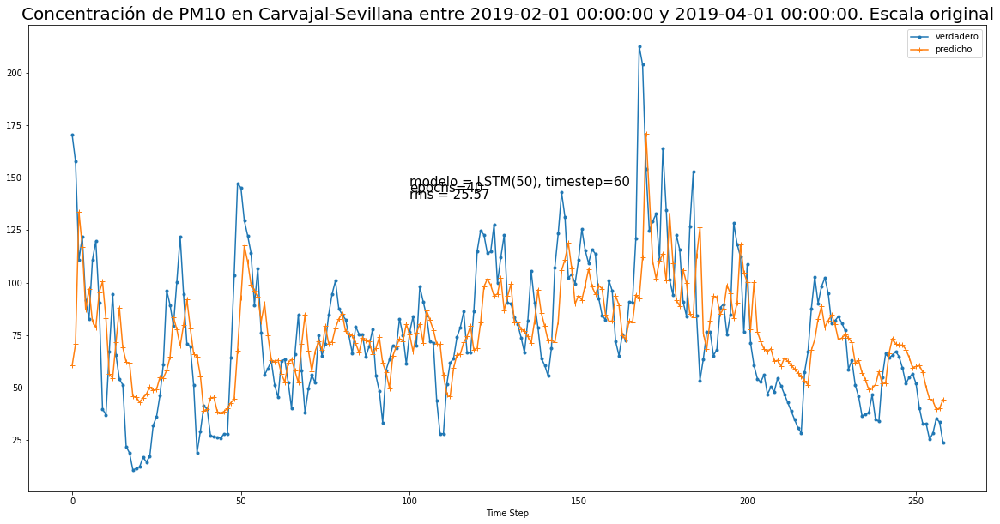

Error cuadratico medio: 25.567811466570593
1465
1465


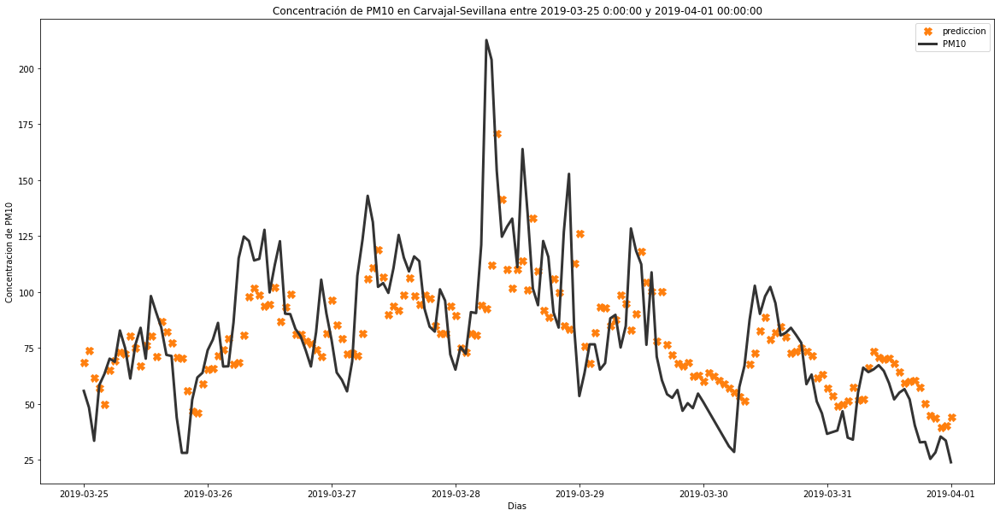

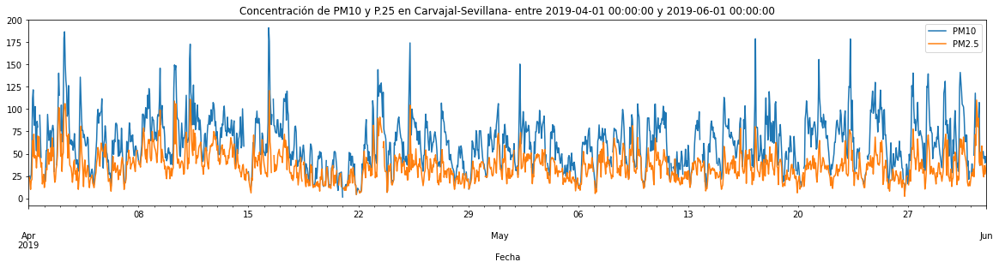

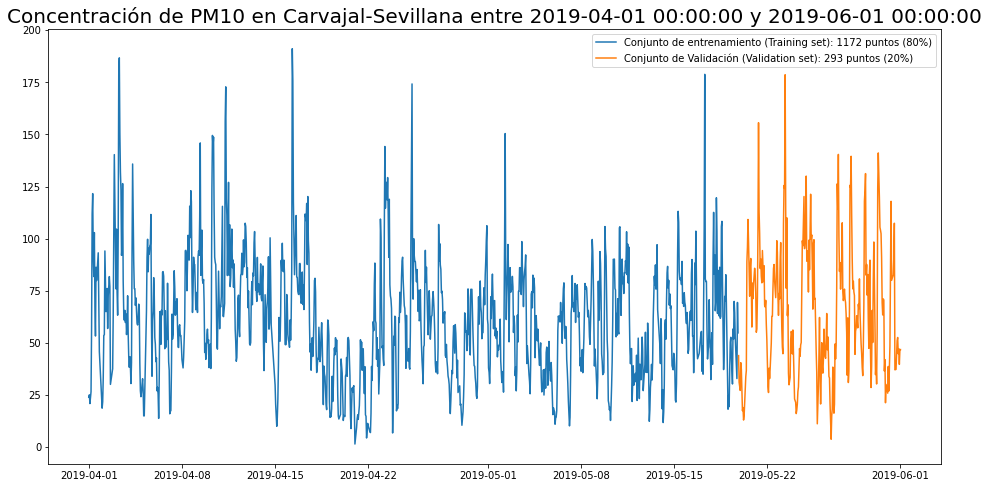

1465 = 1172 + 293
len y_test 268
Model: "sequential_63"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_66 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_67 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_63 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 35ms/step - loss: 0.0271 - val_loss: 0.0180
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0188 - val_loss: 0.0195
Epoch 3/30
33/

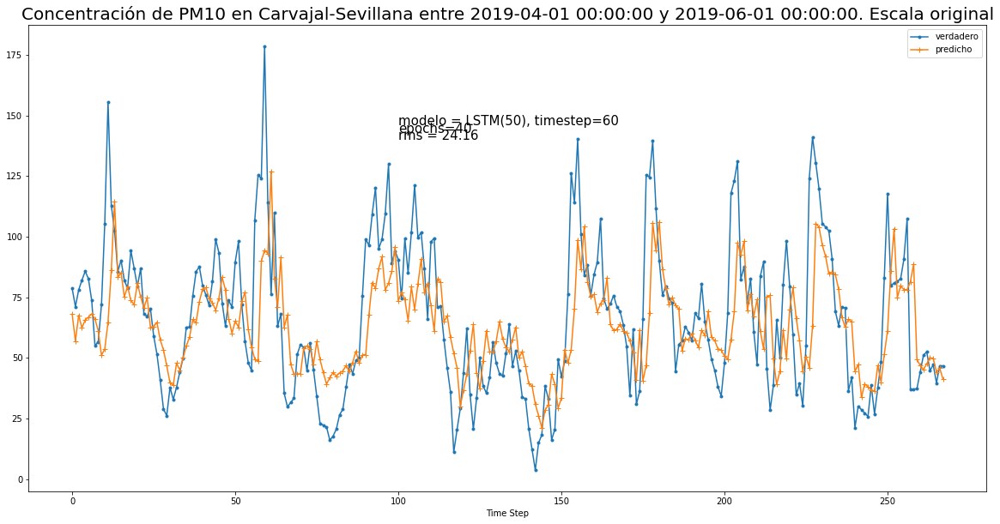

Error cuadratico medio: 24.156284967757088
1465
1465


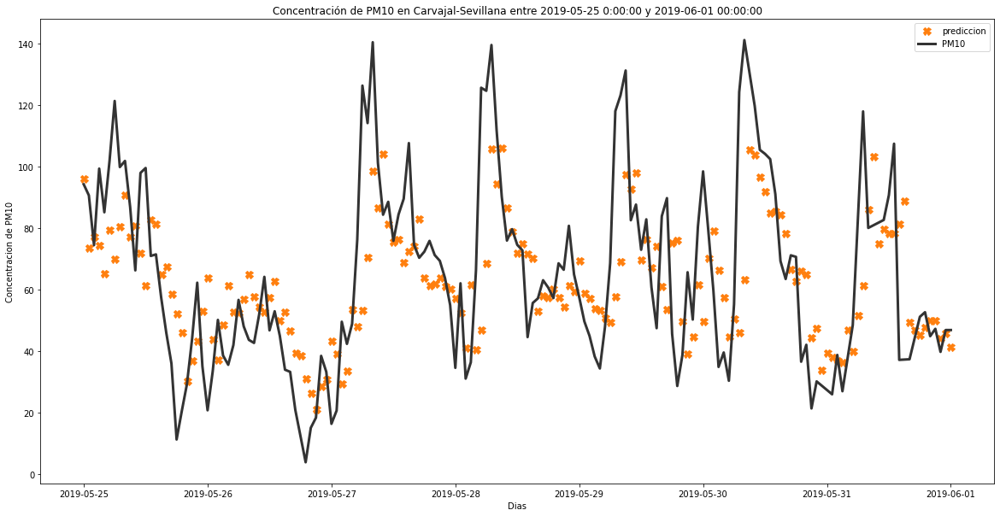

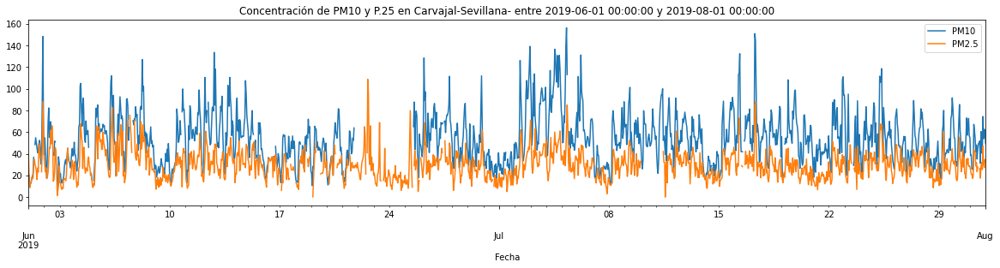

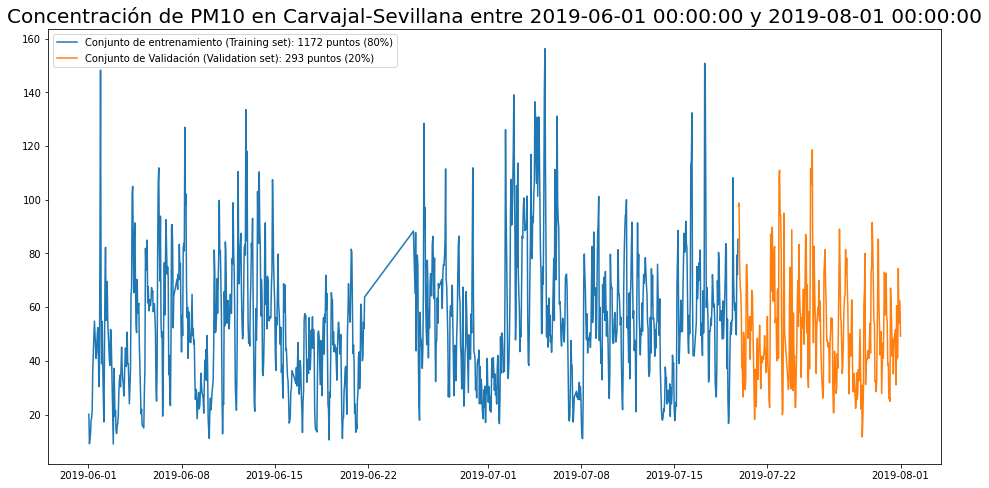

1465 = 1172 + 293
len y_test 268
Model: "sequential_65"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_68 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_69 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_65 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 34ms/step - loss: nan - val_loss: nan
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: nan - val_loss: nan
Epoch 3/30
33/33 [========

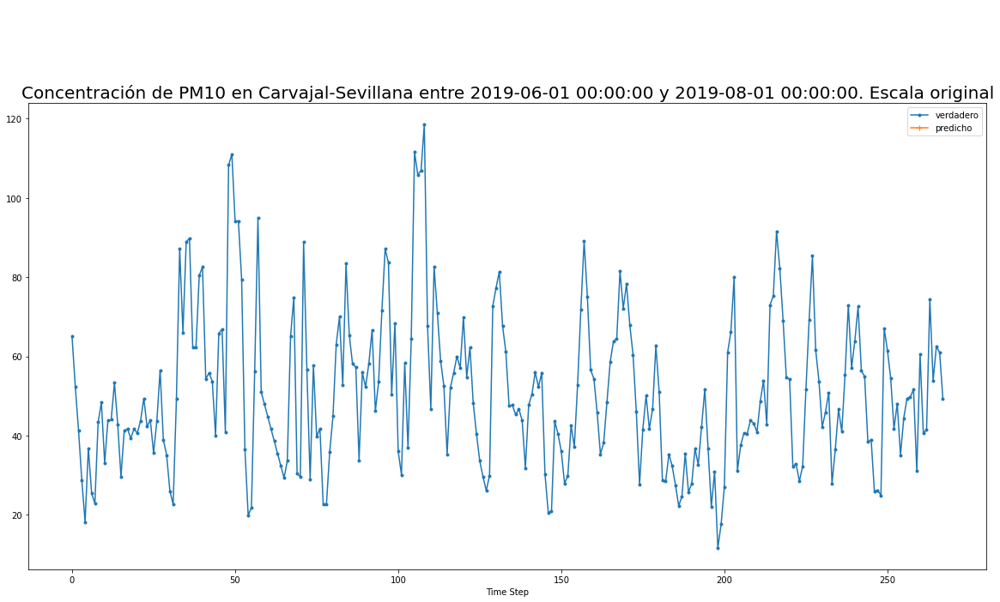

Error cuadratico medio: nan
1465
1465


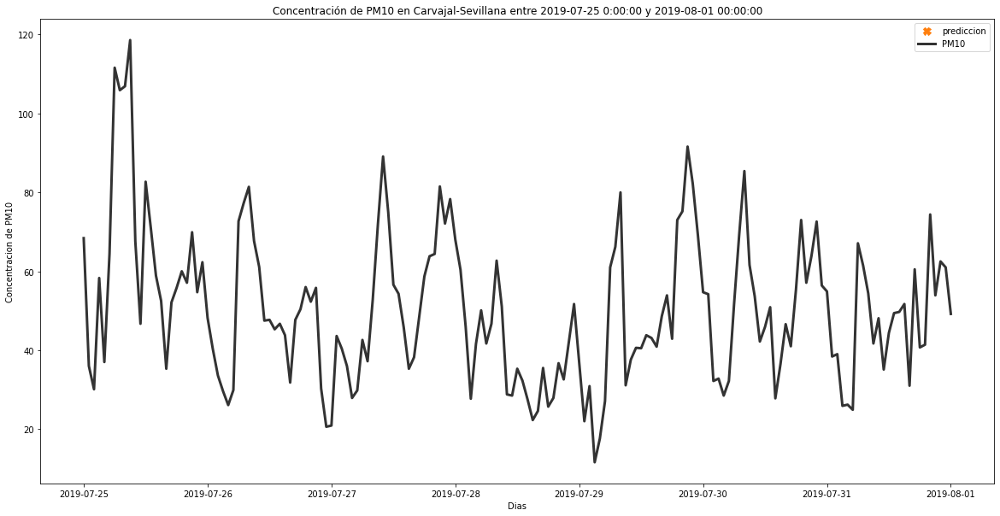

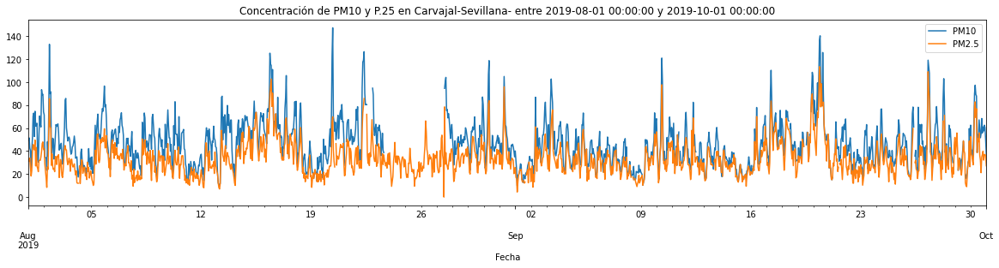

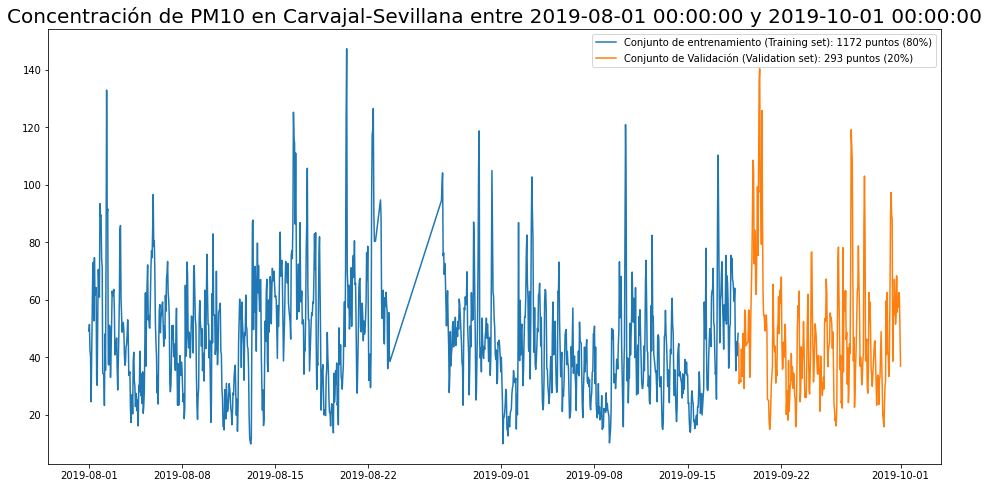

1465 = 1172 + 293
len y_test 268
Model: "sequential_67"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_70 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_71 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_67 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 35ms/step - loss: 0.0260 - val_loss: 0.0158
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0167 - val_loss: 0.0153
Epoch 3/30
33/

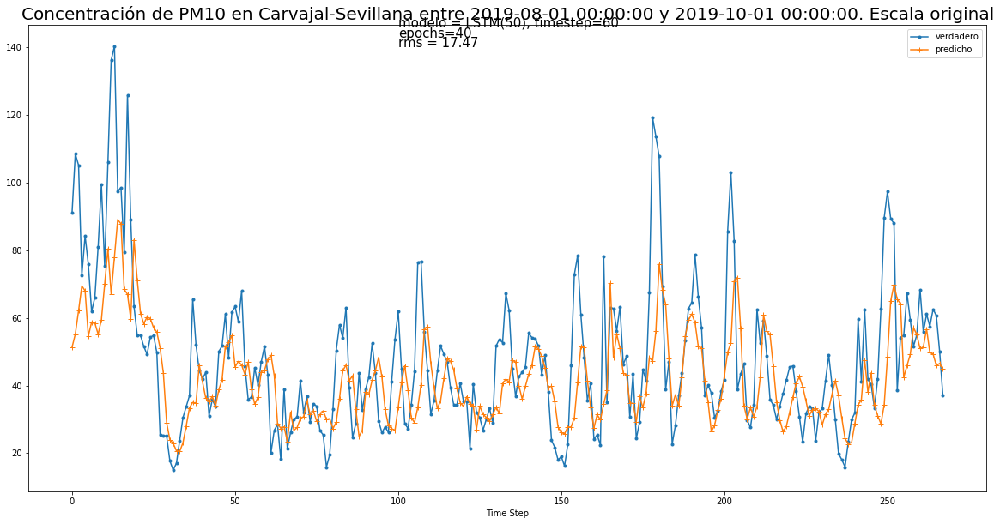

Error cuadratico medio: 17.47109057935199
1465
1465


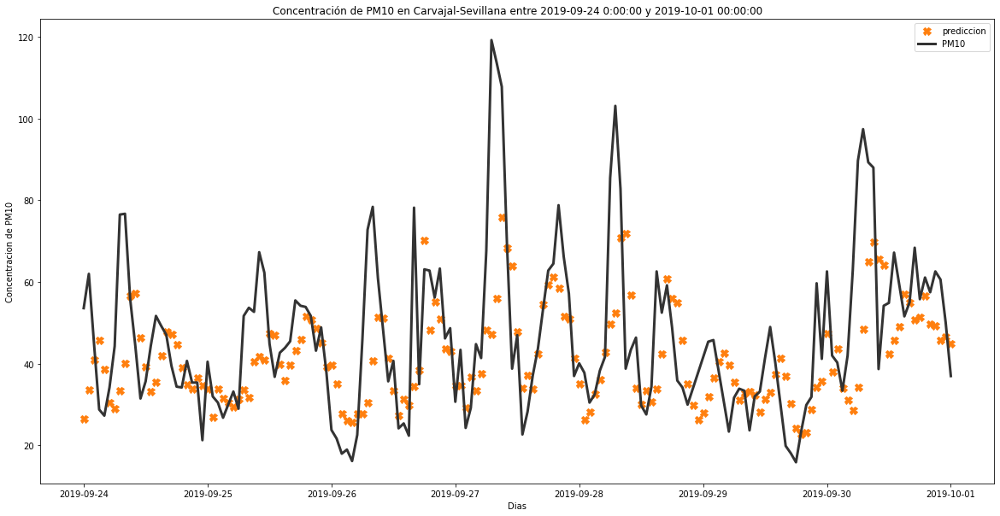

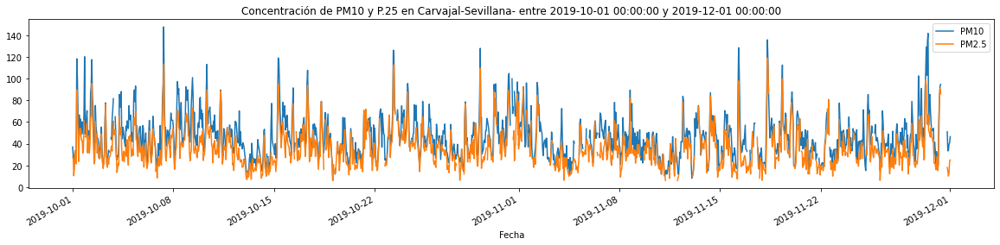

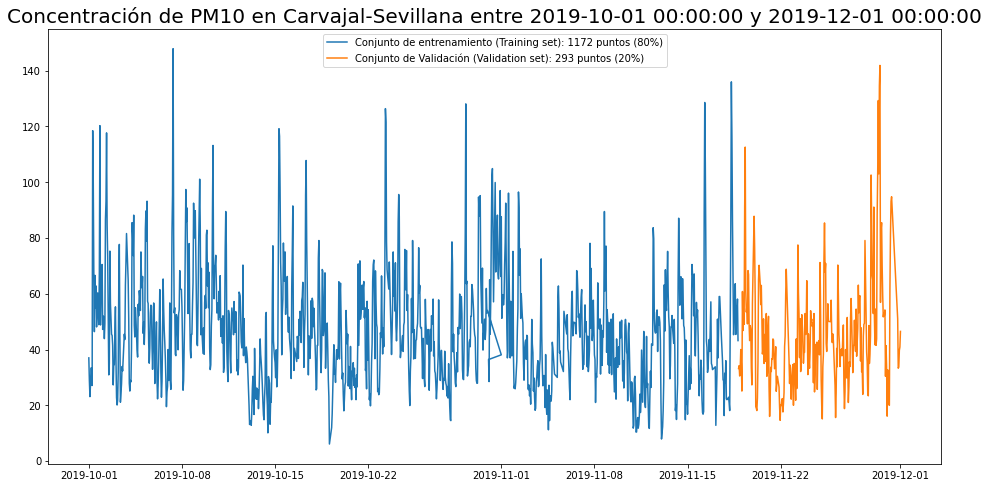

1465 = 1172 + 293
len y_test 268
Model: "sequential_69"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_72 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_73 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_69 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 35ms/step - loss: 0.0229 - val_loss: 0.0302
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0173 - val_loss: 0.0315
Epoch 3/30
33/

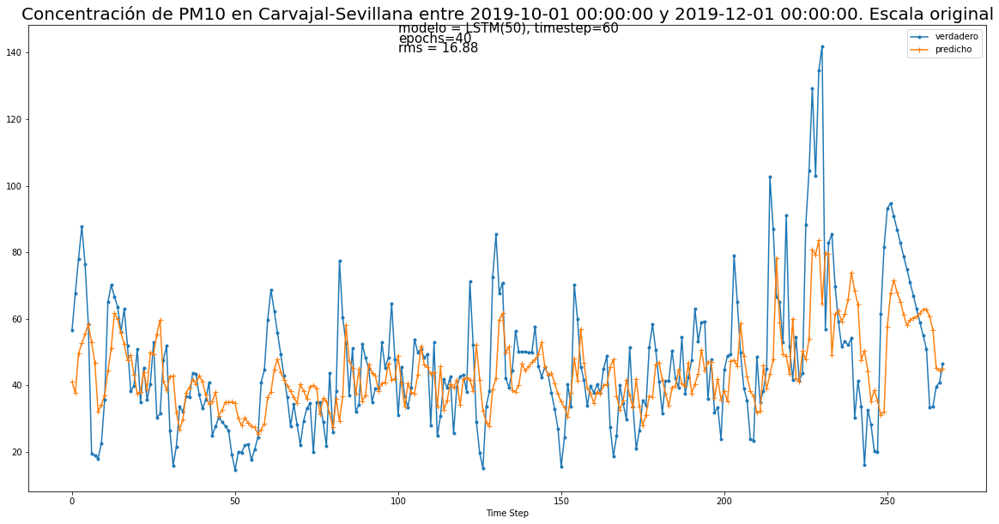

Error cuadratico medio: 16.879322989309284
1489
1489


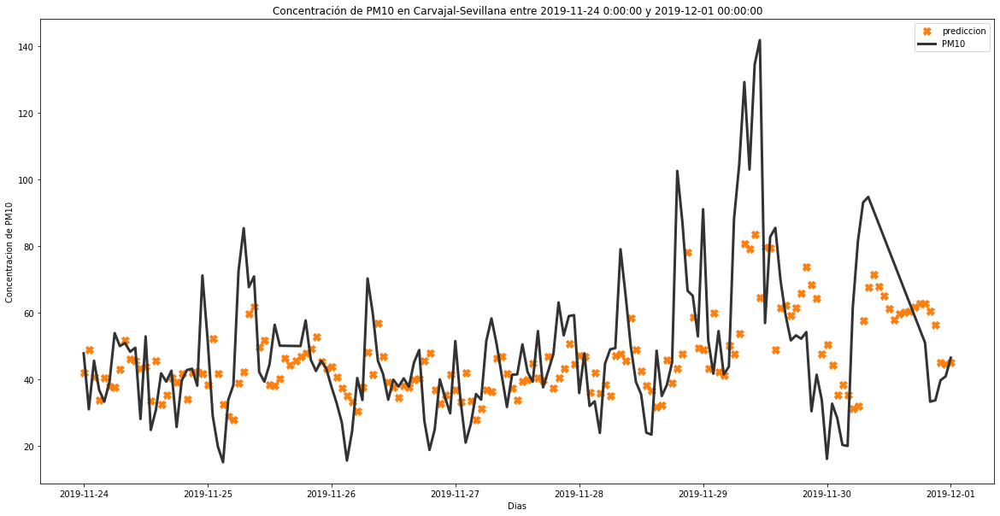

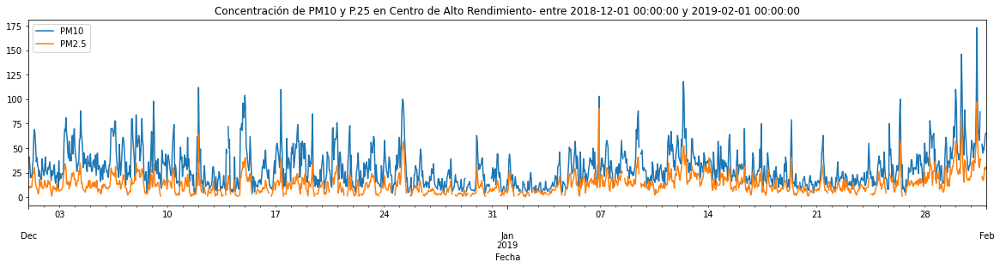

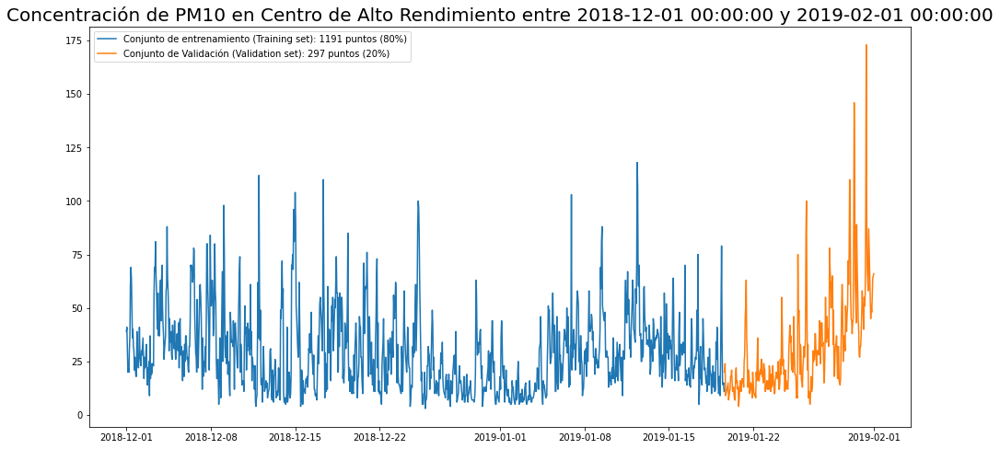

1489 = 1191 + 298
len y_test 273
Model: "sequential_71"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_74 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_75 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_71 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 36ms/step - loss: 0.0137 - val_loss: 0.0077
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0114 - val_loss: 0.0066
Epoch 3/30
33/

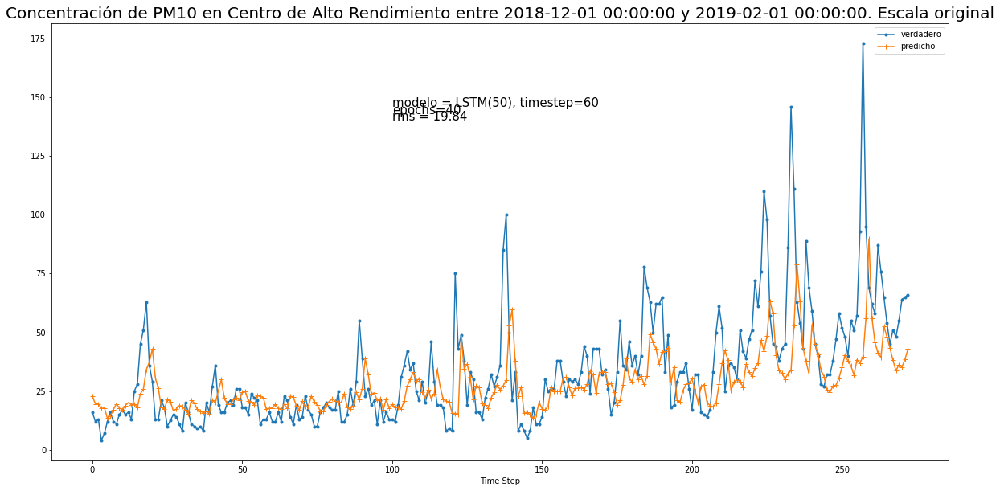

Error cuadratico medio: 19.841974984428578
1417
1417


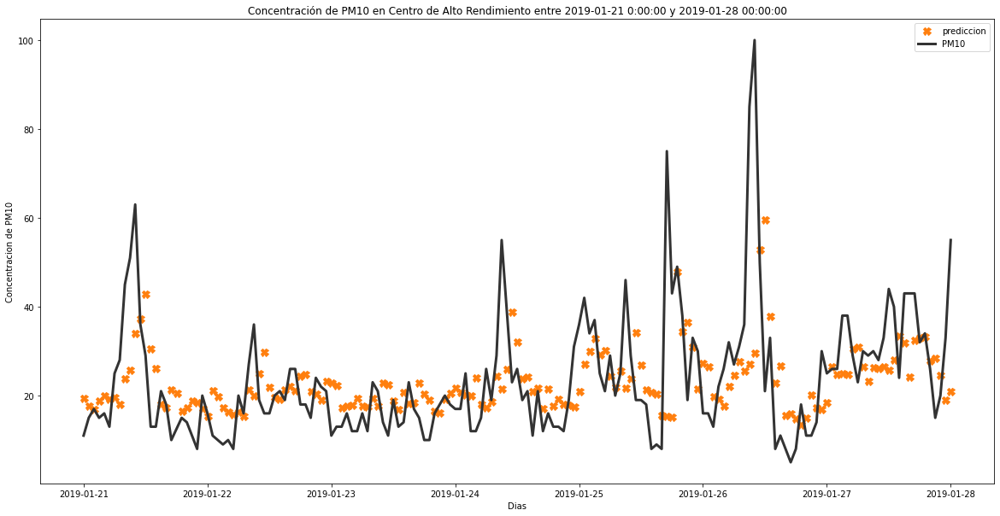

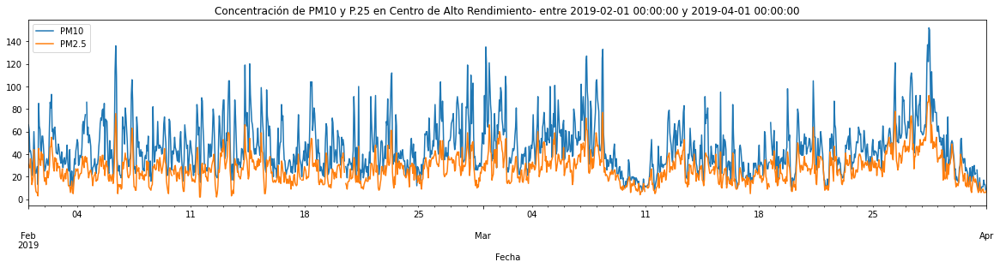

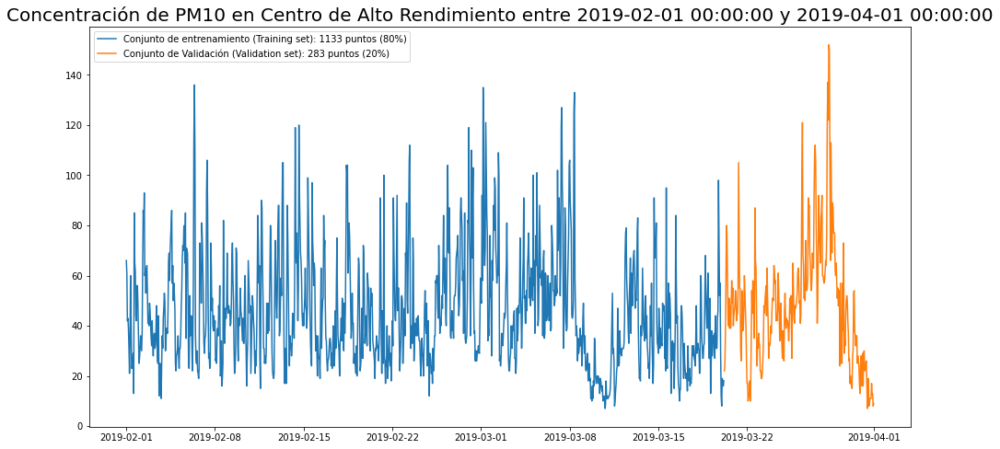

1417 = 1133 + 284
len y_test 259
Model: "sequential_73"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_76 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_77 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_73 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
32/32 [==============================] - 4s 35ms/step - loss: 0.0273 - val_loss: 0.0133
Epoch 2/30
32/32 [==============================] - 0s 10ms/step - loss: 0.0230 - val_loss: 0.0132
Epoch 3/30
32/

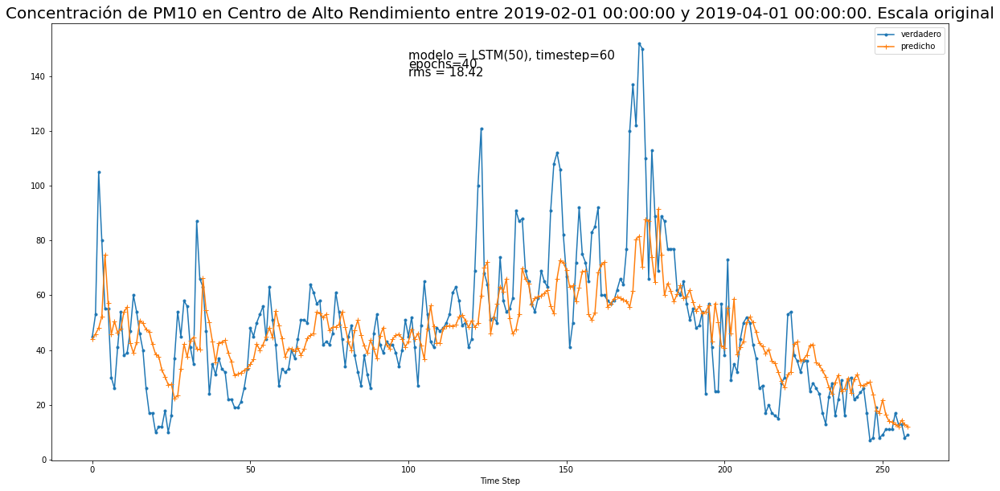

Error cuadratico medio: 18.42367811758421
1465
1465


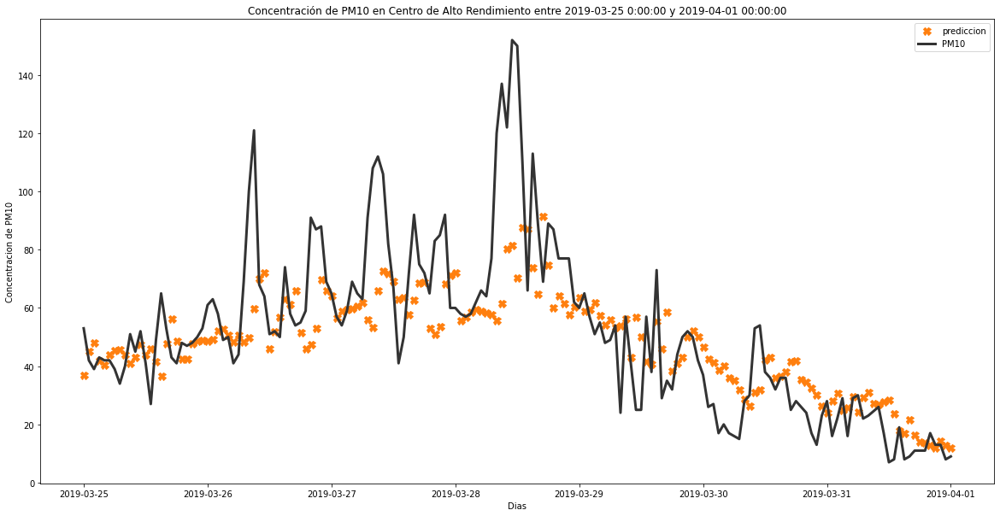

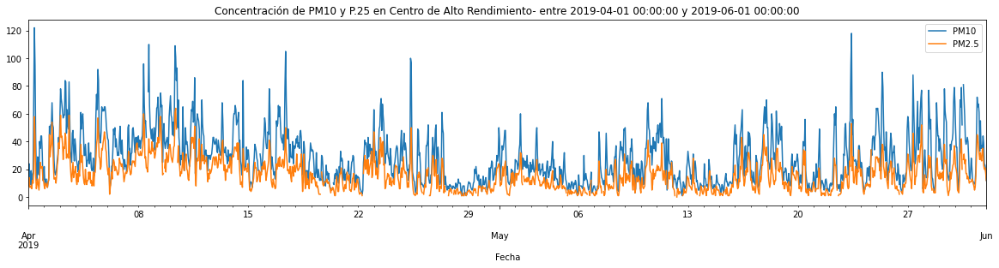

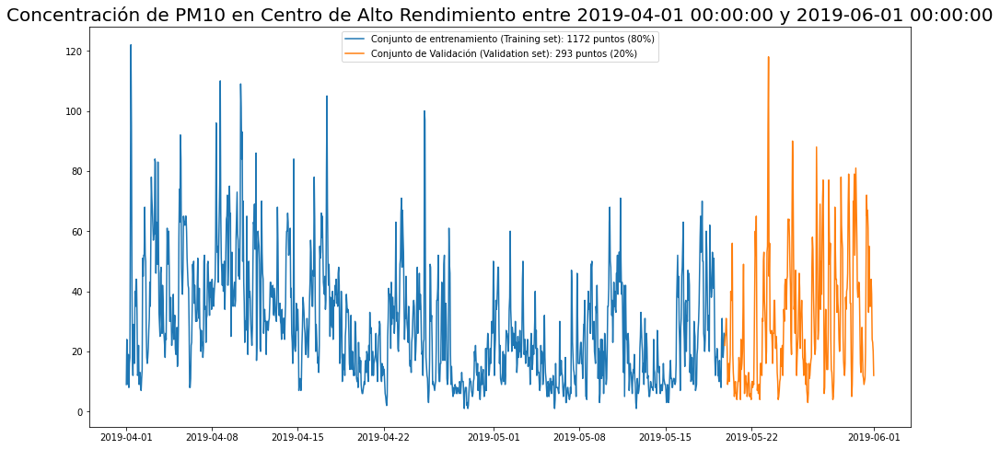

1465 = 1172 + 293
len y_test 268
Model: "sequential_75"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_78 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_79 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_75 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 34ms/step - loss: 0.0249 - val_loss: 0.0182
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0171 - val_loss: 0.0168
Epoch 3/30
33/

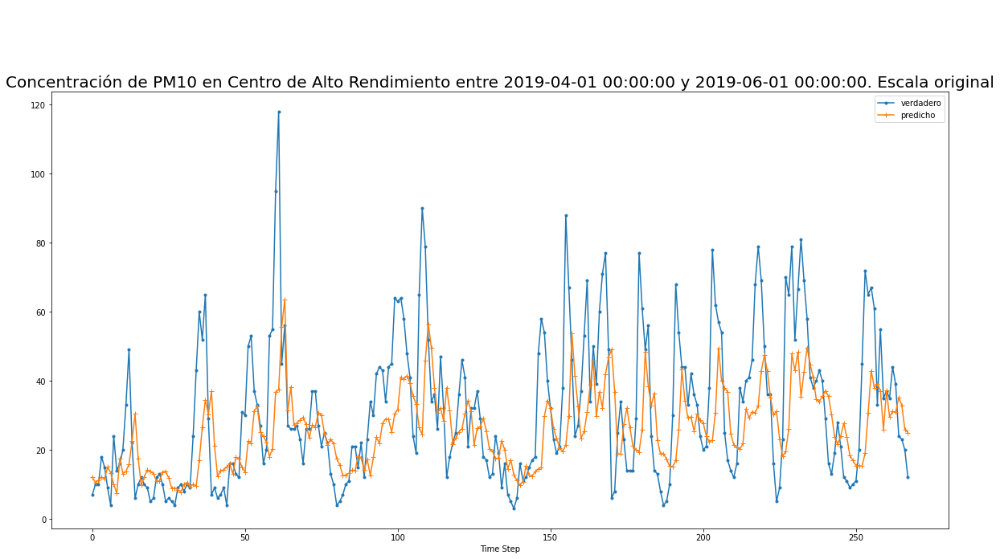

Error cuadratico medio: 19.272443644057027
1465
1465


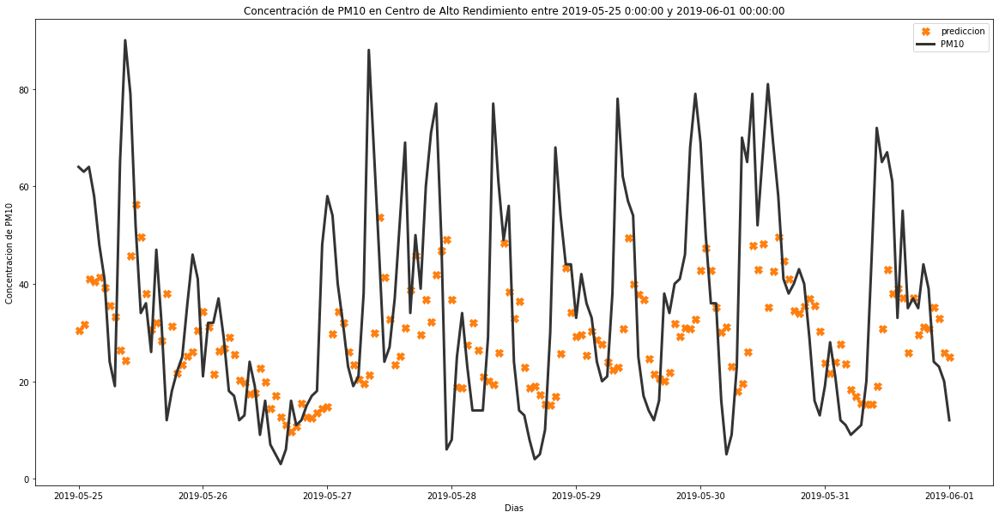

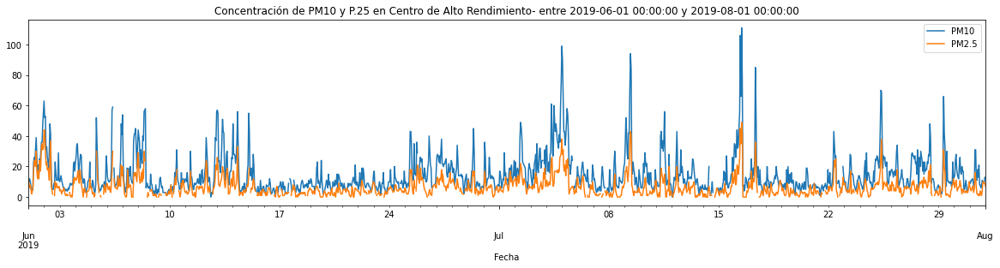

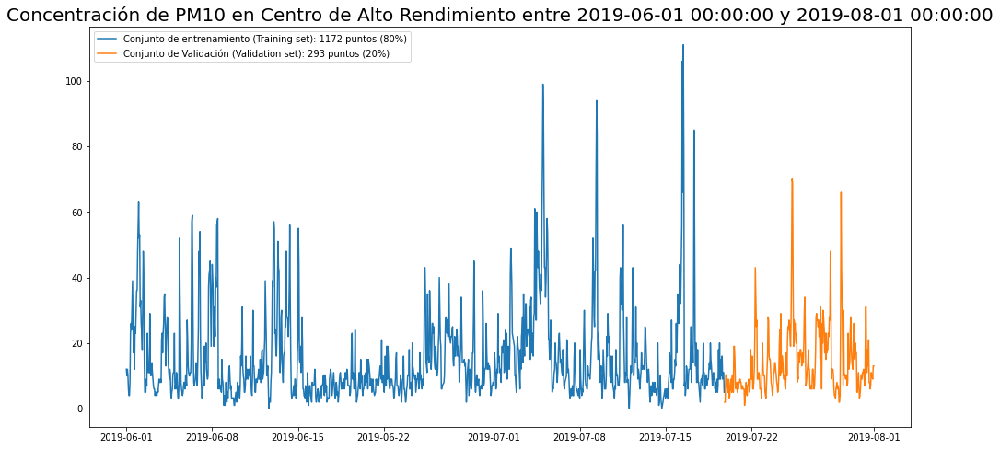

1465 = 1172 + 293
len y_test 268
Model: "sequential_77"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_80 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_81 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_77 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 36ms/step - loss: 0.0124 - val_loss: 0.0265
Epoch 2/30
33/33 [==============================] - 0s 11ms/step - loss: 0.0112 - val_loss: 0.0248
Epoch 3/30
33/

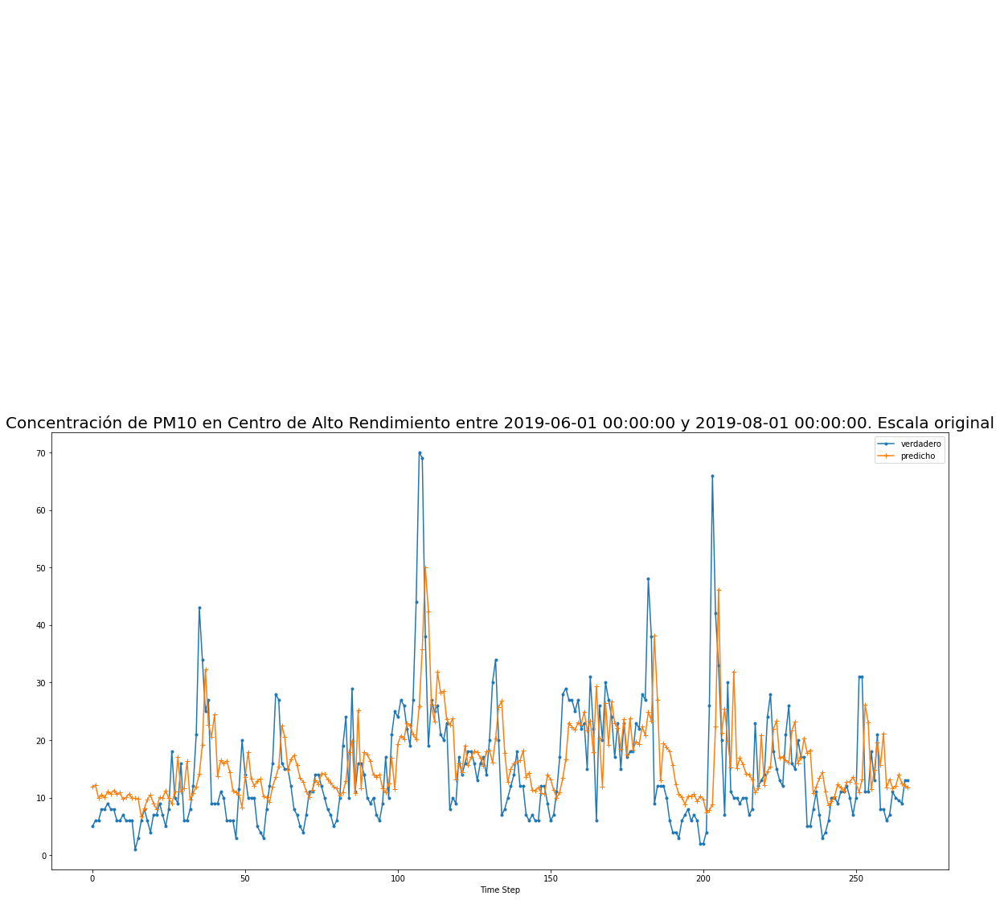

Error cuadratico medio: 9.412691630077838
1465
1465


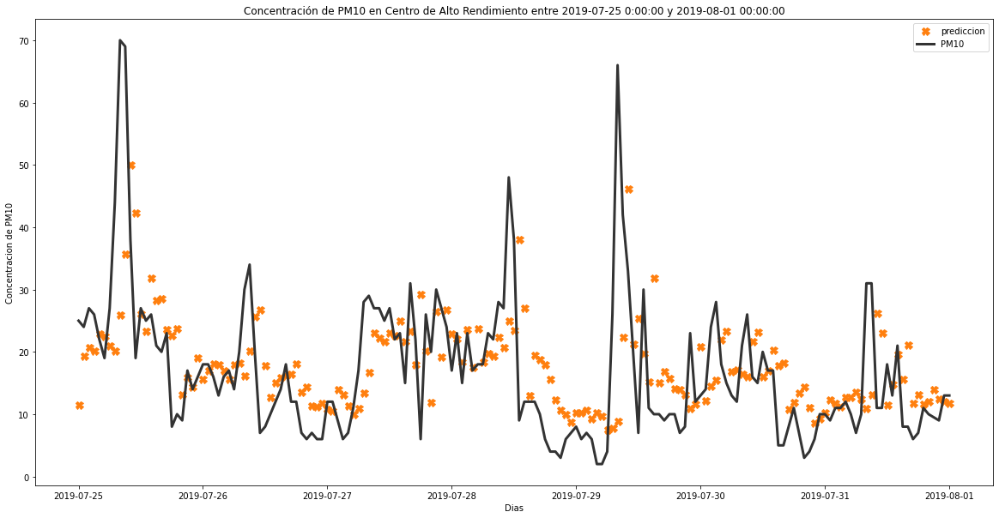

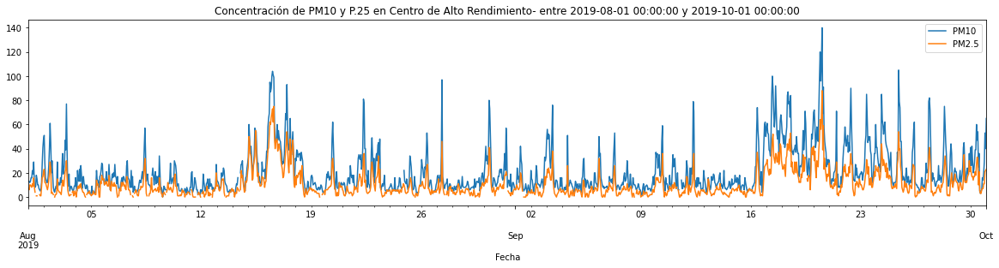

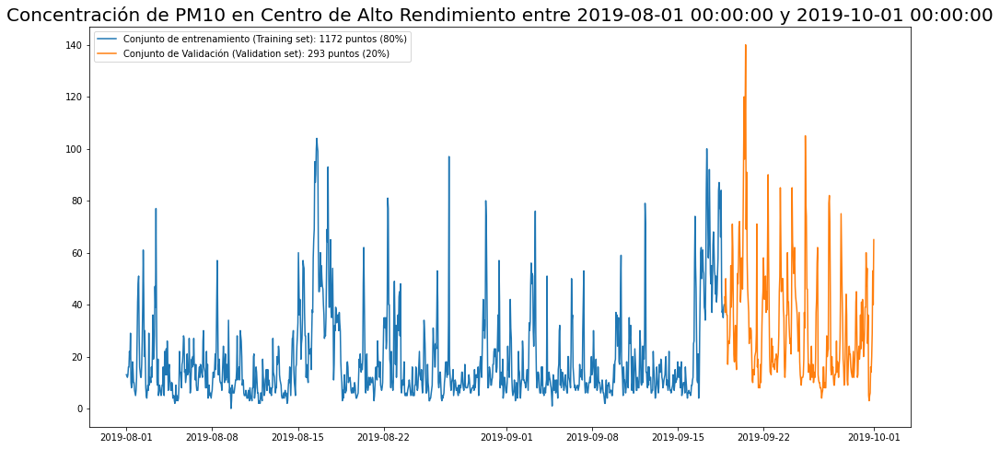

1465 = 1172 + 293
len y_test 268
Model: "sequential_79"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_82 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_83 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_79 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 36ms/step - loss: 0.0120 - val_loss: 0.0222
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0100 - val_loss: 0.0243
Epoch 3/30
33/

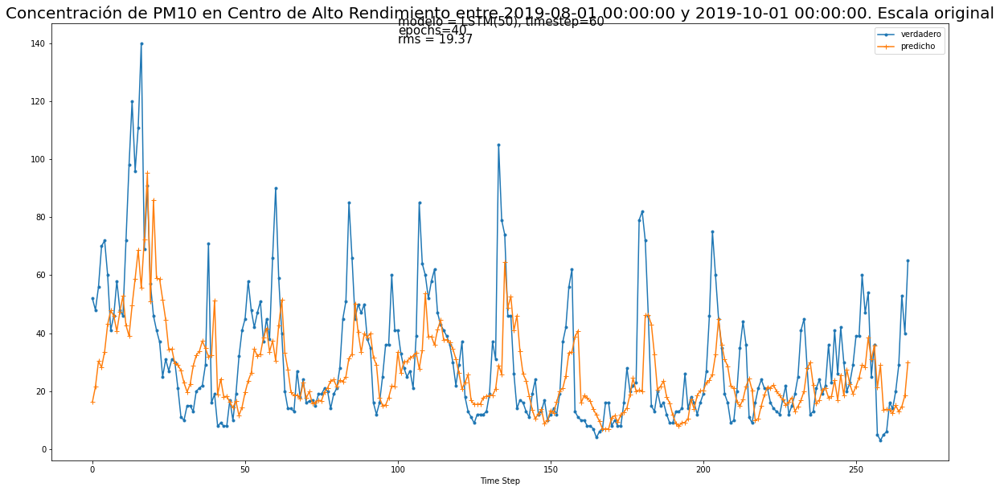

Error cuadratico medio: 19.36680685881312
1465
1465


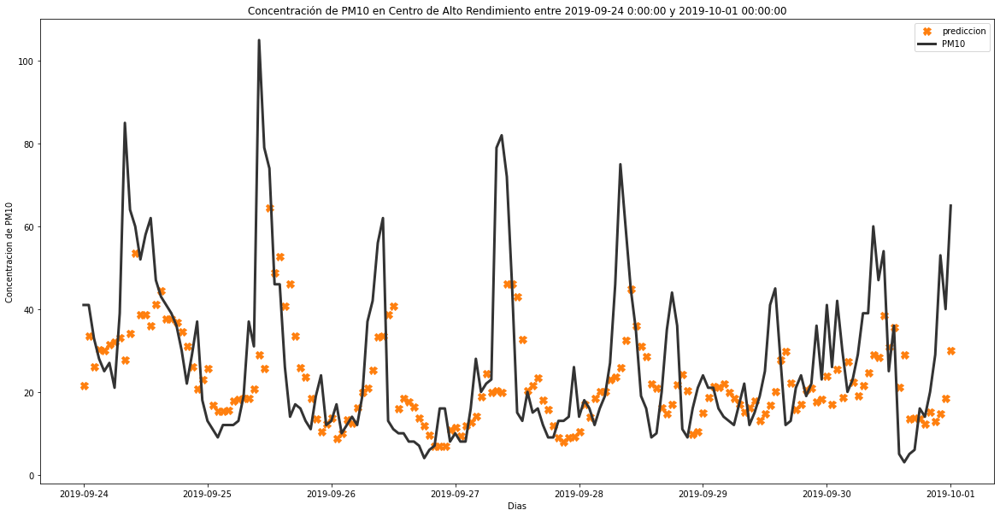

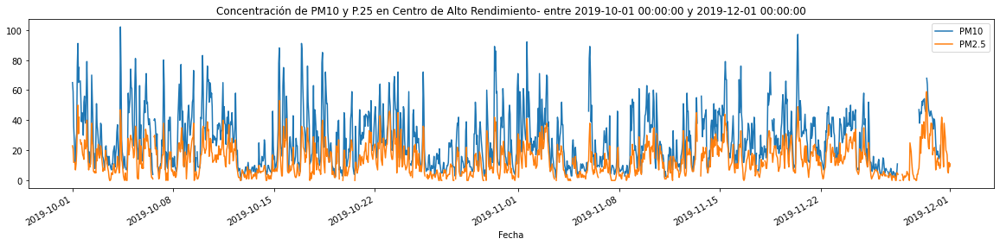

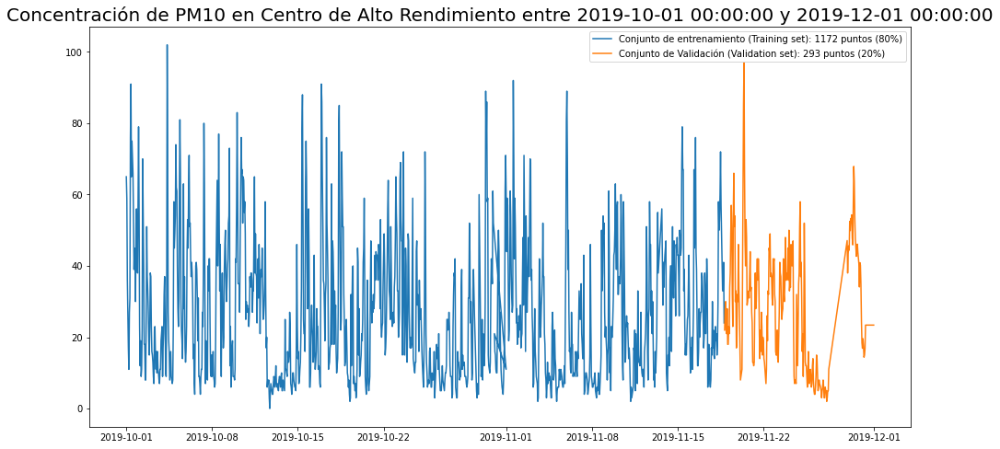

1465 = 1172 + 293
len y_test 268
Model: "sequential_81"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_84 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_85 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_81 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 36ms/step - loss: 0.0367 - val_loss: 0.0299
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0311 - val_loss: 0.0274
Epoch 3/30
33/

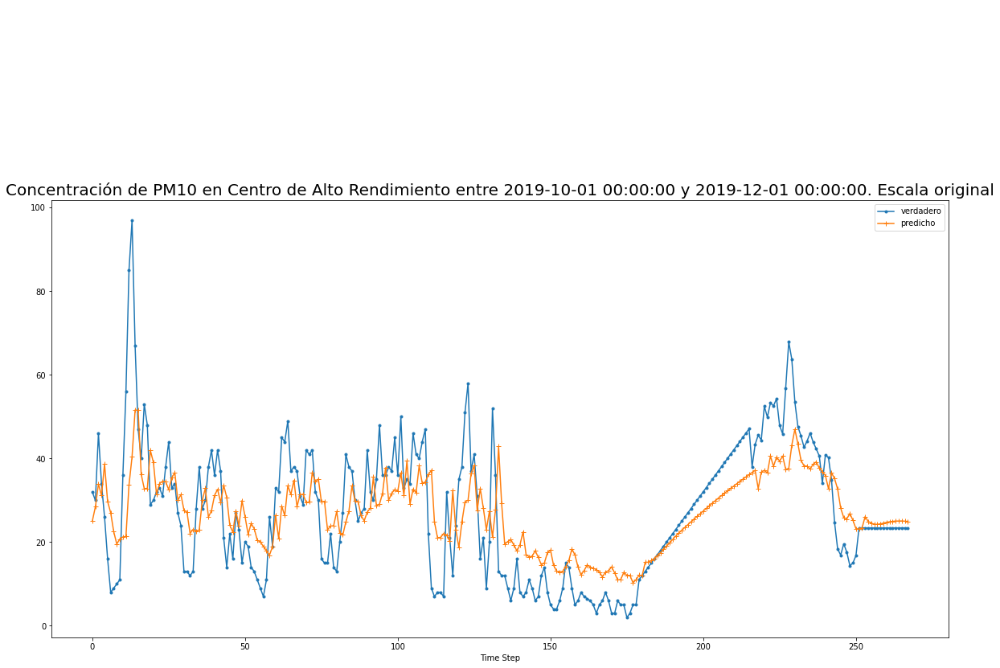

Error cuadratico medio: 11.041701555577127
1489
1489


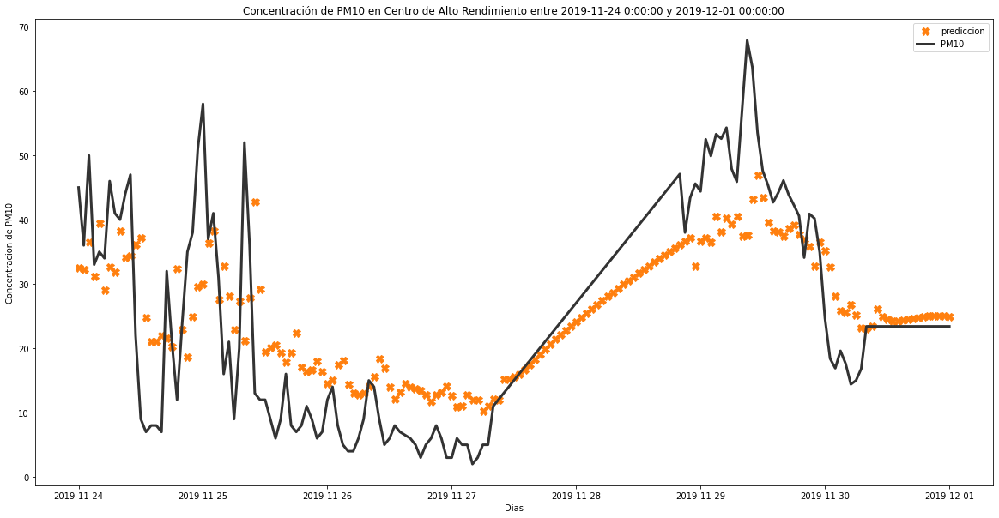

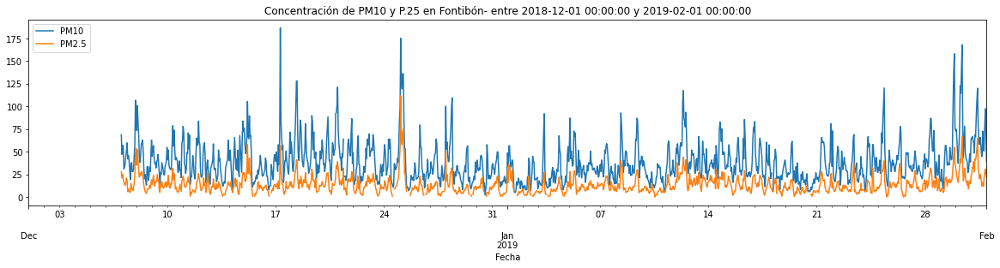

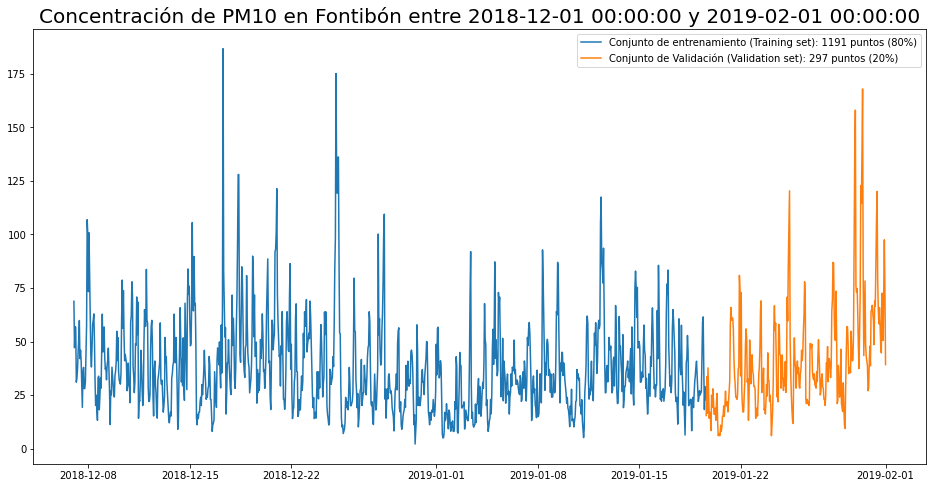

1489 = 1191 + 298
len y_test 273
Model: "sequential_83"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_86 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_87 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_83 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 35ms/step - loss: nan - val_loss: nan
Epoch 2/30
33/33 [==============================] - 0s 9ms/step - loss: nan - val_loss: nan
Epoch 3/30
33/33 [=========

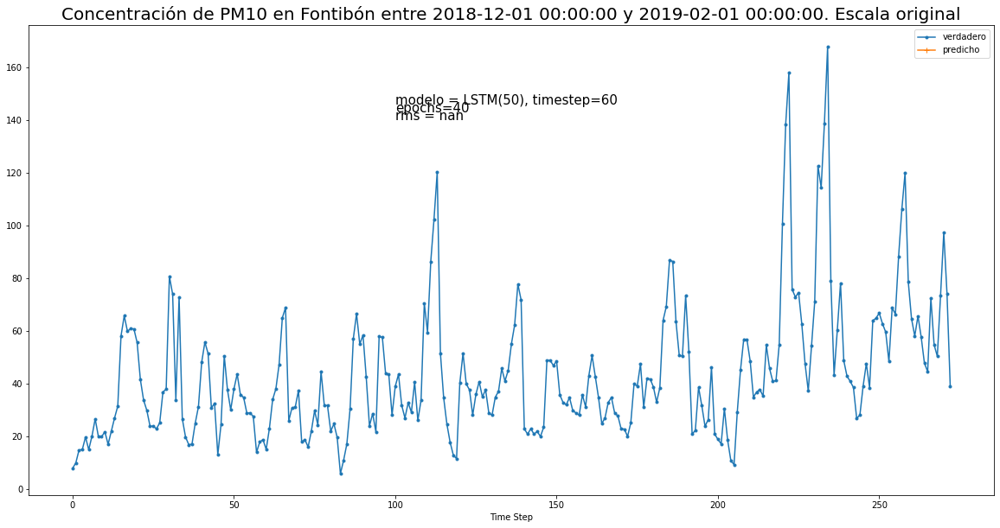

Error cuadratico medio: nan
1417
1417


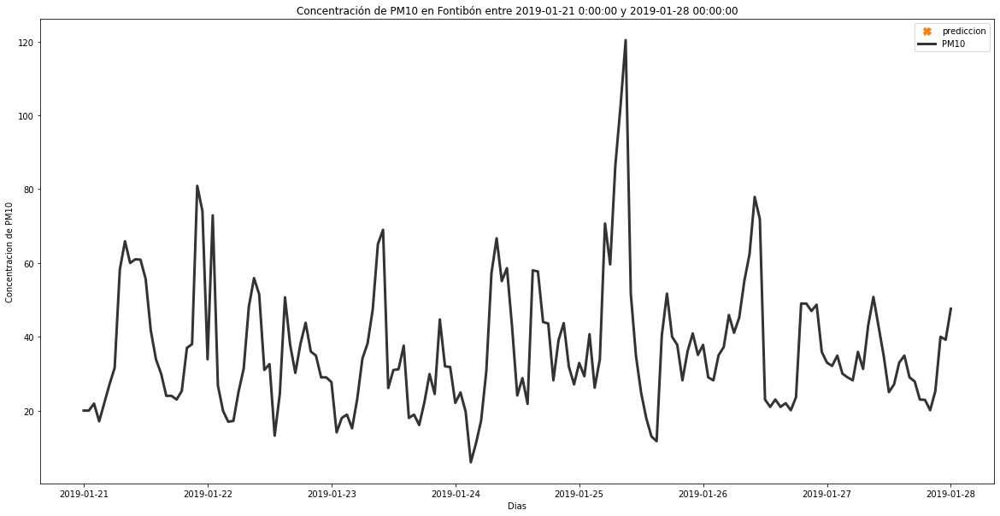

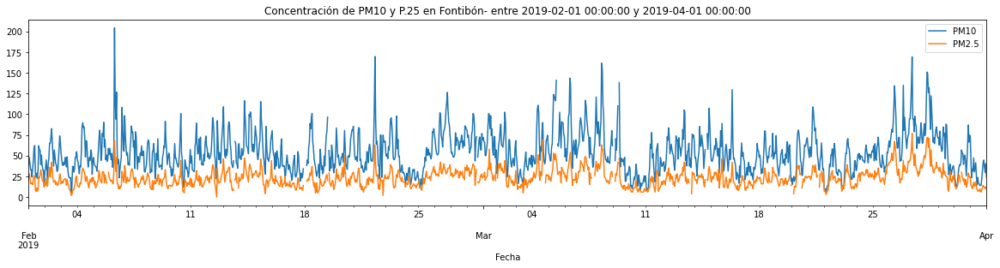

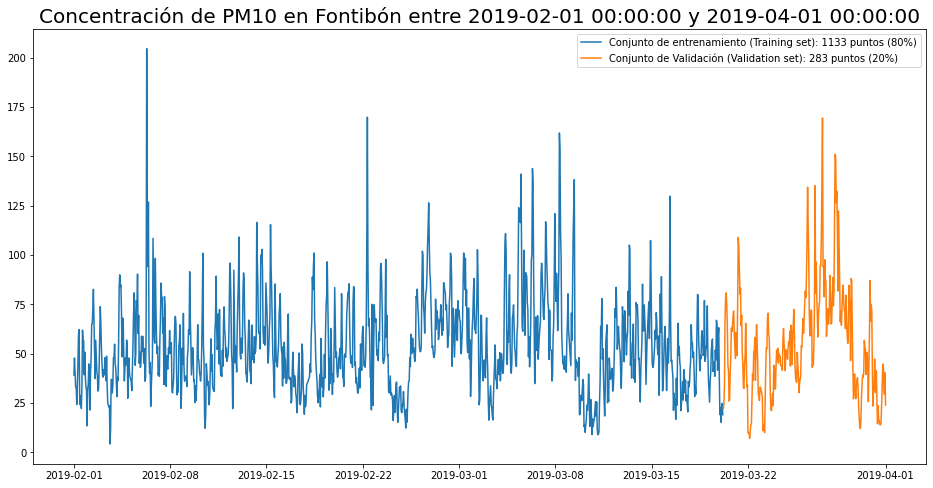

1417 = 1133 + 284
len y_test 259
Model: "sequential_85"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_88 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_89 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_85 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
32/32 [==============================] - 4s 35ms/step - loss: 0.0164 - val_loss: 0.0076
Epoch 2/30
32/32 [==============================] - 0s 10ms/step - loss: 0.0128 - val_loss: 0.0077
Epoch 3/30
32/

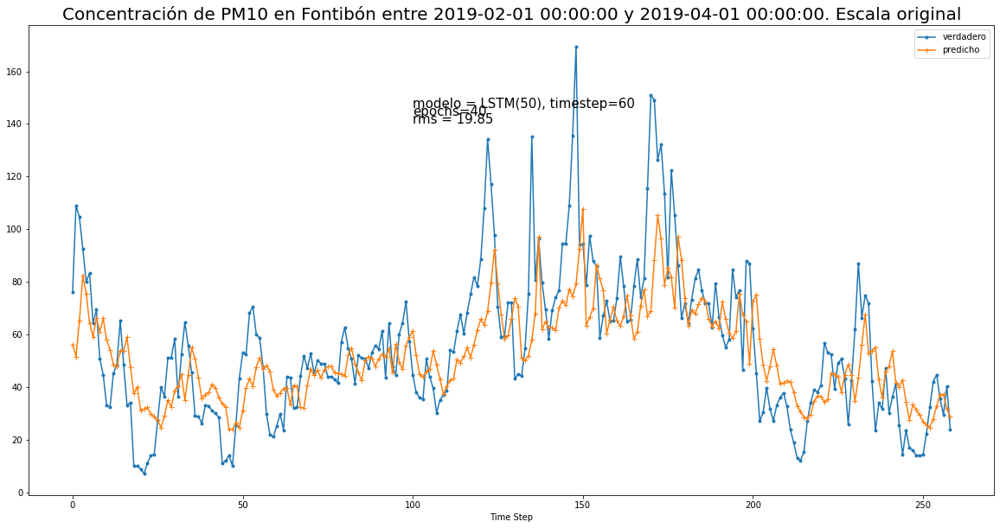

Error cuadratico medio: 19.854179636043938
1465
1465


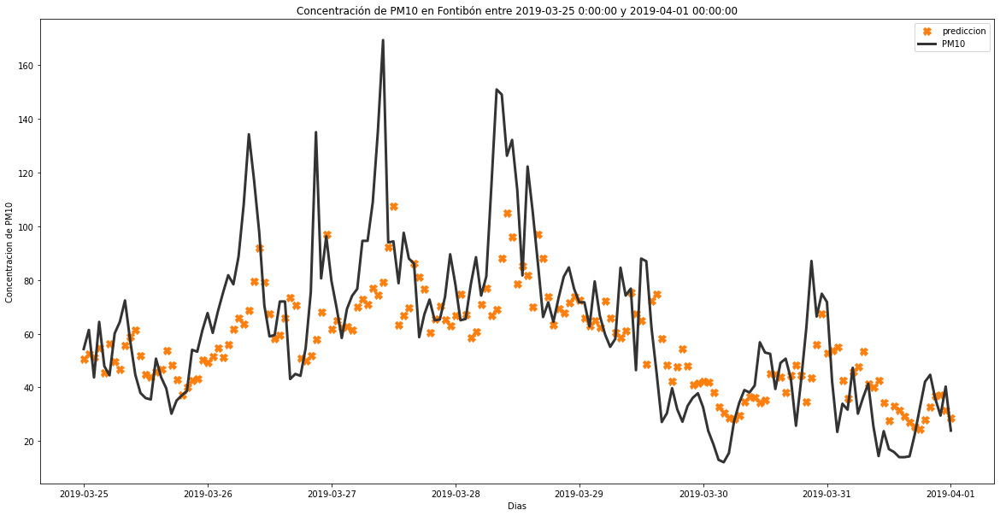

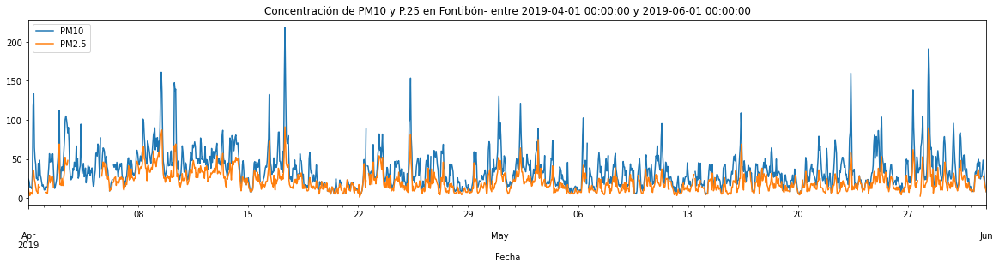

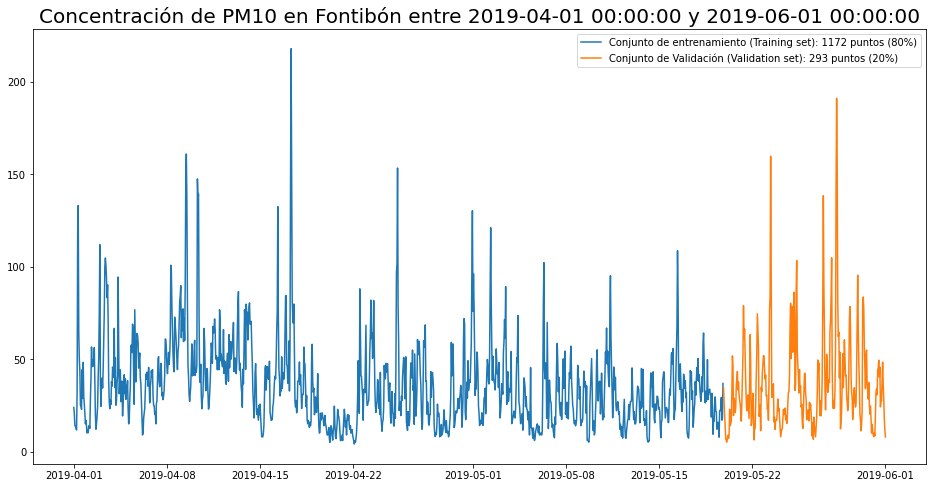

1465 = 1172 + 293
len y_test 268
Model: "sequential_87"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_90 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_91 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_87 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 35ms/step - loss: 0.0123 - val_loss: 0.0050
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0103 - val_loss: 0.0049
Epoch 3/30
33/

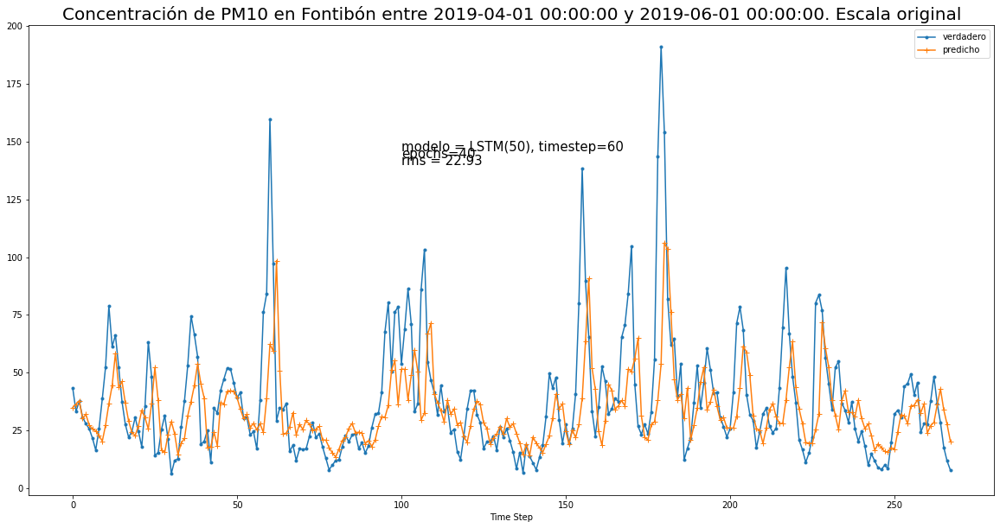

Error cuadratico medio: 22.930686183258647
1465
1465


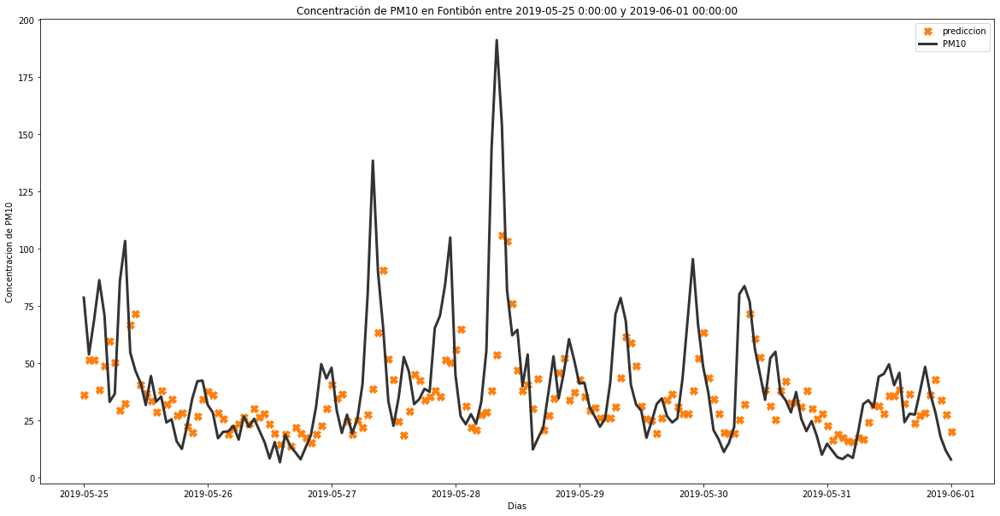

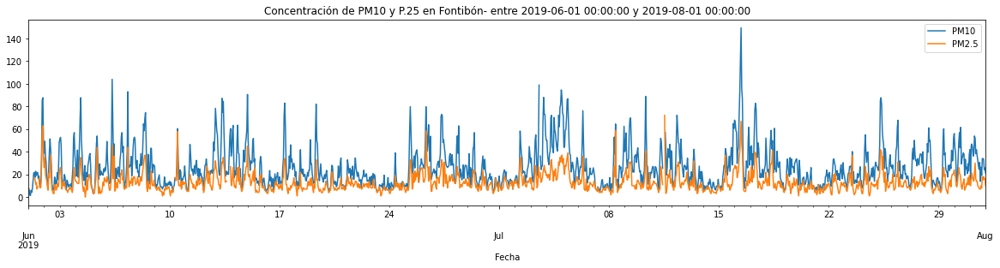

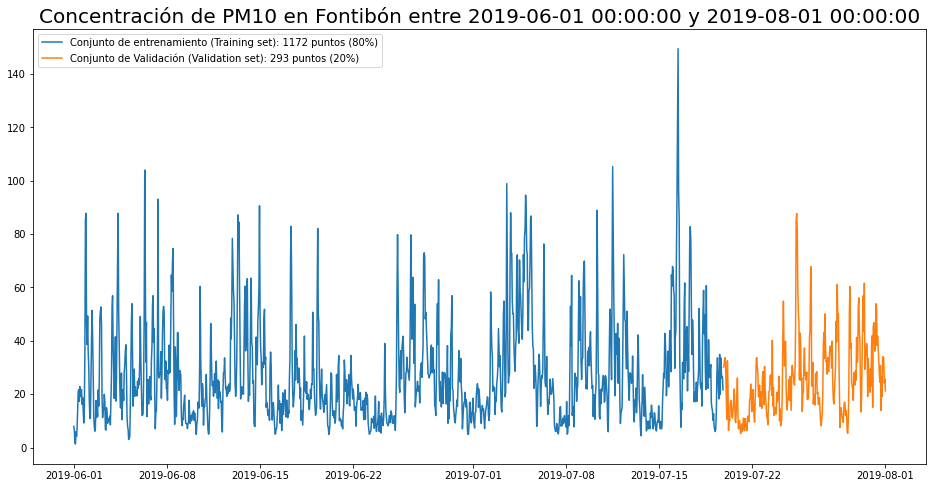

1465 = 1172 + 293
len y_test 268
Model: "sequential_89"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_92 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_93 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_89 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 34ms/step - loss: 0.0145 - val_loss: 0.0246
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0130 - val_loss: 0.0231
Epoch 3/30
33/

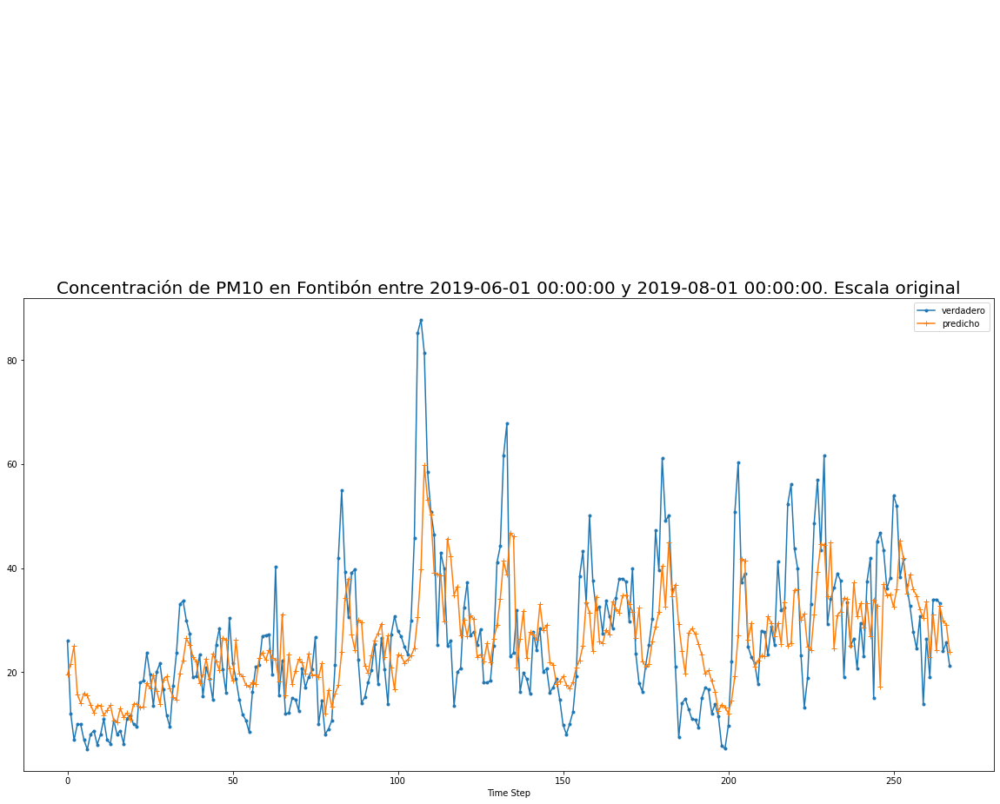

Error cuadratico medio: 11.099676928656296
1465
1465


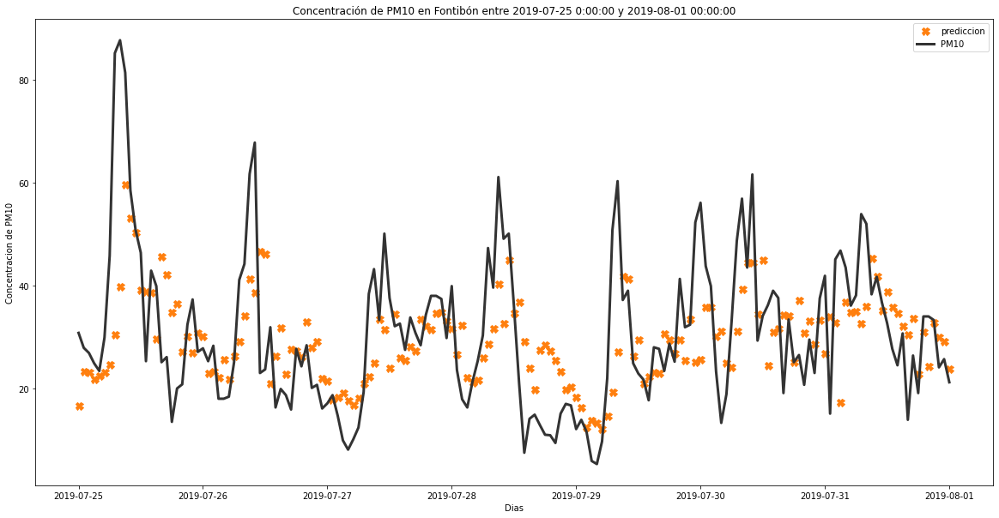

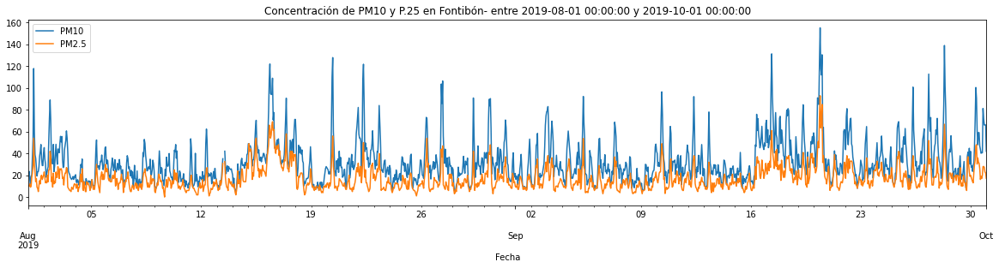

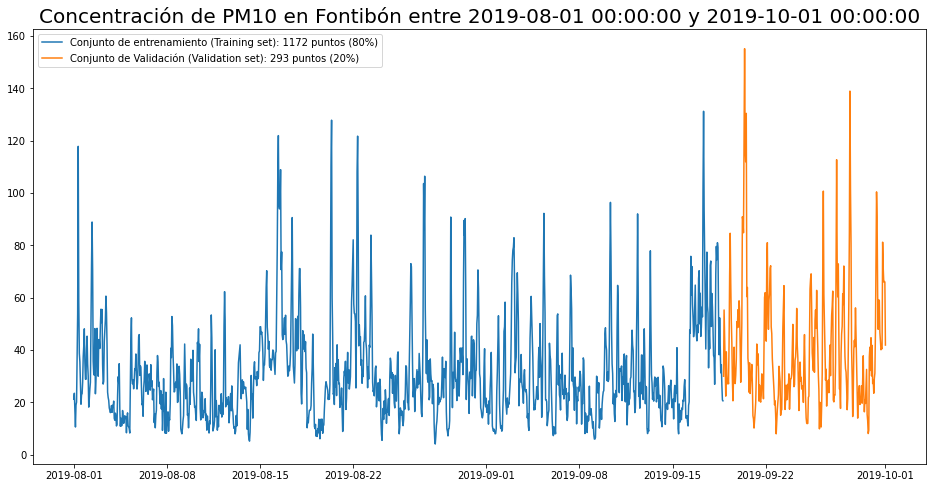

1465 = 1172 + 293
len y_test 268
Model: "sequential_91"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_94 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_95 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_91 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 35ms/step - loss: 0.0169 - val_loss: 0.0162
Epoch 2/30
33/33 [==============================] - 0s 11ms/step - loss: 0.0131 - val_loss: 0.0188
Epoch 3/30
33/

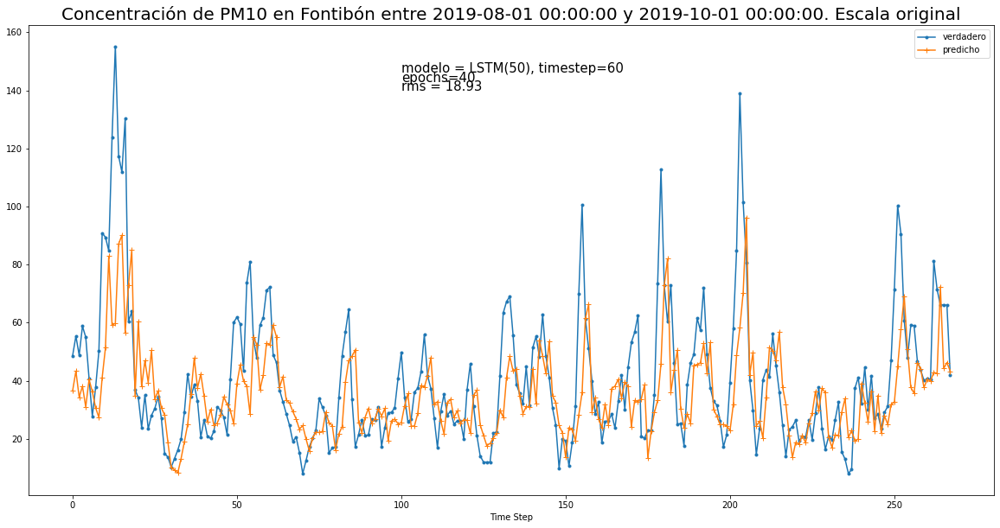

Error cuadratico medio: 18.930906762046114
1465
1465


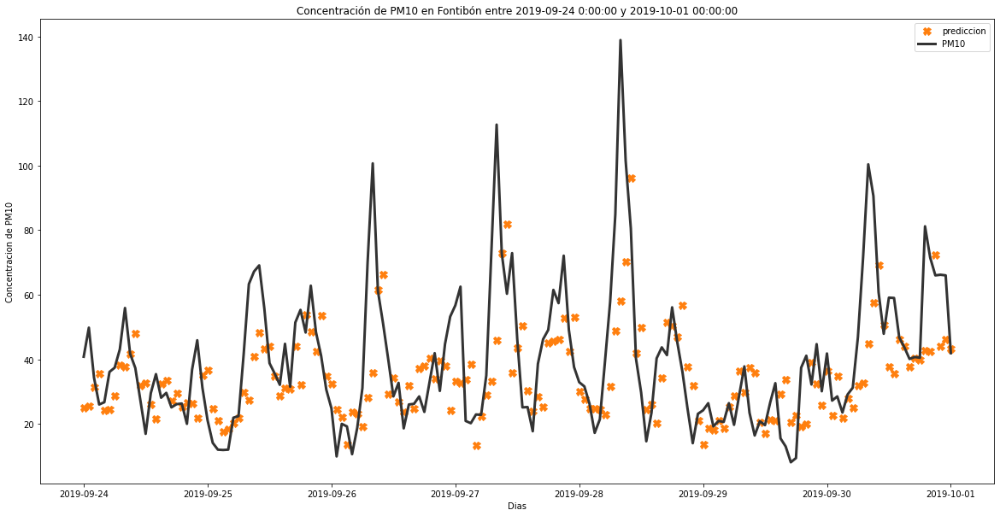

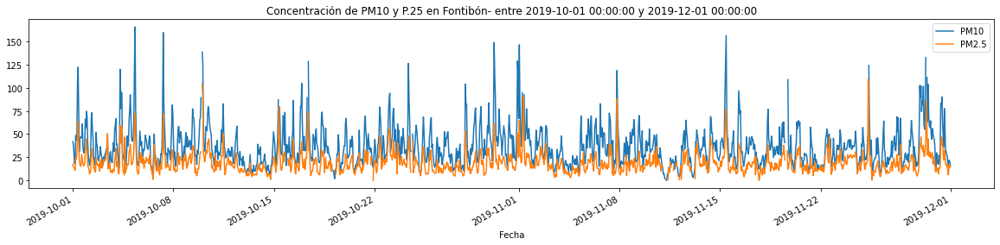

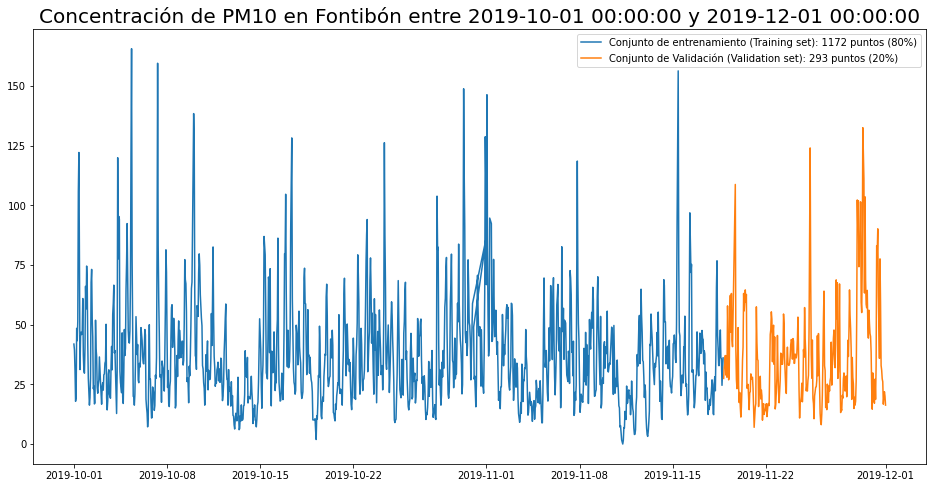

1465 = 1172 + 293
len y_test 268
Model: "sequential_93"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_96 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_97 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_93 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 35ms/step - loss: 0.0195 - val_loss: 0.0197
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0172 - val_loss: 0.0209
Epoch 3/30
33/

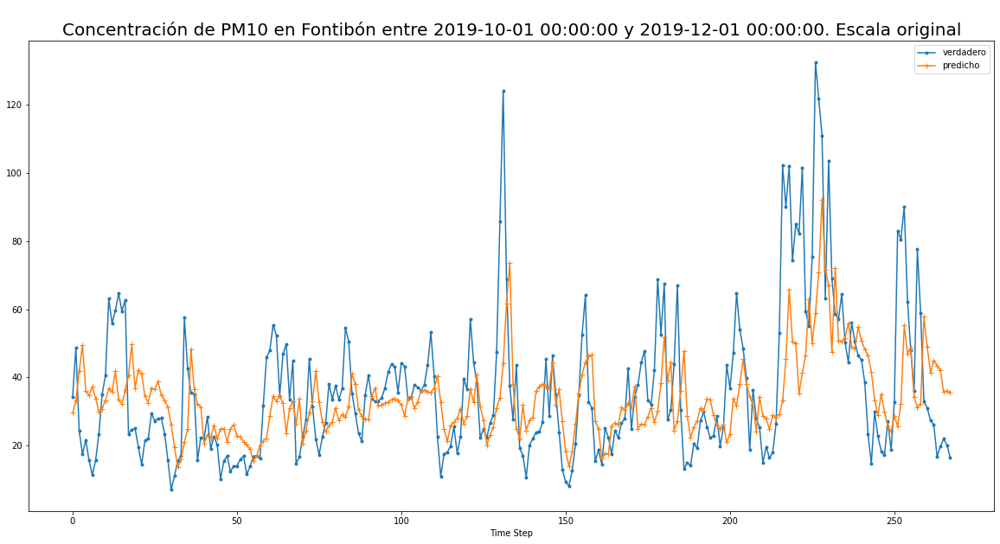

Error cuadratico medio: 18.460385734573467
1489
1489


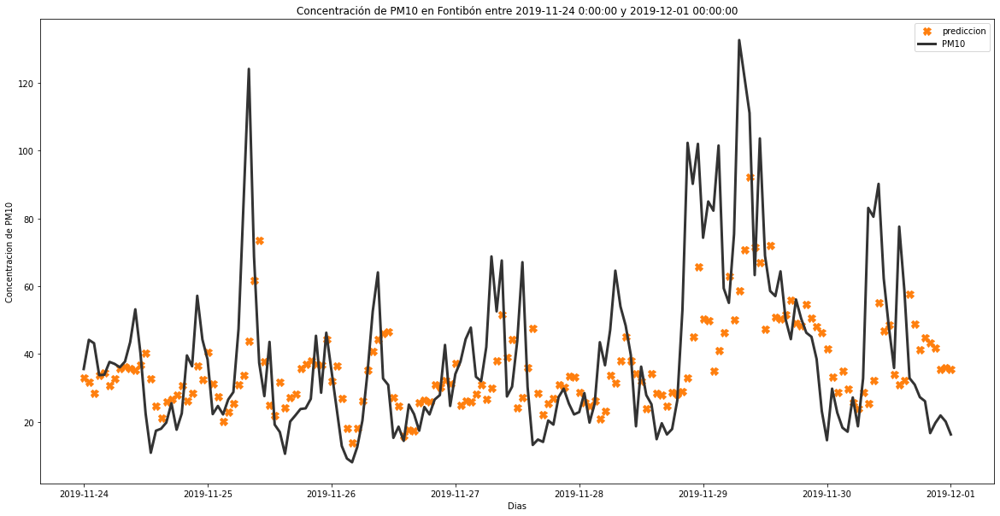

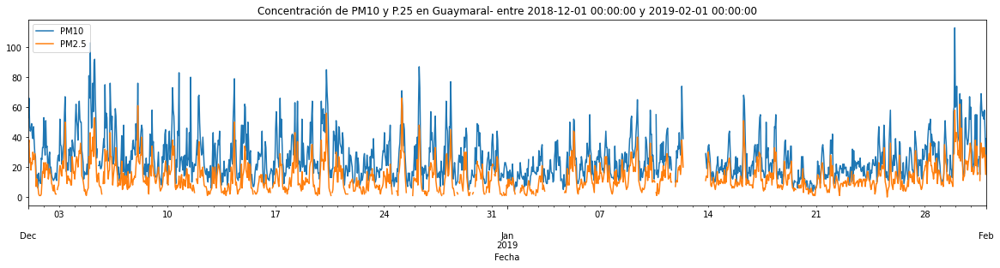

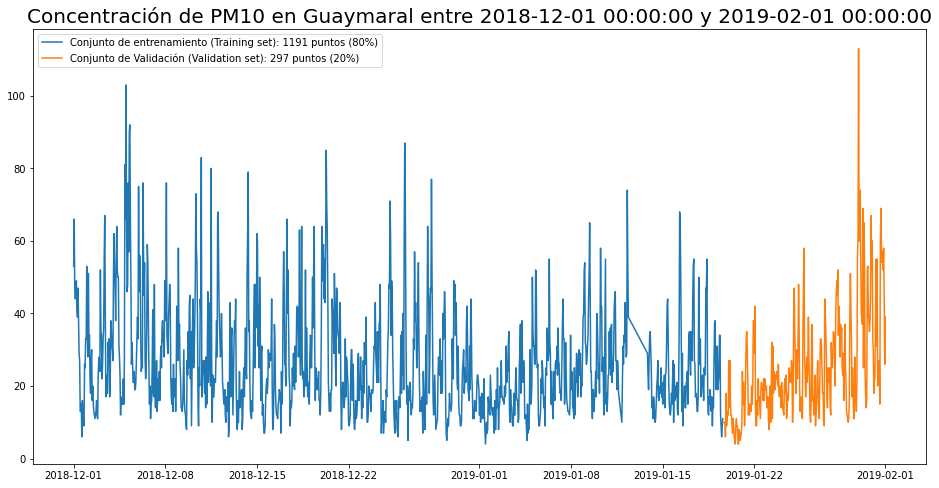

1489 = 1191 + 298
len y_test 273
Model: "sequential_95"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_98 (LSTM)               (None, 24, 200)           161600    
_________________________________________________________________
lstm_99 (LSTM)               (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_95 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 35ms/step - loss: 0.0229 - val_loss: 0.0129
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0174 - val_loss: 0.0127
Epoch 3/30
33/

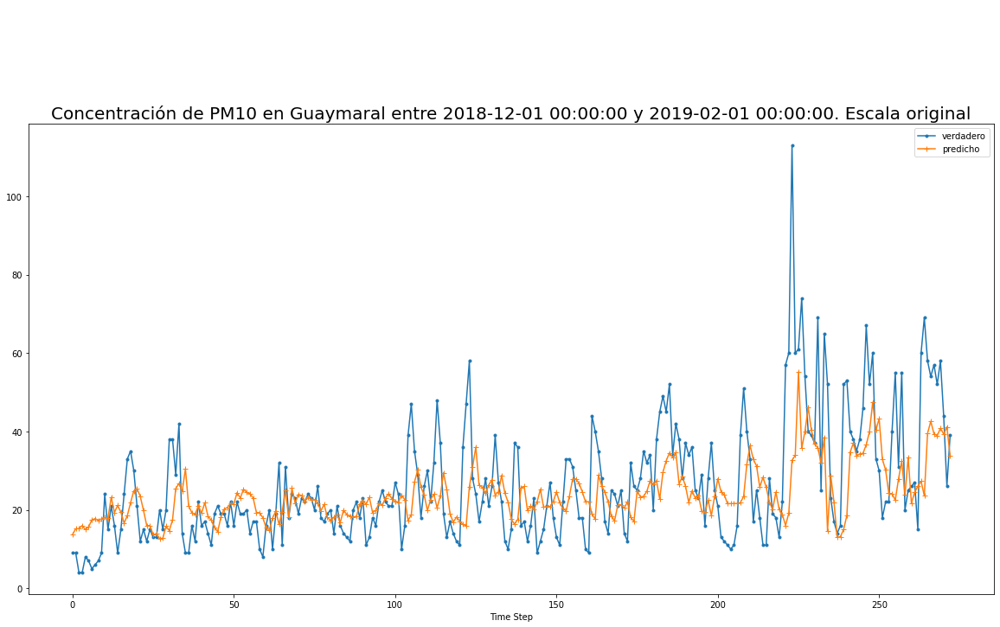

Error cuadratico medio: 13.324714713495293
1417
1417


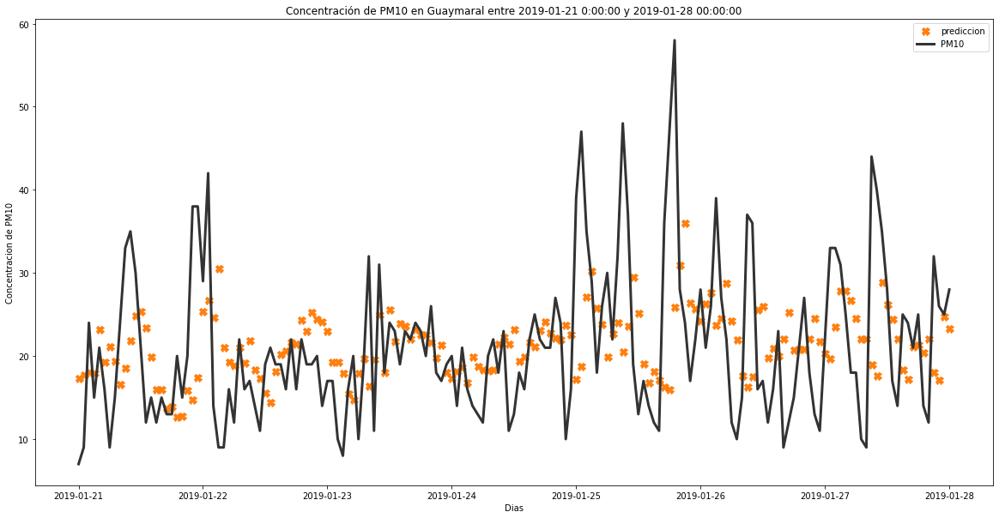

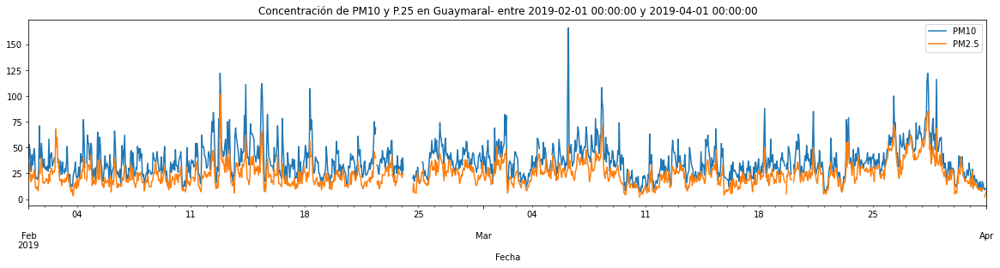

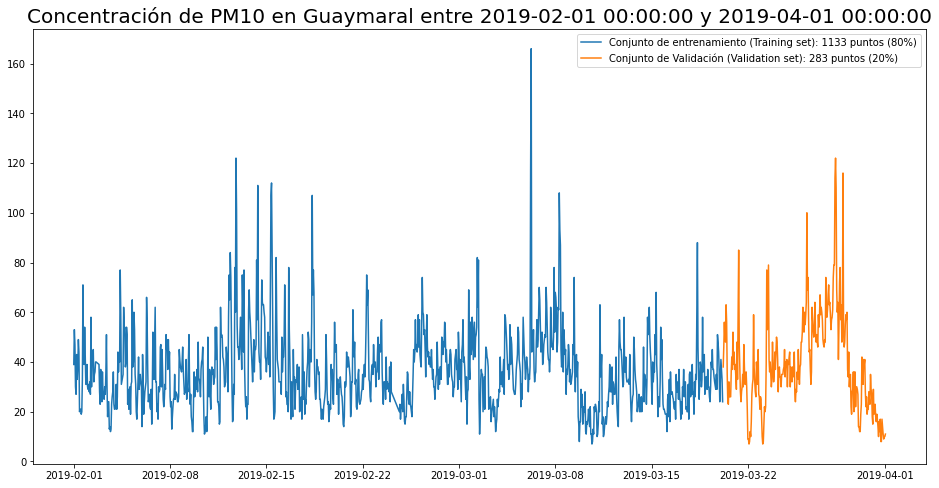

1417 = 1133 + 284
len y_test 259
Model: "sequential_97"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_100 (LSTM)              (None, 24, 200)           161600    
_________________________________________________________________
lstm_101 (LSTM)              (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_97 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
32/32 [==============================] - 4s 36ms/step - loss: 0.0120 - val_loss: 0.0041
Epoch 2/30
32/32 [==============================] - 0s 10ms/step - loss: 0.0105 - val_loss: 0.0044
Epoch 3/30
32/

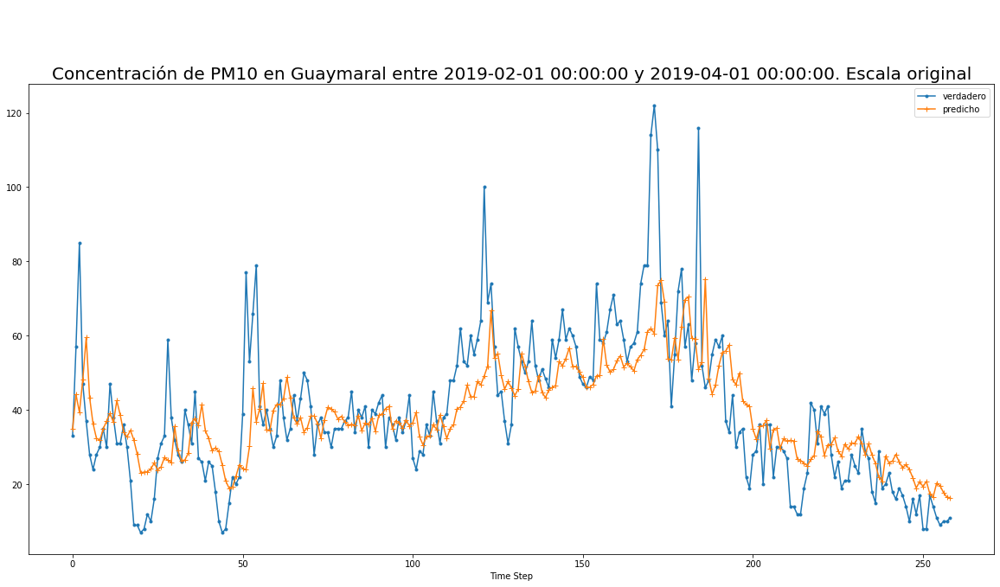

Error cuadratico medio: 13.700172132600105
1465
1465


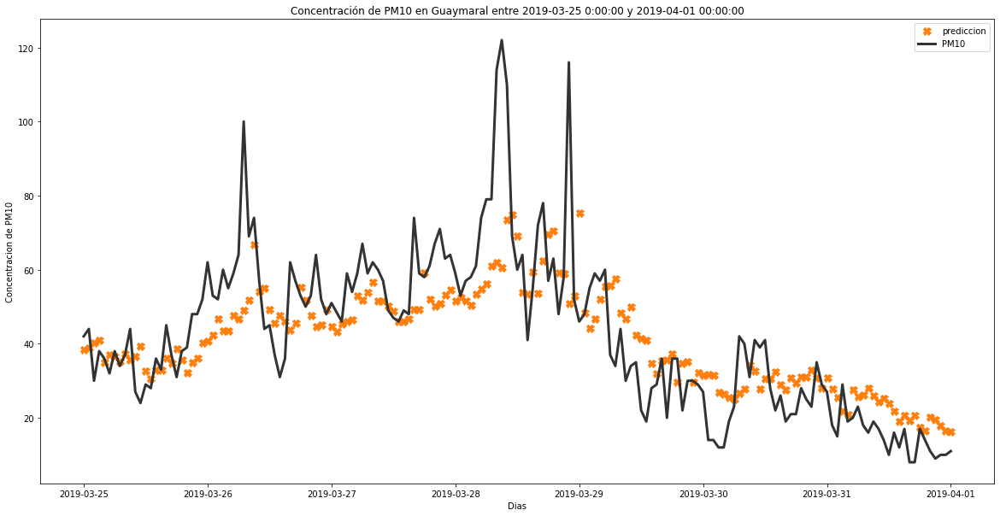

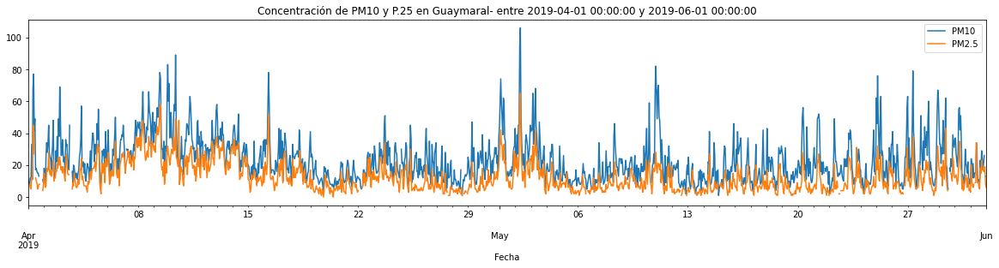

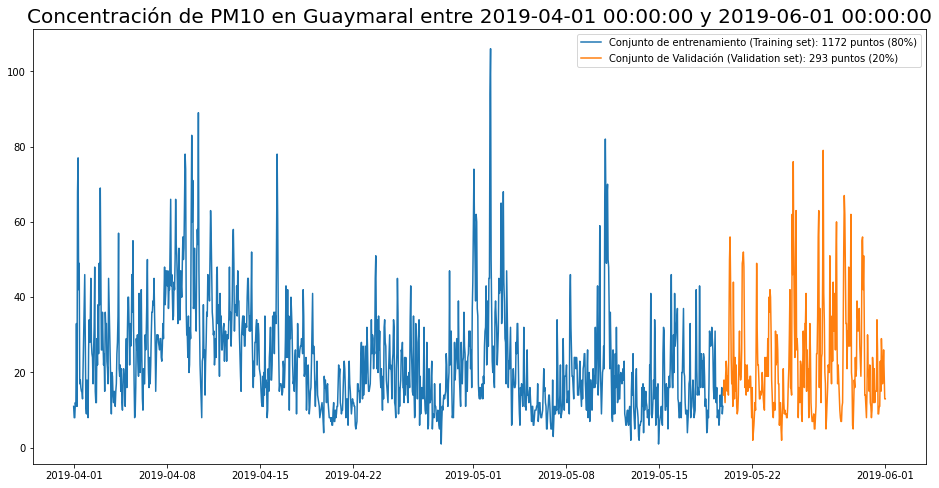

1465 = 1172 + 293
len y_test 268
Model: "sequential_99"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_102 (LSTM)              (None, 24, 200)           161600    
_________________________________________________________________
lstm_103 (LSTM)              (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_99 (Dense)             (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 37ms/step - loss: 0.0162 - val_loss: 0.0088
Epoch 2/30
33/33 [==============================] - 0s 9ms/step - loss: 0.0147 - val_loss: 0.0083
Epoch 3/30
33/3

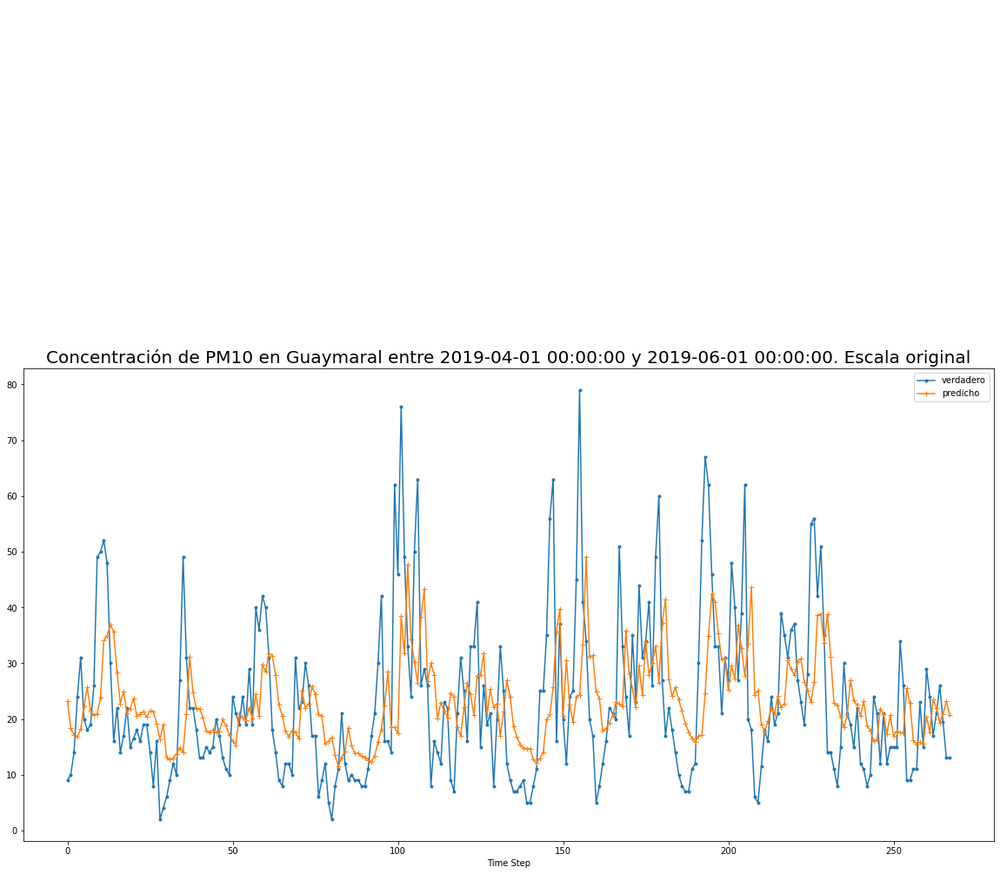

Error cuadratico medio: 13.37267881059032
1465
1465


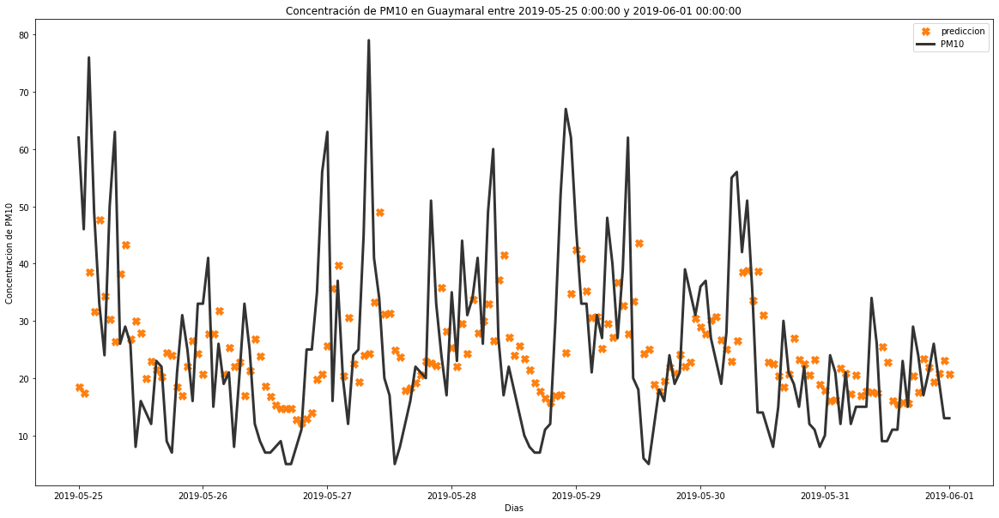

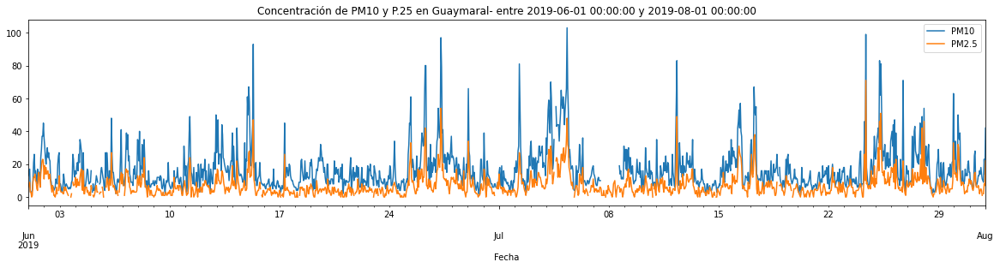

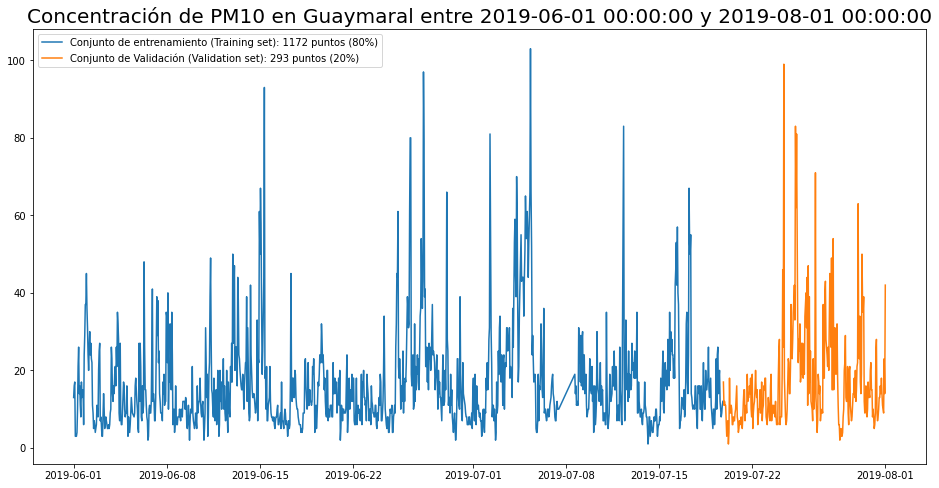

1465 = 1172 + 293
len y_test 268
Model: "sequential_101"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_104 (LSTM)              (None, 24, 200)           161600    
_________________________________________________________________
lstm_105 (LSTM)              (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_101 (Dense)            (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 34ms/step - loss: 0.0143 - val_loss: 0.0142
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0127 - val_loss: 0.0132
Epoch 3/30
33

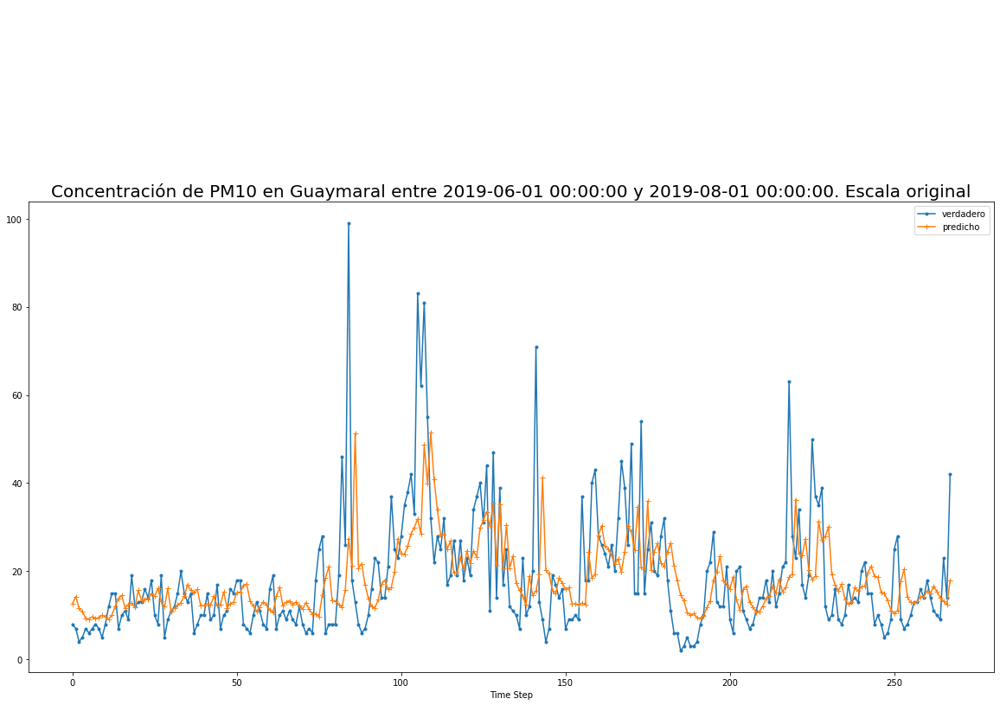

Error cuadratico medio: 12.060958079554135
1465
1465


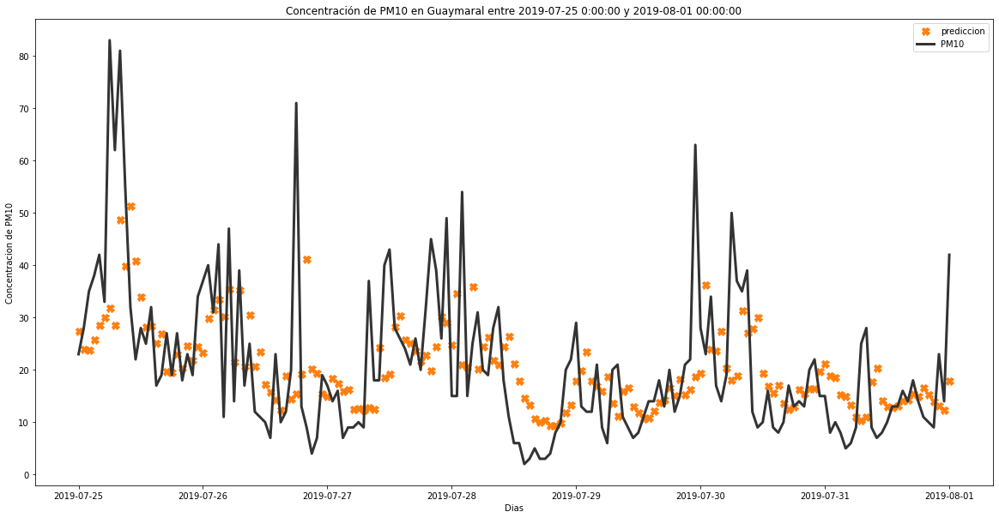

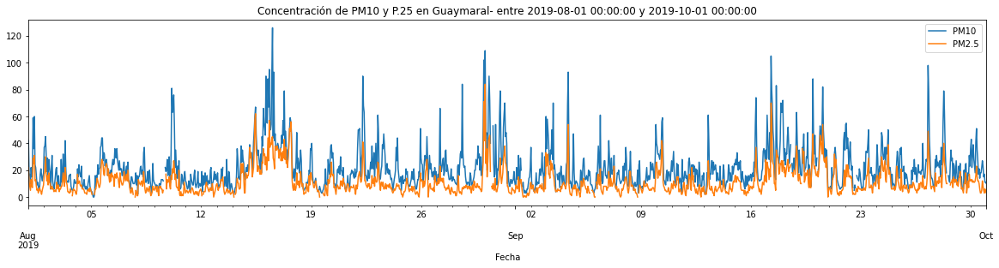

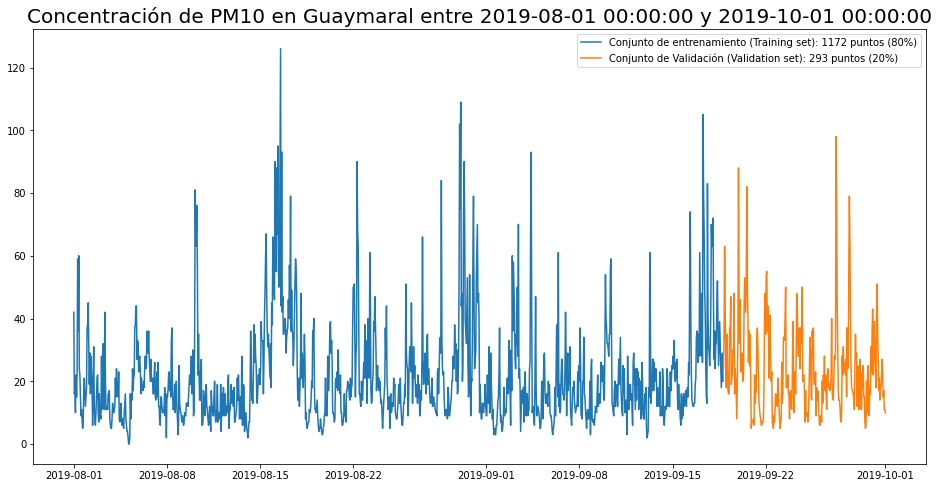

1465 = 1172 + 293
len y_test 268
Model: "sequential_103"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_106 (LSTM)              (None, 24, 200)           161600    
_________________________________________________________________
lstm_107 (LSTM)              (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_103 (Dense)            (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 35ms/step - loss: 0.0168 - val_loss: 0.0180
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0127 - val_loss: 0.0179
Epoch 3/30
33

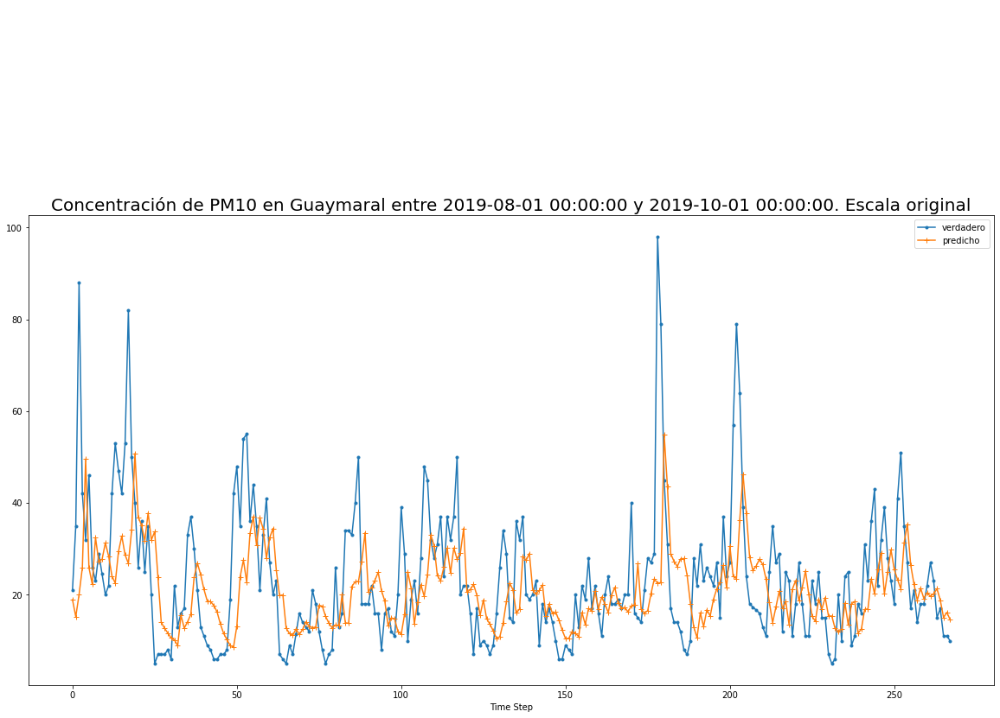

Error cuadratico medio: 14.224819109053133
1465
1465


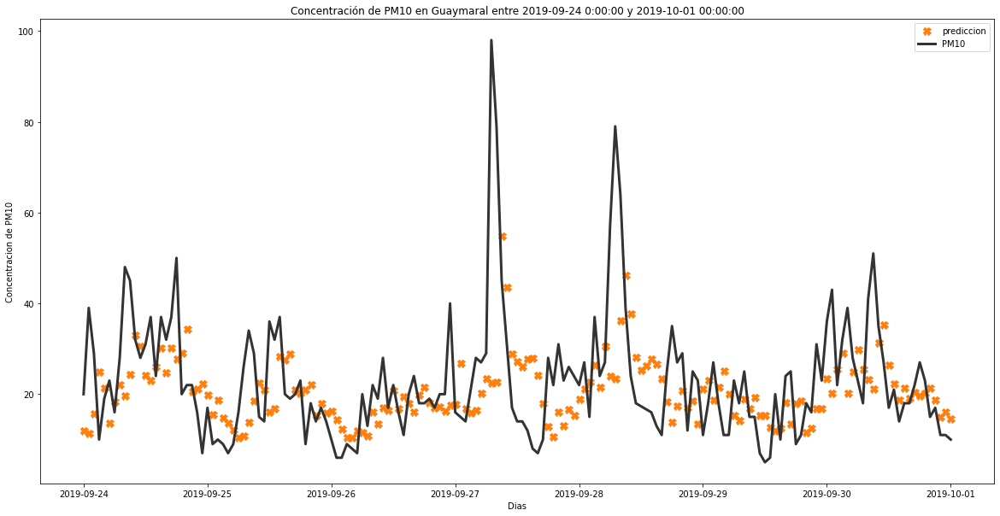

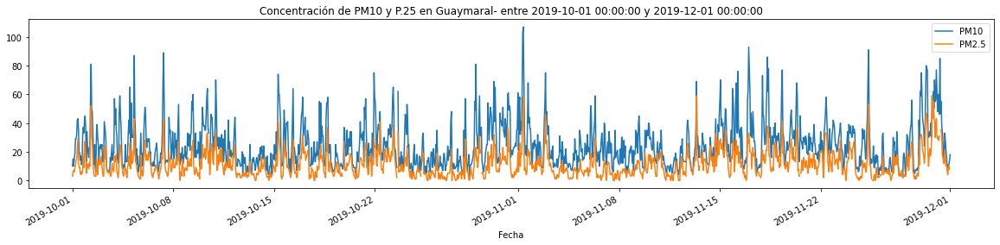

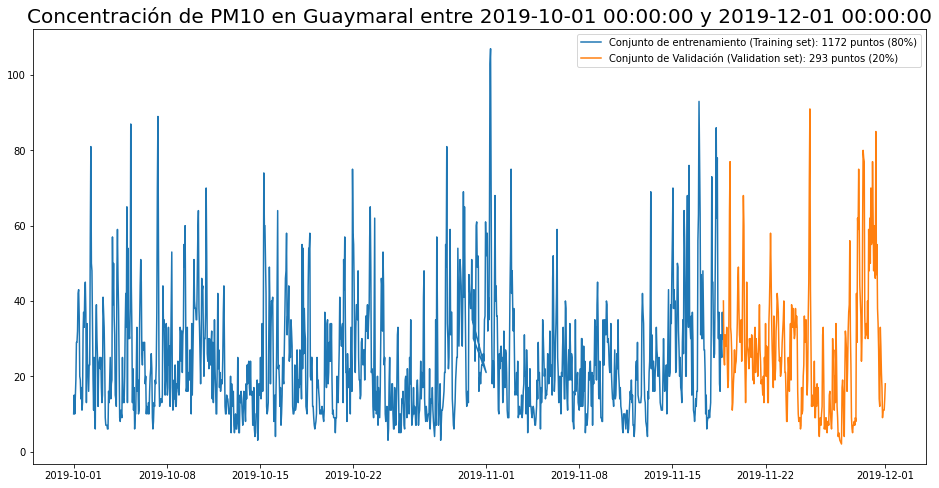

1465 = 1172 + 293
len y_test 268
Model: "sequential_105"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_108 (LSTM)              (None, 24, 200)           161600    
_________________________________________________________________
lstm_109 (LSTM)              (None, 200)               320800    
_________________________________________________________________
Dropout_01 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_105 (Dense)            (None, 1)                 201       
Total params: 482,601
Trainable params: 482,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/30
33/33 [==============================] - 4s 35ms/step - loss: 0.0221 - val_loss: 0.0389
Epoch 2/30
33/33 [==============================] - 0s 10ms/step - loss: 0.0190 - val_loss: 0.0393
Epoch 3/30
33

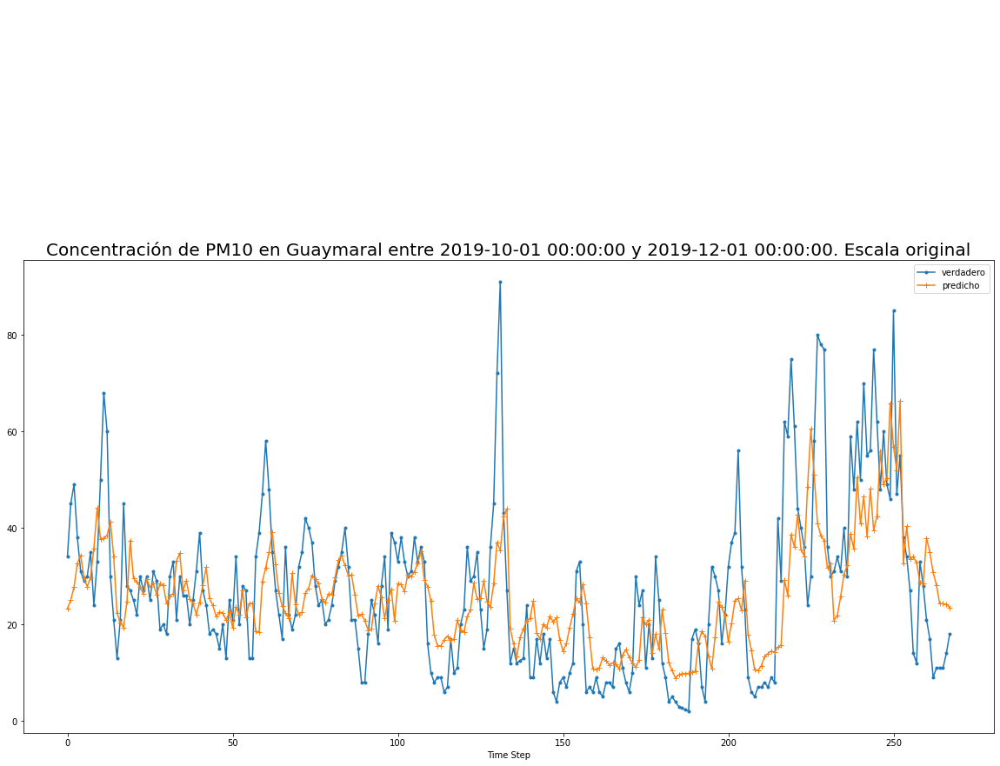

Error cuadratico medio: 12.735014130261296


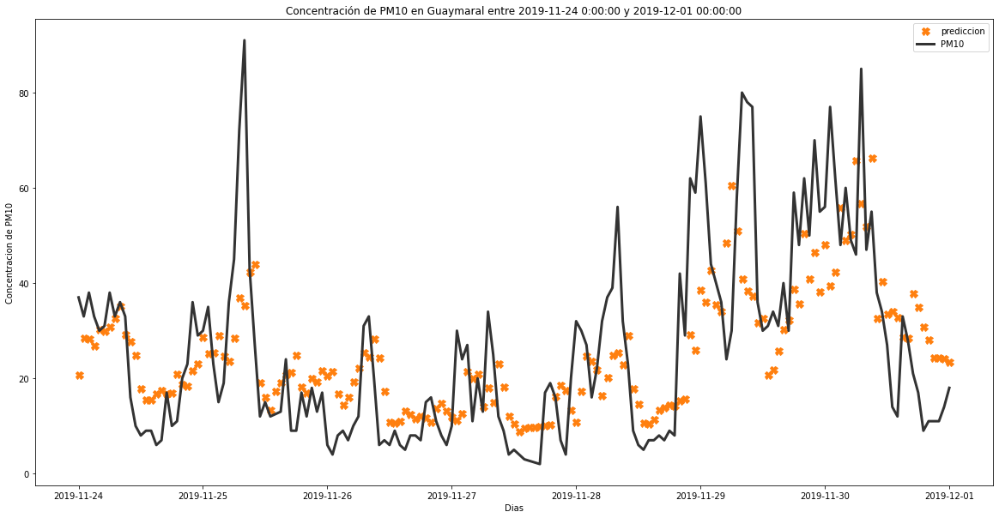

In [ ]:
Lista_Estaciones=["Carvajal-Sevillana","Centro de Alto Rendimiento","Fontibón", "Guaymaral"]
Particulas=["PM2.5","PM10"]
Pnumeros=["2.5","10"]
e=0
for j in Particulas:
    for k in Lista_Estaciones:
        Graficas_estaciones(k,j,Pnumeros[e])
    e=e+1  

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive
